# Important!!!! For the ET paper: the data will need to be re-run starting the outlier detection (long-events) + EEG trigger files!!!

In [10]:
%reset

Once deleted, variables cannot be recovered. Proceed (y/[n])?  y


In [2]:
import warnings  # hide warnings
import pandas as pd  # operate with dataframes
import matplotlib.pyplot as plt  # mother of plots focr Python
import numpy as np  # array/matrix operations (e.g. linear algebra)
import seaborn as sns  # matplotlib plotting nice with shortcuts
from scipy.stats import ks_2samp
from scipy.stats import ttest_rel
from statsmodels.stats.multitest import multipletests
from statsmodels.stats.anova import AnovaRM
from matplotlib.lines import Line2D
import scipy.io  # to load Matlab data
# import pingouin as pg
import math
from  matplotlib.patches import Arc
import matplotlib.patheffects as pe


from scipy.interpolate import interp1d
# from shapely.geometry import Polygon
from matplotlib.patches import ConnectionPatch
from tqdm.notebook import tqdm, trange  # mother of progressbars
from itertools import groupby

In [3]:
warnings.simplefilter(action="ignore", category=FutureWarning)

# raw and processed data paths
PATH_PROC = "./data/village/processed"
#PATH_FOREYE = "./data/village/processed/MAD_sacc"
PATH_FOREYE = "./data/village/processed/MAD_sacc_newfile" # new path, potentially change
PATH_EEG = "./data/village/processed/EEG"


def pbar_fork_hack():
    """
    Hack to enforce progress bars to be displayed by fork processes on
    IPython Apps like Jupyter Notebooks.

    Avoids [IPKernelApp] WARNING | WARNING: attempted to send message from fork

    Important: pass this function as argument for the initializer parameter
    while initializing a multiprocessing pool to make it work. E.g.:

    pool = Pool(processes=N_CORES, initializer=pbar_fork_hack)

    Source:
     - https://github.com/ipython/ipython/issues/11049#issue-306086846
     - https://github.com/tqdm/tqdm/issues/485#issuecomment-473338308
    """
    print(" ", end="", flush=True)

In [4]:
recordings = pd.read_csv("./recordings_village_corr.csv", index_col=0)
# only keep the subjects we will include in the paper!
subj_to_inlcude = [
    1,
    2,
    5,
    12,
    15,
    16,
    17,
    19,
    20,
    21,
    22,
    27,
    29,
    32,
    33,
    34,
    37,
    38,
]
recordings["files"] = [
    int(f[:2]) if int(f[:2]) in subj_to_inlcude else 0
    for f in recordings["file"]
]
recordings = recordings[recordings["files"] > 0]
recordings = recordings.drop("files", axis=1)

recordings

,file,created,length,start,old_id
70656182-09b3-4c19-9ae2-0a2ab2e19fed,01_v_280521.xdf,2021-05-28 20:14:00,"31' 27""",4761.445348,70656182-09b3-4c19-9ae2-0a2ab2e19fed
d764851f-717d-4944-9023-74dda394f96e,02_v_010621.xdf,2021-06-01 11:47:00,"42' 21""",319962.973527,d764851f-717d-4944-9023-74dda394f96e
20e8d35c-e7aa-4be3-a6e2-5b78f4cd44d8,05_v_080621.xdf,2021-06-08 11:45:00,"41' 2""",924682.597076,"(0xb836e8c6, 0xaa6f201c)"
d4bf073c-a3cc-450c-9412-ef15538ee293,12_v_290621.xdf,2021-06-29 15:18:00,"31' 48""",6303.508560,"(0x2dad4bed, 0x30948ad0)"
caf93a54-5b95-4c55-ace9-619a0ca2dd98,15_v_090721.xdf,2021-07-09 15:40:00,"50' 54""",6993.646625,caf93a54-5b95-4c55-ace9-619a0ca2dd98
e28fbd3e-516f-4c89-bc54-3cb32ddd5ef7,16_v_120721.xdf,2021-07-12 15:13:00,"31' 46""",264622.864916,e28fbd3e-516f-4c89-bc54-3cb32ddd5ef7
fdc06350-e1bb-4630-9d23-6631bb0a9498,17_v_130721.xdf,2021-07-13 11:45:00,"31' 41""",338536.963256,fdc06350-e1bb-4630-9d23-6631bb0a9498
61c0f1aa-b3ef-497b-8b6e-8ec6f05f6c42,19_v_150721.xdf,2021-07-15 11:51:00,"38' 55""",511736.967349,"(0xedc71ced, 0xbd780520)"
391543f6-7ff0-4ed3-aefd-c0ef68ebbbf3,20_v_160721.xdf,2021-07-16 12:00:00,"32' 36""",598630.521269,391543f6-7ff0-4ed3-aefd-c0ef68ebbbf3
95184b7a-42f1-40b0-ae36-be6ef1e33f1d,21_v_190721.xdf,2021-07-19 11:49:00,"40' 4""",857189.310134,95184b7a-42f1-40b0-ae36-be6ef1e33f1d


In [4]:
# blue
gaze_color_1 = "#066da8"#"#0570b0"
gaze_color_2 = "#77aacf"#"#74a9cf" #d 
gaze_color_3 = "#bfcae0"#"#bdc9e1" #d

# red
sacc_color_1 = "#e31a1c" #d
sacc_color_2 = "#fd8d3c" #d
sacc_color_3 = "#fecc5c" #d

# green
vel_eye_color = "#238443" #d
vel_head_color = "#d8b365" #"#c2e699"

# grey/other 525252
ten_thres_color = "#525252"
dd_thres_color = "#a4a1a4" #"#bdbdbd"
colliders_color = "#987284"

# Experiment Setup

Text(-0.07, 1.05, 'C')

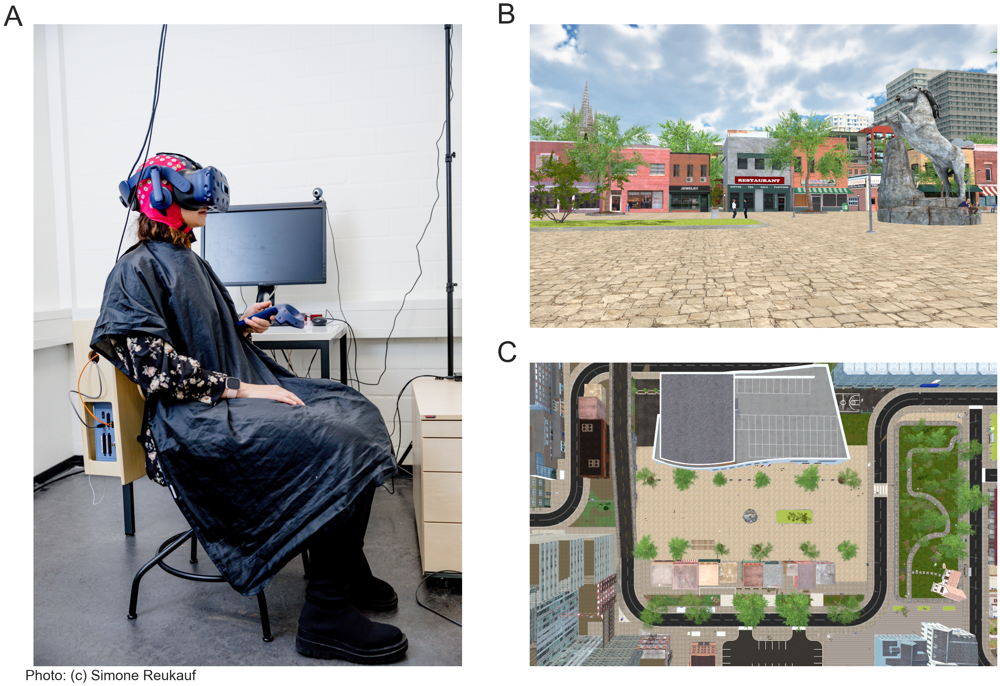

In [5]:
######## APA Style!!! ########

fname = "Arial" # font name
numbersize = 60 #A, B etc.

plt.figure(figsize=(30, 20), constrained_layout=True)

sns.set_style("white") 
ax1 = plt.subplot2grid(shape=(2, 4), loc=(0, 0), rowspan=2, colspan=2)
ax2 = plt.subplot2grid(shape=(2, 4), loc=(0, 2), rowspan=1, colspan=2)
ax3 = plt.subplot2grid(shape=(2, 4), loc=(1, 2), rowspan=1, colspan=2)

img = plt.imread("./images/IMG_4552.jpg")
ax1.imshow(img)
ax1.axis('off')
#ax1.text(0, -10, 'Photo: (c) Simone Reukauf')
ax1.text(0.18, -0.015, 'Photo: (c) Simone Reukauf',fontsize=30, horizontalalignment='center', verticalalignment='center', transform=ax1.transAxes, fontname=fname)

ax1.set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.02, pad=-30, fontname=fname) 

img = plt.imread("./images/unity2.png")
ax2.imshow(img)
ax2.axis('off')
ax2.set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 

img = plt.imread("./images/birds-eye-view.png")
ax3.imshow(img) #,origin='lower', extent=[-1.5, 1.5, -1, 1])
ax3.axis('off')
ax3.set_title("C", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 


Text(-0.07, 1.05, 'C')

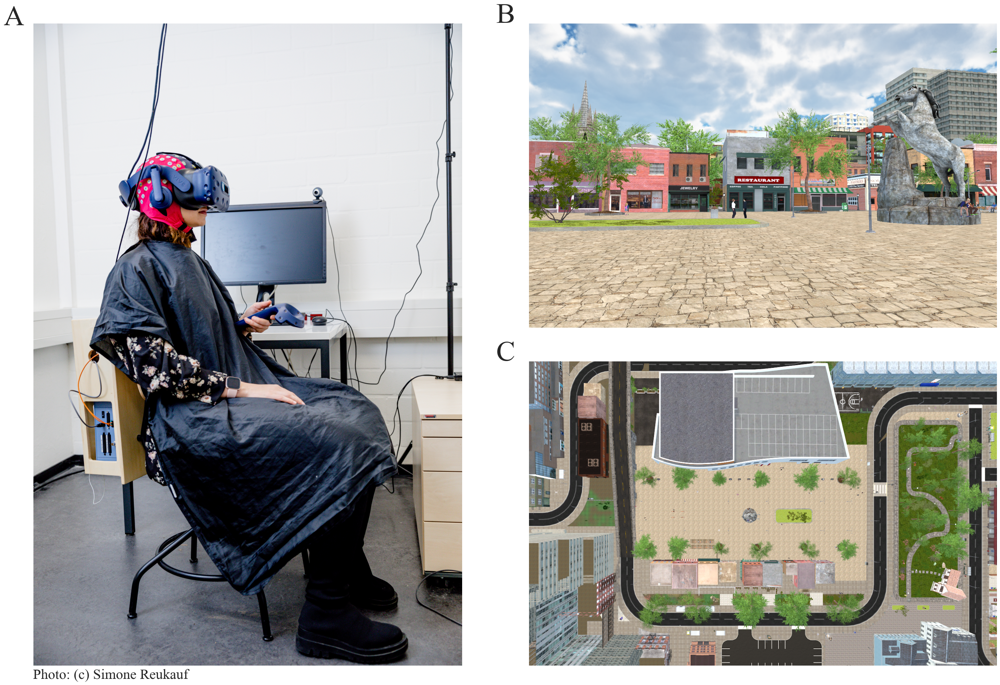

In [9]:
fname = "Times New Roman" # font name
numbersize = 60 #A, B etc.

plt.figure(figsize=(30, 20), constrained_layout=True)

sns.set_style("white") 
ax1 = plt.subplot2grid(shape=(2, 4), loc=(0, 0), rowspan=2, colspan=2)
ax2 = plt.subplot2grid(shape=(2, 4), loc=(0, 2), rowspan=1, colspan=2)
ax3 = plt.subplot2grid(shape=(2, 4), loc=(1, 2), rowspan=1, colspan=2)

img = plt.imread("./images/IMG_4552.jpg")
ax1.imshow(img)
ax1.axis('off')
#ax1.text(0, -10, 'Photo: (c) Simone Reukauf')
ax1.text(0.18, -0.015, 'Photo: (c) Simone Reukauf',fontsize=30, horizontalalignment='center', verticalalignment='center', transform=ax1.transAxes, fontname=fname)

ax1.set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.02, pad=-30, fontname=fname) 

img = plt.imread("./images/unity2.png")
ax2.imshow(img)
ax2.axis('off')
ax2.set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 

img = plt.imread("./images/birds-eye-view.png")
ax3.imshow(img) #,origin='lower', extent=[-1.5, 1.5, -1, 1])
ax3.axis('off')
ax3.set_title("C", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 


# Check % of data interpolated

In [17]:
# progress bar customized format
B_FORMAT = """📄 {n_fmt} of {total_fmt} {desc} processed: {bar} 
            {percentage:3.0f}% ⏱️{elapsed} ⏳{remaining} ⚙️{rate_fmt}{postfix}"""

In [76]:
interpolation = {}

ids = recordings.index.tolist()
idd = ids[:]
for uid in idd:
    print(uid)
    interpolation[uid] = {}
    
    # replacement for nans
    nanrep = np.nan

    # to determin the area around the blinks
    min_blink_duration = 0.02
    dilate_nan = 0.023  # add it as two samples before and after blink onset

    # get the cooridnates
    hit_sort = pd.read_csv(f"{PATH_PROC}/Behavior_new_{uid}.csv", index_col=0)
    hit_pos = pd.read_csv(f"{PATH_PROC}/HitsSorted_new_{uid}.csv", index_col=0)

    # delete identical rows:
    hit_sort = hit_sort[~hit_sort.index.duplicated(keep="first")]
    hit_pos = hit_pos[~hit_pos.index.duplicated(keep="first")]

    # to check for wrong samples:
    x_origin = hit_sort["ETWoriginX"].tolist()

    x_coord = hit_sort["ETWdirectionX"].tolist()
    hpoo_x = hit_pos["HPOOX"].tolist()

    # and get the timestamps
    times = hit_sort.index.tolist()
    times_hpoo = hit_pos.index.tolist()

    # get valid data
    val = hit_sort["valid"].tolist()  # original valid stream
    
    # adjust valid: if both eyes are closed: change to 0.0 in valid
    no_valids_corr_df = hit_sort[
        (hit_sort.leftBlink == 1.000)
        & (hit_sort.rightBlink == 1.000)
        & (hit_sort.valid == 1.000)
    ]
    no_val = [
        0.0 if t in no_valids_corr_df.index else 1.0 for t in times
    ]  # get a list out of df

    # adjust valid: if the position is too far away: change to -2.0 in valid
    no_valids_corr_df = hit_sort[
        (hit_sort.ETWoriginX < 400.0) & (hit_sort.valid == 1.000)
    ]
    no_val1 = [
        0.0 if t in no_valids_corr_df.index else 1.0 for t in times
    ]  # get a list out of df
    valid = [
        0.0
        if (no_val[v] == 0.0) or (no_val1[v] == 0.0) or (val[v] == 0.0)
        else 1.0
        for v in range(len(val))
    ]  # add it t
    
    interpolation[uid]['inval_before_blinks'] = (len(valid) - sum(valid))/len(valid)*100

    
    # to check how many close samples there were
    cnt = False
    cnt_item = 0.0

    # to get the blink onset
    blinking = False  # will be true during the blinking
    blink_time = 0.0  # will be updated to blink onset
    blinks = [0.0] * len(times)
    
    # go through the entire list of timestamps
    for t, item in enumerate(times):
        # if this is not part of the hpoo:
        if not item in times_hpoo:
            hpoo_x.insert(t, nanrep)
            times_hpoo.insert(t, item)
            
        # to check for blinks: get blink onset
        if (valid[t] != 1.0) and not blinking:
            blinking = True
            # get the time of blinking onset
            blink_time = item
        # if they are over, do:
        elif valid[t] == 1.0 and blinking:
            # reset the blinking parameter
            blinking = False
            # get the end of the blink (so the previous time stamp)
            it = times[t - 1]
            # if the blink duration is bigger than the min blink duration:
            # adapt the blink duration plus the dialate_nan
            if it - blink_time >= min_blink_duration:
                # we want to exchange all the items with nan, so get the time interval we need to change it in:
                ts = times[
                    times.index(
                        list(
                            filter(
                                lambda i: i >= (blink_time - dilate_nan), times
                            )
                        )[0]
                    ) : times.index(
                        list(filter(lambda i: i <= (it + dilate_nan), times))[
                            -1
                        ]
                    )
                    + 1
                ]  # get all timestamps in the important time window
                for t_s in ts:
                    # if this is not part of the hpoo (as we add two elements after the current one):
                    if not t_s in times_hpoo:
                        hpoo_x.insert(times.index(t_s), nanrep)
                        times_hpoo.insert(times.index(t_s), item)

                    # ETW
                    x_coord[times.index(t_s)] = nanrep
                    hpoo_x[times.index(t_s)] = nanrep
                
                    # add the number to blinks
                    blinks[times.index(t_s)] = nanrep
            # if the blink duration is too small, we do not add an additional window around it
            else:
                ts = times[
                    times.index(
                        list(filter(lambda i: i >= (blink_time), times))[0]
                    ) : times.index(
                        list(filter(lambda i: i <= (it), times))[-1]
                    )
                    + 1
                ]  # get all timestamps in the important time window
                for t_s in ts:
                    # ETW
                    x_coord[times.index(t_s)] = nanrep
        
                    # hpoo
                    hpoo_x[times.index(t_s)] = nanrep
                    
    # go through the other list and delete all elmenets that are not in time
    # so all the elements that we cannot add the the .csv like this
    to_del = list(set(times_hpoo) - set(times))
    for i in to_del:
        hpoo_x.pop(times_hpoo.index(i))
        times_hpoo.pop(times_hpoo.index(i))

    # create a df out of all the important lists:
    for_eye = list(
        zip(
            times,
            valid,
            x_coord,
            hpoo_x,
            blinks,
        )
    )
    for_eye = pd.DataFrame(
        for_eye,
        columns=[
            "time",
            "valid",
            "xcoord",
            "xhpoo",
            "blinks",
        ],
    )
    for_eye.set_index("time")

    v_nan = for_eye[~for_eye["xcoord"].isnull()] 
    interpolation[uid]['inval_after_blinks'] = (len(for_eye) - len(v_nan))/len(for_eye)*100
    
    # interpolate
    for column_name in for_eye:
        # do not interpolate these columns
        if column_name not in [
            "time",
            "valid",
        ]:
            
            b = for_eye[column_name].values.tolist()
            # get number of nan
            v = [
                len(list(group))
                for key, group in groupby(b, key=pd.isnull)
                if key
            ]


            # get corresponding time for each group in v
            idx = [
                idx + 1
                for idx in range(len(b) - 1)
                if not pd.isnull(b[idx]) and pd.isnull(b[idx + 1])
            ]
            if pd.isnull(b[0]):
                idx.insert(
                    0, 0
                )  # if the first element is nan, it will be added here

            # interpolate data
            for_eye[column_name] = for_eye[column_name].interpolate(
                method="linear", limit_direction="both"
            )
            # go through v: if the beginning and end difference is bigger than allowed, replace interpolated data with nan
            b = for_eye[column_name].values.tolist()
            b = np.array(
                b
            )  # for the filling in an array is needed instead of a list
            for t, item in enumerate(idx):
                # finish for the last timestamp
                if item + v[t] == len(times):
                    break
                # if the distance is bigger then 250ms we do not want to interpolate --> replace values with nan
                if times[item + v[t]] - times[item] > 0.25:
                    b[item : item + v[t]] = np.nan * len(b[item : item + v[t]])

            # replace the column with interpolated one
            for_eye[column_name] = b.tolist()

            b_nan = for_eye[~for_eye[column_name].isnull()] 

    b_nan = for_eye[~for_eye["xcoord"].isnull()] 
    interpolation[uid]['not_interpolated'] = (len(for_eye) - len(b_nan))/len(b)*100
    interpolation[uid]['interpolated'] = ((len(for_eye) - len(v_nan)) - (len(for_eye) - len(b_nan)))/len(for_eye)*100

interpolation = pd.DataFrame(interpolation).transpose()    
display(interpolation)
print()
print(f"Median Amount of Interpolation: {np.nanmedian(interpolation['interpolated'])}")

# Interquartile range:
q75, q25 = np.nanpercentile(interpolation['interpolated'].tolist(), [75, 25])
iqr_interp = q75 - q25
print(f"IQR gaze DD: {iqr_interp} ({q25}-{q75})")

70656182-09b3-4c19-9ae2-0a2ab2e19fed
d764851f-717d-4944-9023-74dda394f96e
20e8d35c-e7aa-4be3-a6e2-5b78f4cd44d8
d4bf073c-a3cc-450c-9412-ef15538ee293
caf93a54-5b95-4c55-ace9-619a0ca2dd98
e28fbd3e-516f-4c89-bc54-3cb32ddd5ef7
fdc06350-e1bb-4630-9d23-6631bb0a9498
61c0f1aa-b3ef-497b-8b6e-8ec6f05f6c42
391543f6-7ff0-4ed3-aefd-c0ef68ebbbf3
95184b7a-42f1-40b0-ae36-be6ef1e33f1d
c6c110c9-2efe-44e7-914f-d6052e2ab784
c4400578-a590-4cf5-abc2-0f634fb4443c
c4cb86a2-c2d6-40f0-b594-9bb3eb769189
097837f9-9a11-41f4-9c23-03987ba3ed9a
623664e8-1ceb-48e0-abd0-46d447285980
f25b9349-573e-4c97-974e-855d4b037c79
817cb93e-061d-4ea6-a13d-31226246ff34
6f6719eb-8c89-46fe-8b5e-3c81e0e40a84


,inval_before_blinks,inval_after_blinks,not_interpolated,interpolated
70656182-09b3-4c19-9ae2-0a2ab2e19fed,2.539792,3.248241,0.860392,2.387850
d764851f-717d-4944-9023-74dda394f96e,3.420271,4.653802,0.488873,4.164929
20e8d35c-e7aa-4be3-a6e2-5b78f4cd44d8,4.640298,5.882389,2.079794,3.802595
d4bf073c-a3cc-450c-9412-ef15538ee293,1.313385,1.729107,0.314550,1.414556
caf93a54-5b95-4c55-ace9-619a0ca2dd98,2.889166,3.606700,0.915793,2.690908
e28fbd3e-516f-4c89-bc54-3cb32ddd5ef7,6.275484,7.729350,2.714620,5.014729
fdc06350-e1bb-4630-9d23-6631bb0a9498,4.418777,5.712438,0.659767,5.052670
61c0f1aa-b3ef-497b-8b6e-8ec6f05f6c42,7.471597,8.680346,5.011632,3.668714
391543f6-7ff0-4ed3-aefd-c0ef68ebbbf3,3.695231,4.320020,3.102420,1.217600
95184b7a-42f1-40b0-ae36-be6ef1e33f1d,2.918553,3.708207,0.885181,2.823026



Median Amount of Interpolation: 2.756966809293271
IQR gaze DD: 2.3225367713293603 (1.778862828749975-4.101399600079335)


# Schematic of translational movement

/tmp/ipykernel_872408/841201746.py:103: RuntimeWarning: divide by zero encountered in scalar divide
  slope1 = (l1xy[1][1] - l1xy[0][1]) / float(l1xy[1][0] - l1xy[0][0])
/tmp/ipykernel_872408/841201746.py:116: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  angle_plot = Arc(origin, len_x_axis*offset, len_y_axis*offset, 0, theta1, theta2, color=sacc_color_2, zorder=0.5,


Text(-0.1, 1.05, 'B')

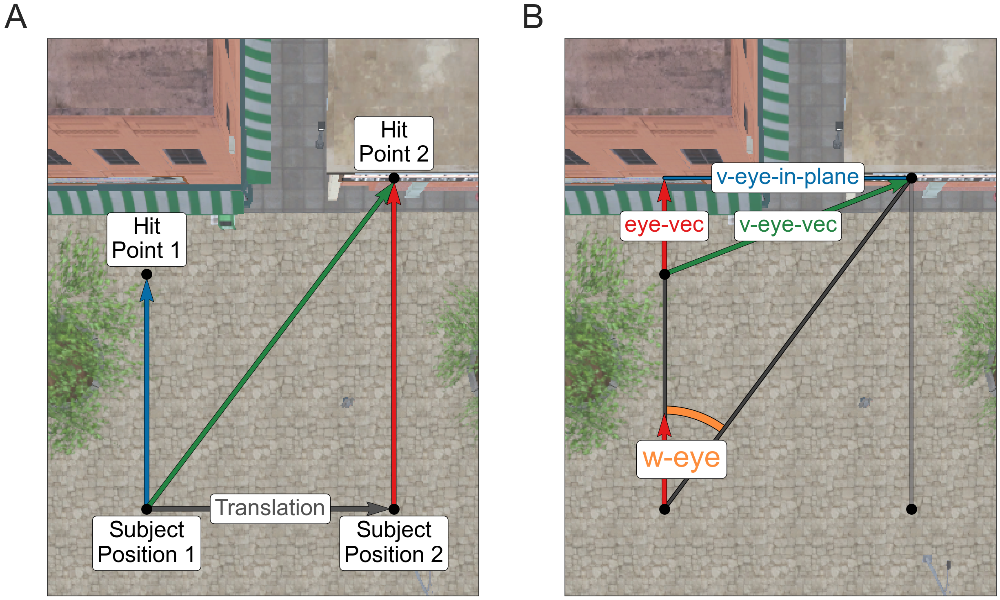

In [6]:
######## APA Style!!! ########

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Arial" # font name
labelsize = 40 #text
linewidth = 5

sns.set(rc={"figure.figsize": (30, 30)})
#plt.figure(figsize=(30, 32), constrained_layout=True)


sns.set_style("white")
f, (ax1,ax2) = plt.subplots(1,2)
img = plt.imread("images/S1.png")

######## positions ########
sub_1_x = 80
sub_2_x = 280
sub_y = 380
sub_1_y = 190
sub_2_y = 112

######## pannel 1 ########
ax1.imshow(img, alpha = 0.85)

#points
ax1.scatter([sub_1_x,sub_2_x,sub_1_x,sub_2_x], [sub_y,sub_y,sub_1_y,sub_2_y], marker='o', facecolors='black', 
            zorder=3, linewidth = 2, edgecolors='black', s=300)
# arrows 
V = np.array([[0,0.535], [0,0.76], [0.575,0.76], [0.565,0]]) # direction of 
origin = np.array([[sub_1_x, sub_2_x, sub_1_x, sub_1_x],[sub_y, sub_y, sub_y, sub_y]]) # origin points: [all x coords], [all y coords]
ax1.quiver(*origin, V[:,0], V[:,1], color=[gaze_color_1,sacc_color_1,vel_eye_color, ten_thres_color], 
           scale=1, linewidth = 0.75, edgecolor='black', width=0.011)
# text
ax1.text(sub_1_x, sub_y+28, 'Subject\nPosition 1', horizontalalignment='center', verticalalignment='center', rotation=0, 
         color='black', size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
ax1.text(sub_2_x, sub_y+28, 'Subject\nPosition 2', horizontalalignment='center', verticalalignment='center', rotation=0, 
         color='black', size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
ax1.text(sub_1_x+(sub_2_x-sub_1_x)/2, sub_y, 'Translation', horizontalalignment='center', verticalalignment='center', rotation=0, 
         color=ten_thres_color, size=labelsize, weight="bold", fontname=fname,
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
#ax1.text(sub_1_x, sub_2_y+(sub_y-sub_2_y)/2, 'allocentric\ngaze\ndirection', horizontalalignment='center', 
#         verticalalignment='center', rotation=0, color=gaze_color_1, size=labelsize, 
#         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'), weight="bold", fontname=fname)
#ax1.text(sub_1_x+(sub_2_x-sub_1_x)/2, sub_2_y+(sub_y-sub_2_y)/2, 'allocentric\ngaze\ndirection', horizontalalignment='center', 
#         verticalalignment='center', rotation=0, color=vel_eye_color, 
#         size=labelsize,bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'), weight="bold", fontname=fname)
#ax1.text(sub_2_x, sub_2_y+(sub_y-sub_2_y)/2, 'allocentric\ngaze\ndirection', horizontalalignment='center', 
#         verticalalignment='center', rotation=0, color=sacc_color_1, size=labelsize, 
#         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'), weight="bold", fontname=fname)
ax1.text(sub_1_x, sub_1_y-28, 'Hit\nPoint 1', horizontalalignment='center', verticalalignment='center', rotation=0, 
         color='black', size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
ax1.text(sub_2_x, sub_2_y-28, 'Hit\nPoint 2', horizontalalignment='center', verticalalignment='center', rotation=0,
         color='black', size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))

ax1.set_xticks([])
ax1.set_yticks([])






######## pannel 2 ########
ax2.imshow(img, alpha = 0.85)
#points
ax2.scatter([sub_1_x,sub_2_x,sub_1_x,sub_2_x], [sub_y,sub_y,sub_1_y,sub_2_y], marker='o', facecolors='black', 
            zorder=3, linewidth = 2, edgecolors='black', s=300)
# gaze directions
ax2.plot([sub_2_x,sub_2_x], [sub_y,sub_2_y], linestyle='solid', marker='', color='k', alpha = 0.5, 
         zorder=1, linewidth = linewidth+2.5) # outline 
ax2.plot([sub_2_x,sub_2_x], [sub_y,sub_2_y], linestyle='solid', marker='', color=dd_thres_color, alpha = 0.5, 
         zorder=1, linewidth = linewidth)
ax2.plot([sub_1_x+0.4,sub_1_x+0.4], [sub_y,sub_1_y], linestyle='solid', marker='', color='k', alpha = 1, 
         zorder=1, linewidth = linewidth+2.5) # outline 
line_1 = Line2D([sub_1_x,sub_1_x], [sub_y,sub_1_y], linestyle='solid', marker='', color=ten_thres_color, alpha = 0.8, 
                zorder=1, linewidth = linewidth)
ax2.add_line(line_1)
line_2 = Line2D([sub_1_x,sub_2_x], [sub_y,sub_2_y], linestyle='solid', marker='', color=ten_thres_color, alpha = 0.8, 
                zorder=1, linewidth = linewidth, 
               path_effects=[pe.Stroke(linewidth=linewidth+2.5, foreground='black'), pe.Normal()])
ax2.add_line(line_2)

# arrow
V = np.array([[0,0.222], [0,0.222], [0.575,0.222]]) # direction of 
origin = np.array([[sub_1_x, sub_1_x, sub_1_x],[sub_y, sub_1_y, sub_1_y]]) # origin points: [all x coords], [all y coords]
ax2.quiver(*origin, V[:,0], V[:,1], color=[sacc_color_1,sacc_color_1,vel_eye_color], scale=1, linewidth = 0.75, 
           edgecolor='black', width=0.011)
# v_gaze_inplane
ax2.plot([sub_1_x,sub_2_x], [sub_2_y,sub_2_y], linestyle='solid', marker='', color=gaze_color_1, alpha = 1, zorder=1, 
         linewidth = linewidth, path_effects=[pe.Stroke(linewidth=linewidth+2.5, foreground='black'), pe.Normal()])

# angle
l1xy = line_1.get_xydata()
# Angle between line1 and x-axis
slope1 = (l1xy[1][1] - l1xy[0][1]) / float(l1xy[1][0] - l1xy[0][0])
angle1 = math.degrees(math.atan(slope1)) # Taking only the positive angle
l2xy = line_2.get_xydata()
# Angle between line2 and x-axis
slope2 = (l2xy[1][1] - l2xy[0][1]) / float(l2xy[1][0] - l2xy[0][0])
angle2 = math.degrees(math.atan(slope2))
theta1 = min(angle1, angle2)
theta2 = max(angle1, angle2)
angle = theta2 - theta1
offset = 160
origin = [sub_1_x,sub_y]
len_x_axis = 1
len_y_axis = 1
angle_plot = Arc(origin, len_x_axis*offset, len_y_axis*offset, 0, theta1, theta2, color=sacc_color_2, zorder=0.5, 
                label = str(angle)+u"\u00b0", linewidth = linewidth+8,
                path_effects=[pe.Stroke(linewidth=linewidth+10.5, foreground='black'), pe.Normal()])
ax2.add_patch(angle_plot) # To display the angle arc

# text
ax2.text(sub_1_x, sub_2_y+(sub_1_y-sub_2_y)/2, 'eye-vec', horizontalalignment='center', verticalalignment='center', 
         rotation=0, color=sacc_color_1, size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
ax2.text(sub_1_x+(sub_2_x-sub_1_x)/2, sub_2_y, 'v-eye-in-plane', horizontalalignment='center', verticalalignment='center', 
         rotation=0, color=gaze_color_1, size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
ax2.text(sub_1_x+(sub_2_x-sub_1_x)/2, sub_2_y+(sub_1_y-sub_2_y)/2, 'v-eye-vec', horizontalalignment='center', verticalalignment='center', 
         rotation=0, color=vel_eye_color, size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
ax2.text(sub_1_x+14, sub_y-40, 'w-eye', horizontalalignment='center', verticalalignment='center', 
         rotation=0, color=sacc_color_2, size=labelsize+12, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))

ax2.set_xticks([])
ax2.set_yticks([])

ax1.set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)
ax2.set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)

/tmp/ipykernel_315381/3818806779.py:101: RuntimeWarning: divide by zero encountered in scalar divide
  slope1 = (l1xy[1][1] - l1xy[0][1]) / float(l1xy[1][0] - l1xy[0][0])
/tmp/ipykernel_315381/3818806779.py:114: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  angle_plot = Arc(origin, len_x_axis*offset, len_y_axis*offset, 0, theta1, theta2, color=sacc_color_2, zorder=0.5,


Text(-0.1, 1.05, 'B')

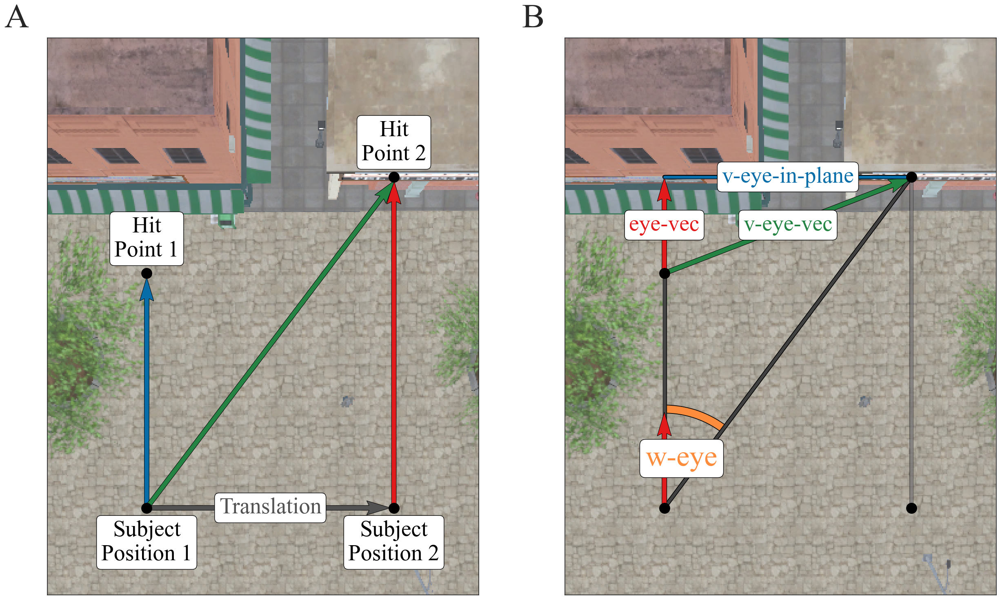

In [260]:
labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Times New Roman" # font name
labelsize = 40 #text
linewidth = 5

sns.set(rc={"figure.figsize": (30, 30)})
#plt.figure(figsize=(30, 32), constrained_layout=True)


sns.set_style("white")
f, (ax1,ax2) = plt.subplots(1,2)
img = plt.imread("images/S1.png")

######## positions ########
sub_1_x = 80
sub_2_x = 280
sub_y = 380
sub_1_y = 190
sub_2_y = 112

######## pannel 1 ########
ax1.imshow(img, alpha = 0.85)

#points
ax1.scatter([sub_1_x,sub_2_x,sub_1_x,sub_2_x], [sub_y,sub_y,sub_1_y,sub_2_y], marker='o', facecolors='black', 
            zorder=3, linewidth = 2, edgecolors='black', s=300)
# arrows 
V = np.array([[0,0.535], [0,0.76], [0.575,0.76], [0.565,0]]) # direction of 
origin = np.array([[sub_1_x, sub_2_x, sub_1_x, sub_1_x],[sub_y, sub_y, sub_y, sub_y]]) # origin points: [all x coords], [all y coords]
ax1.quiver(*origin, V[:,0], V[:,1], color=[gaze_color_1,sacc_color_1,vel_eye_color, ten_thres_color], 
           scale=1, linewidth = 0.75, edgecolor='black', width=0.011)
# text
ax1.text(sub_1_x, sub_y+28, 'Subject\nPosition 1', horizontalalignment='center', verticalalignment='center', rotation=0, 
         color='black', size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
ax1.text(sub_2_x, sub_y+28, 'Subject\nPosition 2', horizontalalignment='center', verticalalignment='center', rotation=0, 
         color='black', size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
ax1.text(sub_1_x+(sub_2_x-sub_1_x)/2, sub_y, 'Translation', horizontalalignment='center', verticalalignment='center', rotation=0, 
         color=ten_thres_color, size=labelsize, weight="bold", fontname=fname,
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
#ax1.text(sub_1_x, sub_2_y+(sub_y-sub_2_y)/2, 'allocentric\ngaze\ndirection', horizontalalignment='center', 
#         verticalalignment='center', rotation=0, color=gaze_color_1, size=labelsize, 
#         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'), weight="bold", fontname=fname)
#ax1.text(sub_1_x+(sub_2_x-sub_1_x)/2, sub_2_y+(sub_y-sub_2_y)/2, 'allocentric\ngaze\ndirection', horizontalalignment='center', 
#         verticalalignment='center', rotation=0, color=vel_eye_color, 
#         size=labelsize,bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'), weight="bold", fontname=fname)
#ax1.text(sub_2_x, sub_2_y+(sub_y-sub_2_y)/2, 'allocentric\ngaze\ndirection', horizontalalignment='center', 
#         verticalalignment='center', rotation=0, color=sacc_color_1, size=labelsize, 
#         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'), weight="bold", fontname=fname)
ax1.text(sub_1_x, sub_1_y-28, 'Hit\nPoint 1', horizontalalignment='center', verticalalignment='center', rotation=0, 
         color='black', size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
ax1.text(sub_2_x, sub_2_y-28, 'Hit\nPoint 2', horizontalalignment='center', verticalalignment='center', rotation=0,
         color='black', size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))

ax1.set_xticks([])
ax1.set_yticks([])






######## pannel 2 ########
ax2.imshow(img, alpha = 0.85)
#points
ax2.scatter([sub_1_x,sub_2_x,sub_1_x,sub_2_x], [sub_y,sub_y,sub_1_y,sub_2_y], marker='o', facecolors='black', 
            zorder=3, linewidth = 2, edgecolors='black', s=300)
# gaze directions
ax2.plot([sub_2_x,sub_2_x], [sub_y,sub_2_y], linestyle='solid', marker='', color='k', alpha = 0.5, 
         zorder=1, linewidth = linewidth+2.5) # outline 
ax2.plot([sub_2_x,sub_2_x], [sub_y,sub_2_y], linestyle='solid', marker='', color=dd_thres_color, alpha = 0.5, 
         zorder=1, linewidth = linewidth)
ax2.plot([sub_1_x+0.4,sub_1_x+0.4], [sub_y,sub_1_y], linestyle='solid', marker='', color='k', alpha = 1, 
         zorder=1, linewidth = linewidth+2.5) # outline 
line_1 = Line2D([sub_1_x,sub_1_x], [sub_y,sub_1_y], linestyle='solid', marker='', color=ten_thres_color, alpha = 0.8, 
                zorder=1, linewidth = linewidth)
ax2.add_line(line_1)
line_2 = Line2D([sub_1_x,sub_2_x], [sub_y,sub_2_y], linestyle='solid', marker='', color=ten_thres_color, alpha = 0.8, 
                zorder=1, linewidth = linewidth, 
               path_effects=[pe.Stroke(linewidth=linewidth+2.5, foreground='black'), pe.Normal()])
ax2.add_line(line_2)

# arrow
V = np.array([[0,0.222], [0,0.222], [0.575,0.222]]) # direction of 
origin = np.array([[sub_1_x, sub_1_x, sub_1_x],[sub_y, sub_1_y, sub_1_y]]) # origin points: [all x coords], [all y coords]
ax2.quiver(*origin, V[:,0], V[:,1], color=[sacc_color_1,sacc_color_1,vel_eye_color], scale=1, linewidth = 0.75, 
           edgecolor='black', width=0.011)
# v_gaze_inplane
ax2.plot([sub_1_x,sub_2_x], [sub_2_y,sub_2_y], linestyle='solid', marker='', color=gaze_color_1, alpha = 1, zorder=1, 
         linewidth = linewidth, path_effects=[pe.Stroke(linewidth=linewidth+2.5, foreground='black'), pe.Normal()])

# angle
l1xy = line_1.get_xydata()
# Angle between line1 and x-axis
slope1 = (l1xy[1][1] - l1xy[0][1]) / float(l1xy[1][0] - l1xy[0][0])
angle1 = math.degrees(math.atan(slope1)) # Taking only the positive angle
l2xy = line_2.get_xydata()
# Angle between line2 and x-axis
slope2 = (l2xy[1][1] - l2xy[0][1]) / float(l2xy[1][0] - l2xy[0][0])
angle2 = math.degrees(math.atan(slope2))
theta1 = min(angle1, angle2)
theta2 = max(angle1, angle2)
angle = theta2 - theta1
offset = 160
origin = [sub_1_x,sub_y]
len_x_axis = 1
len_y_axis = 1
angle_plot = Arc(origin, len_x_axis*offset, len_y_axis*offset, 0, theta1, theta2, color=sacc_color_2, zorder=0.5, 
                label = str(angle)+u"\u00b0", linewidth = linewidth+8,
                path_effects=[pe.Stroke(linewidth=linewidth+10.5, foreground='black'), pe.Normal()])
ax2.add_patch(angle_plot) # To display the angle arc

# text
ax2.text(sub_1_x, sub_2_y+(sub_1_y-sub_2_y)/2, 'eye-vec', horizontalalignment='center', verticalalignment='center', 
         rotation=0, color=sacc_color_1, size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
ax2.text(sub_1_x+(sub_2_x-sub_1_x)/2, sub_2_y, 'v-eye-in-plane', horizontalalignment='center', verticalalignment='center', 
         rotation=0, color=gaze_color_1, size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
ax2.text(sub_1_x+(sub_2_x-sub_1_x)/2, sub_2_y+(sub_1_y-sub_2_y)/2, 'v-eye-vec', horizontalalignment='center', verticalalignment='center', 
         rotation=0, color=vel_eye_color, size=labelsize, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))
ax2.text(sub_1_x+14, sub_y-40, 'w-eye', horizontalalignment='center', verticalalignment='center', 
         rotation=0, color=sacc_color_2, size=labelsize+12, weight="bold", fontname=fname, 
         bbox=dict(facecolor='w', edgecolor='black', boxstyle='round,pad=0.2'))

ax2.set_xticks([])
ax2.set_yticks([])

ax1.set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)
ax2.set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)

## Old Code

/tmp/ipykernel_221506/483712886.py:54: RuntimeWarning: divide by zero encountered in scalar divide
  slope1 = (l1xy[1][1] - l1xy[0][1]) / float(l1xy[1][0] - l1xy[0][0])
/tmp/ipykernel_221506/483712886.py:67: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  angle_plot = Arc(origin, len_x_axis*offset, len_y_axis*offset, 0, theta1, theta2, color='darkorchid', label = str(angle)+u"\u00b0", linewidth = linewidth+4)


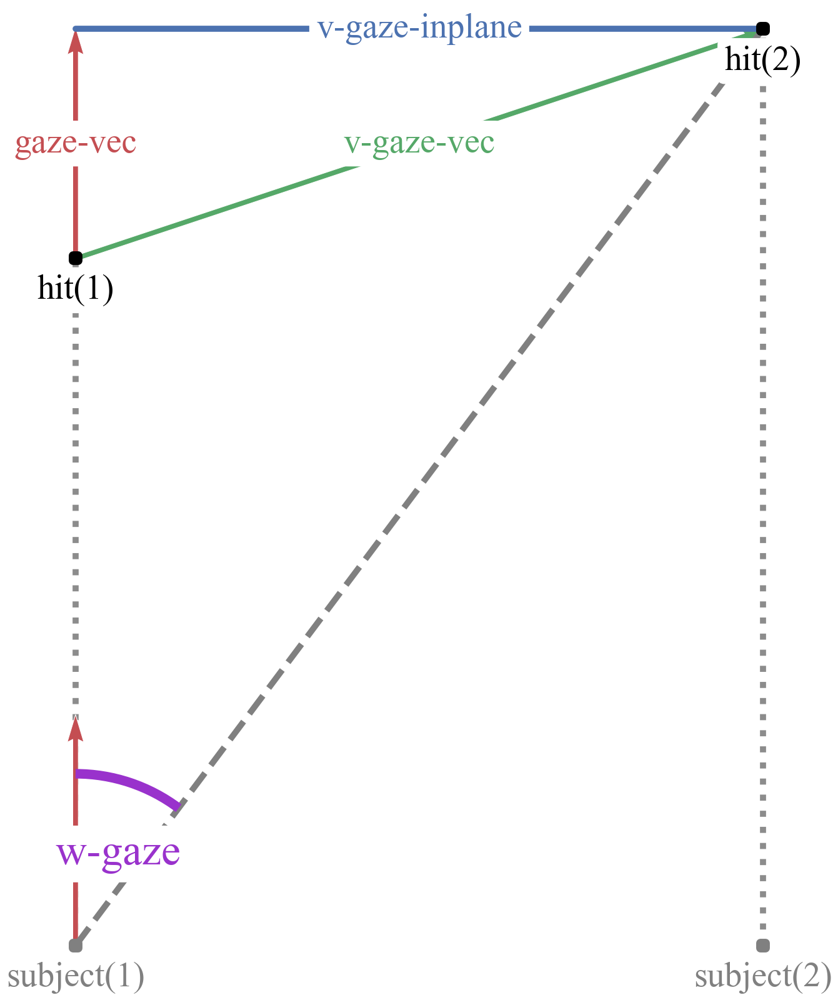

In [168]:
fname = "Times New Roman" # font name
labelsize = 40 #text
linewidth = 7

sns.set(rc={"figure.figsize": (30, 20)})

sns.set_style("whitegrid")
f, (axis) = plt.subplots(1)
axis.set_aspect(axis.get_data_ratio(), adjustable='box')

#### original view direction ####
line_1 = Line2D([1,1], [1,4], linestyle='dotted', marker='', color='k', alpha = 0.5, zorder=1, linewidth = linewidth)
axis.add_line(line_1)
plt.plot([4,4], [1,5], linestyle='dotted', marker='', color='k', alpha = 0.5, zorder=1, linewidth = linewidth)

#### subject position ####
plt.scatter([1,4], [1,1], marker='s', color='grey', zorder=3, linewidth = linewidth+3)
plt.text(1, 0.86, 'subject(1)', horizontalalignment='center', verticalalignment='center', rotation=0, color='grey', size=labelsize, 
         bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.2'), fontname=fname)
plt.text(4, 0.86, 'subject(2)', horizontalalignment='center', verticalalignment='center', rotation=0, color='grey', size=labelsize, 
         bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.2'), fontname=fname)

#### hit points ####
plt.scatter([1,4], [4,5], marker='s', color='black', zorder=3, linewidth = linewidth+3)
plt.text(1, 3.86, 'hit(1)', horizontalalignment='center', verticalalignment='center', rotation=0, color='black', size=labelsize, 
         bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.2'), fontname=fname)
plt.text(4, 4.86, 'hit(2)', horizontalalignment='center', verticalalignment='center', rotation=0, color='black', size=labelsize, 
         bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.2'), fontname=fname)

#### gaze_vec ####
V = np.array([[0,.315], [0,.315]]) # direction of 
origin = np.array([[1, 1],[1, 4]]) # origin points: [all x coords], [all y coords]
plt.quiver(*origin, V[:,0], V[:,1], color=['r','r'], scale=1, linewidth = 0.75)
plt.text(1, 4.5, 'gaze-vec', horizontalalignment='center', verticalalignment='center', rotation=0, color='r', size=labelsize, 
         bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.2'), fontname=fname)

#### v_gaze_vec ####
V = np.array([[.945,0.314]]) # direction of 
origin = np.array([[1],[4]]) # origin points: [all x coords], [all y coords]
plt.quiver(*origin, V[:,0], V[:,1], color=['g'], scale=1, linewidth = 0.75)
plt.text(2.5, 4.5, 'v-gaze-vec', horizontalalignment='center', verticalalignment='center', rotation=0, color='g', size=labelsize, 
         bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.2'), fontname=fname)

#### v_gaze_inplane ####
plt.plot([1,4], [5,5], linestyle='solid', marker='', color='b', alpha = 1, zorder=2, linewidth = linewidth)
plt.text(2.5, 5, 'v-gaze-inplane', horizontalalignment='center', verticalalignment='center', rotation=0, color='b', size=labelsize, 
         bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.2'), fontname=fname)

#### w_gaze ####
line_2 = Line2D([1,4], [1,5], linestyle='dashed', marker='', color='grey', alpha = 1, zorder=1, linewidth = linewidth)
axis.add_line(line_2)
l1xy = line_1.get_xydata()
# Angle between line1 and x-axis
slope1 = (l1xy[1][1] - l1xy[0][1]) / float(l1xy[1][0] - l1xy[0][0])
angle1 = abs(math.degrees(math.atan(slope1))) # Taking only the positive angle
l2xy = line_2.get_xydata()
# Angle between line2 and x-axis
slope2 = (l2xy[1][1] - l2xy[0][1]) / float(l2xy[1][0] - l2xy[0][0])
angle2 = abs(math.degrees(math.atan(slope2)))
theta1 = min(angle1, angle2)
theta2 = max(angle1, angle2)
angle = theta2 - theta1
offset = 1.5
origin = [1,1]
len_x_axis = 1
len_y_axis = 1
angle_plot = Arc(origin, len_x_axis*offset, len_y_axis*offset, 0, theta1, theta2, color='darkorchid', label = str(angle)+u"\u00b0", linewidth = linewidth+4)
axis.add_patch(angle_plot) # To display the angle arc
plt.text(1.185, 1.4, 'w-gaze', horizontalalignment='center', verticalalignment='center', rotation=0, color='darkorchid', size=labelsize+10, 
         bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.2'), weight="bold", fontname=fname)

axis.set_xlim(0.9, 4.1)
axis.set_ylim(0.9, 5.1)
axis.axis('off')
plt.show()


# For LSL part of paper:

In [115]:
durations = [65.80, 7.32, 10.40, 20.58, 20.40, 20.66]
display(np.median(durations))
q75_d, q25_d = np.nanpercentile(durations, [75, 25])
iqr_dur = q75_d - q25_d

print(f"IQR gaze duration: {iqr_dur} ({q25_d}-{q75_d})")
print()

20.49

IQR gaze duration: 7.74 (12.9-20.64)



# Age + Gender; EEG electrodes + icas excluded

In [141]:
age = [24,21,20,23,30,23,22,24,22,20,22,21,19,21,24,22,20,22]
print('Age:')
display(len(age))
display(np.mean(age))
display(np.std(age))
print()

print('Gender:')
# 0 == m, 1 == w
gender = [0,1,0,1,1,0,0,1,1,1,0,1,1,0,0,1,0,0]
display(len(gender))
display(sum(gender))

Age:


18

22.22222222222222

2.3700810008557265


Gender:


18

9

# Segment Statistics

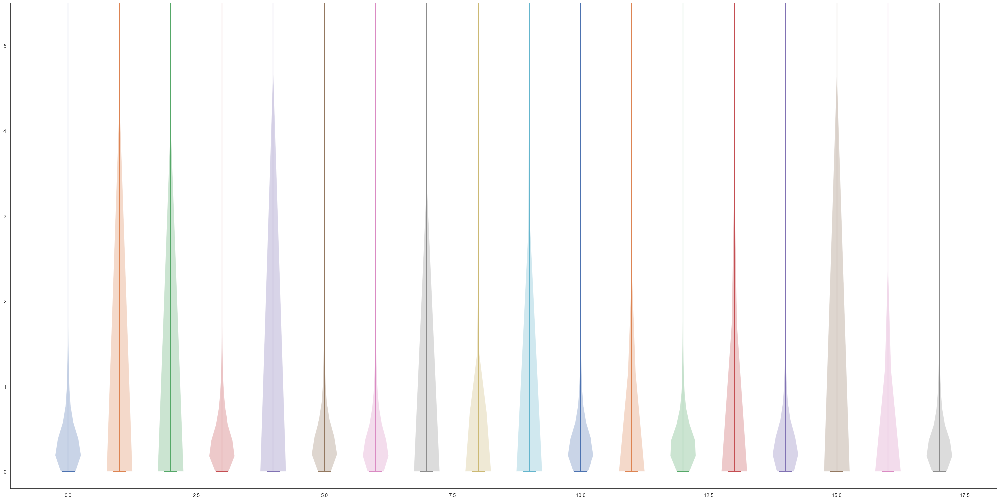

,average_interval_len
0,0.2560
1,0.2230
2,0.2000
3,0.2670
4,0.2100
5,0.2890
6,0.2780
7,0.2560
8,0.2800
9,0.2220



Median Data Segment Duration: 0.25824999999998965
IQR gaze DD: 0.052999999999883585 (0.2222500000001446-0.2752500000000282)


In [106]:
sns.set(rc={"figure.figsize": (30, 15)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, (ax) = plt.subplots(1, constrained_layout=True)

list_interval_dur = []

ids = recordings.index.tolist()
idd = ids[:]
for it,uid in enumerate(idd):
    int_data = pd.read_csv(
        f"{PATH_FOREYE}/interval_mad_wobig_{uid}.csv", index_col=0
    )
    interval_dur = []
    for i in int_data.index.tolist():
        interval_dur = interval_dur + [int_data.iloc[i]["end"] - int_data.iloc[i]["start"]]
        
    # add the value to the list of all subjects
    list_interval_dur = list_interval_dur + [np.median(interval_dur)]
    
    # transfrom the inerval_dur list into a df to be plotted as a violinplot
    interval_dur_df = list(zip(interval_dur,))
    interval_dur_df = pd.DataFrame(interval_dur_df,columns=["interval_dur",],)
    
    ax.violinplot(interval_dur_df.interval_dur.values, positions = [it])
ax.set_ylim(-0.2, 5.5)
plt.show()    
    
# transfrom the list_interval_dur list into a df for statistics
list_interval_dur_df = list(zip(list_interval_dur,))
list_interval_dur_df = pd.DataFrame(list_interval_dur_df,columns=["average_interval_len",],)
display(list_interval_dur_df)
print()
print(f"Median Data Segment Duration: {np.nanmedian(list_interval_dur_df['average_interval_len'])}")

# Interquartile range:
q75, q25 = np.nanpercentile(list_interval_dur_df['average_interval_len'].tolist(), [75, 25])
iqr_seg = q75 - q25
print(f"IQR gaze DD: {iqr_seg} ({q25}-{q75})")

# Data Paths


In [3]:
import copy  # copy big/deep objects by value
import csv
import datetime  # datetime operations
import itertools  # operate with iterators
import json  # read/write from/into json format
import math
import os  # OS operations (read/write files/folders)
import sys
import time
import warnings  # hide warnings
from collections import Counter
from itertools import groupby
import matplotlib

# process parallelization
from multiprocessing import Manager, Pool, RawArray, cpu_count
from os.path import exists

import matplotlib.pyplot as plt  # mother of plots focr Python

# import mlxtend
import numpy as np  # array/matrix operations (e.g. linear algebra)
import pandas as pd  # operate with dataframes
import pyxdf  # read XDF files (LSL streams recordings)

import scipy.stats
import seaborn as sns  # matplotlib plotting nice with shortcuts
from IPython.display import Markdown, display  # print nicely
from ipywidgets import IntProgress
#from matplotlib.pyplot import cm
from scipy.signal import savgol_coeffs
from tqdm.notebook import tqdm, trange  # mother of progressbars
from scipy.stats import ks_2samp
from multiprocessing import Pool, cpu_count

import scipy.signal

In [4]:
DATA_PATH = "E:/WestbrookProject/SpaRe_Data/control_data/pre-processing_2023/step1_preparation"

data_savepath_cleaned = "E:/WestbrookProject/SpaRe_Data/control_data/pre-processing_2023/step2_cleaning_gazeProcessing/1_cleaned"
data_savepath_interpolated = "E:/WestbrookProject/SpaRe_Data/control_data/pre-processing_2023/step2_cleaning_gazeProcessing/2_interpolated"
data_savepath_gazes = "E:/WestbrookProject/SpaRe_Data/control_data/pre-processing_2023/step2_cleaning_gazeProcessing/3_gazes"

data_savepath_intermediateP = "E:/WestbrookProject/SpaRe_Data/control_data/pre-processing_2023/step3_gazeProcessing/intermediateProcessing"
data_savepath_intervals = "E:/WestbrookProject/SpaRe_Data/control_data/pre-processing_2023/step3_gazeProcessing/intervals"
data_savepath_processed_gazes = "E:/WestbrookProject/SpaRe_Data/control_data/pre-processing_2023/step3_gazeProcessing"


# Getting the Folder without hidden files in ascending order 
# DATA_FOLDER = sorted([f for f in os.listdir(DATA_PATH) if not f.startswith('.')], key=str.lower)
# PROCESSED_DATA_FOLDER = sorted([f for f in os.listdir(PROCESSED_DATA_PATH) if not f.startswith('.')], key=str.lower)

# savepath = r'F:\WestbrookProject\SpaRe_Data\pre-processing_2023\step1_preparation\'
# os.chdir(r'F:\WestbrookProject\SpaRe_Data\pre-processed_csv\')

In [5]:
PartList = [1004]

In [6]:
# get time:
ts = data.index.tolist()#
print(len(ts))# to make it easier
print(window_lower)
print(window_upper)
print(data.index[4])

# print(ts.index(list(filter(lambda i: i > window_lower, ts))[0]) : ts.index(list(filter(lambda i: i < window_upper, ts))[-1]))
print(ts.index(list(filter(lambda i: i > window_lower, ts))[0]))

# time = ts[
#     ts.index(
#         list(filter(lambda i: i > window_lower, ts))[0]
#     ) : ts.index(list(filter(lambda i: i < window_upper, ts))[-1])
#     + 1
# ]

NameError: name 'data' is not defined

# Classification Fit

NameError: name 'colliders_color' is not defined

D:\Software\Programme\Anaconda3\envs\graphs\lib\site-packages\IPython\core\pylabtools.py:132: UserWarning: Calling figure.constrained_layout, but figure not setup to do constrained layout.  You either called GridSpec without the fig keyword, you are using plt.subplot, or you need to call figure or subplots with the constrained_layout=True kwarg.
  fig.canvas.print_figure(bytes_io, **kw)


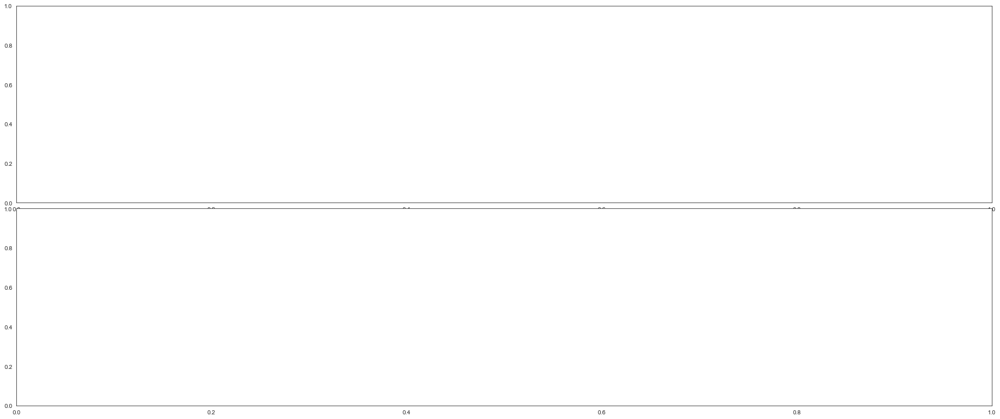

In [7]:
######## APA Style!!! ########


# window_lower = 647.2
# window_upper = 649.5#650

window_lower = 500
window_upper = 600

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Arial" # font name

nr_r = 32
rs = 6


# print('start')
# # useful overviews
# noFilePartList = [len(PartList)]
# missingFiles = pd.DataFrame(columns=['Participant', 'Session'])


# for indexPart, currentPart in enumerate(PartList):
# #     currentPart = PartList[indexPart]
#     print(f'Participant {indexPart} - participant ID {currentPart}')
    
#     sessions = list(range(1,6))

    
#     # loop over recording sessions (should be 5 for each participant)
# #     for indexSess in range(1, 6):
# #     for indexSess in range(1, 2):
#     for indexSess in sessions:

#         # get all eye tracking sessions and loop over them (amount of ET files can vary)
#         fileNames = [f for f in os.listdir(data_savepath_processed_gazes) if f.startswith(f'{currentPart}_Session_{indexSess}') and f.endswith('_data_processed_gazes.csv')]
# #         print(dirSess)
# #         print(f'Session {indexSess}')
        
#         if len(fileNames)< 3:
#             hMF = pd.DataFrame({'Participant': [currentPart], 'Session': [indexSess], 'onlyExistingFilesInSession': [fileNames]})
#             missingFiles = pd.concat([missingFiles, hMF], ignore_index=True)
            

#         for file in fileNames:



f = plt.figure(figsize=(30, 34), constrained_layout=True)
sns.set_style("white") 
ax0 = plt.subplot2grid(shape=(nr_r, 1), loc=(0, 0), rowspan=rs)
ax1 = plt.subplot2grid(shape=(nr_r, 1), loc=(6, 0), rowspan=rs)



axis = [ax0, ax1]


#             data = pd.read_csv(
#                 f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv",
#                 index_col="time",
#             )

# read in data
file= "1004_Session_1_ET_1_data_correTS_mad_wobig.csv"
data = pd.read_csv(os.path.join(data_savepath_intermediateP, file))          

half_t = "Data-Driven"


# get individual coordinates
# position
Xcorr_position = data["eyePositionCombinedWorld_x"].tolist()
Ycorr_position = data["eyePositionCombinedWorld_y"].tolist()
Zcorr_position = data["eyePositionCombinedWorld_z"].tolist()
subj = list(
    zip(Xcorr_position, Ycorr_position, Zcorr_position)
)

# hpoo
hpooX = data["processedCollider_hitPointOnObject_x"].tolist()
hpooY = data["processedCollider_hitPointOnObject_y"].tolist()
hpooZ = data["processedCollider_hitPointOnObject_z"].tolist()
hpoo = list(zip(hpooX, hpooY, hpooZ))

# gaze_vec(t) is a unit vector in the direction of the gaze (eye+head) in world coordinates
g_vec = [
    np.array(hpoo[v] - np.array(subj[v]))
    for v in range(len(subj))
]
gaze_vec = [
    np.array(v) / np.linalg.norm(np.array(v)) for v in g_vec
]
# create df to plot
gaze_vec = pd.DataFrame(
    gaze_vec, columns=["gvx", "gvy", "gvz"]
)
gaze_vec["time"] = data.index.tolist()
gaze_vec = gaze_vec.set_index("time")
# add it to for_eye so we can differentiate between gaze and saccade
data = pd.concat([data, gaze_vec], axis=1)



# get time:
ts = data.index.tolist()  # to make it easier
time = ts[
    ts.index(
        list(filter(lambda i: i > window_lower, ts))[0]
    ) : ts.index(list(filter(lambda i: i < window_upper, ts))[-1])
    + 1
]  # get all timestamps in the important time window

# get shorter df:
data = data.iloc[
    ts.index(time[0]) : (ts.index(time[-1]) + 1)
]


# hon: for showing lines in plot
hon = data["processedCollider_name_interpolated"].tolist()
hon_ts = [
    ti for cnt, ti in enumerate(time) if isinstance(hon[cnt], str)
]  # timestamps

# get gazes:
gaze = data[~data["isFix"].isnull()]
# gaze = data[~data["long_events"].isnull()]

sacc = data[~data.index.isin(gaze.index)]
# sacc = sacc[~sacc["long_events"].isnull()]


gaze = gaze.rename(
    {"gvx": "Gaze x", "gvy": "Gaze y", "gvz": "Gaze z"}, axis=1
)

sacc = sacc.rename(
    {"gvx": "Sacc x", "gvy": "Sacc y", "gvz": "Sacc z"}, axis=1
)

# long_events = data[data["long_events"].isnull()]
# long_events = long_events.rename({"xhpoo": "outliers"}, axis=1)

blinks = data[data["isBlink"].isnull()]


# plot collider changes:
for x, xc in enumerate(hon_ts):
    if not np.isnan(xc):
        axis[0].axvline(
            x=xc, color=colliders_color, alpha=0.4, label="_Hidden label"
        )

color_gaze = {
    "Gaze x": gaze_color_1,
    "Gaze y": gaze_color_2,
    "Gaze z": gaze_color_3,
}

color_sacc = {
    "Sacc x": sacc_color_1,
    "Sacc y": sacc_color_2, 
    "Sacc z": sacc_color_3,
}
gaze[["Gaze x", "Gaze y", "Gaze z"]].plot(
    color=[
        color_gaze.get(x, "#333333")
        for x in gaze[["Gaze x", "Gaze y", "Gaze z"]]
    ],
    ax=axis[0],
    marker="o", ms=8,
    ls="",
)

sacc[["Sacc x", "Sacc y", "Sacc z"]].plot(
    color=[
        color_sacc.get(x, "#333333")
        for x in sacc[["Sacc x", "Sacc y", "Sacc z"]]
    ],
    ax=axis[0],
    marker="o", ms=8,
    ls="",
)


axis[0].set_xticklabels([])


handles, labels = axis[0].get_legend_handles_labels()
axis[0].get_legend().remove()

axis[0].xaxis.label.set_visible(False)
axis[0].set_ylabel("Coordinates", fontsize=labelsize, fontname=fname)
for label in axis[0].get_yticklabels():
    label.set_fontproperties(fname)
axis[0].yaxis.set_tick_params(labelsize=ticksize)  # change tick size



#             axis[1].plot(
#                 time, data["HT_combined_vel"].tolist(), vel_head_color,linestyle =":",linewidth=5, label="Angular Velocity (Head)"
#             )
axis[1].plot(
    time,
    data["combined_vel"].tolist(),
    vel_eye_color,
    linestyle = "--",
    linewidth=3,
    label="Angular Velocity (Eye)",
    alpha=0.9
)


axis[1].plot(
    time,
    data["thresh"].tolist(),
    ten_thres_color,
    #linestyle = ls[fe],
    linewidth=4,
    label="Classification Threshold",
)


#handles, labels = axis[0].get_legend_handles_labels()
f.legend(handles, labels, bbox_to_anchor=(0.5, 0.486, 0.5, 0.5), fontsize=legendsize, fancybox=True, markerscale=2.) #, framealpha=1)

axis[1].set_ylim(0, 600)

legend = axis[1].legend(loc="upper right", fontsize=legendsize, markerscale=2.)
# legend.get_frame().set_alpha(None)
# legend.get_frame().set_facecolor((0, 0, 1, 0.1))
axis[1].set_xlabel("Time (sec)", fontsize=labelsize, fontname=fname)
axis[1].set_ylabel("Veloctiy", fontsize=labelsize, fontname=fname)

for label in axis[1].get_xticklabels():
    label.set_fontproperties(fname)
for label in axis[1].get_yticklabels():
    label.set_fontproperties(fname)

axis[1].yaxis.set_tick_params(labelsize=ticksize)  # change tick size
axis[1].xaxis.set_tick_params(labelsize=ticksize)

axis[0].set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname)
axis[1].set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname)




#plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

In [8]:
######## APA Style!!! ########

ids = recordings.index.tolist()
idd = ids[:1]

window_lower = 647.2
window_upper = 649.5#650

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Arial" # font name

nr_r = 32
rs = 6

for i, uid in enumerate(idd):
    f = plt.figure(figsize=(30, 34), constrained_layout=True)
    sns.set_style("white") 
    ax0 = plt.subplot2grid(shape=(nr_r, 1), loc=(0, 0), rowspan=rs)
    ax1 = plt.subplot2grid(shape=(nr_r, 1), loc=(6, 0), rowspan=rs)
    ax2 = plt.subplot2grid(shape=(nr_r, 1), loc=(13, 0), rowspan=rs)
    ax3 = plt.subplot2grid(shape=(nr_r, 1), loc=(19, 0), rowspan=rs)
    ax4 = plt.subplot2grid(shape=(nr_r, 1), loc=(26, 0), rowspan=rs)
    
    #ax0.set_facecolor(ten_thres_color)
    #ax0.patch.set_alpha(0.07)
    #ax1.set_facecolor(dd_thres_color)
    #ax1.patch.set_alpha(0.07)
    #ax2.set_facecolor(ten_thres_color)
    #ax2.patch.set_alpha(0.07)
    #ax3.set_facecolor(dd_thres_color)
    #ax3.patch.set_alpha(0.07)
    

    ax0.text(647.15,60, '10-Second Method', horizontalalignment='left', verticalalignment='center', rotation=0,
            size=labelsize, fontname=fname, bbox=dict(facecolor='w', boxstyle='round,pad=0.2'))
    ax1.text(647.15,60, 'Data-Driven Method', horizontalalignment='left', verticalalignment='center', rotation=0,
            size=labelsize, fontname=fname, bbox=dict(facecolor='w', boxstyle='round,pad=0.2'))
    ax2.text(647.15,0.86, '10-Second Method', horizontalalignment='left', verticalalignment='center', rotation=0,
            size=labelsize, fontname=fname, bbox=dict(facecolor='w', boxstyle='round,pad=0.2'))
    ax3.text(647.15,0.86, 'Data-Driven Method', horizontalalignment='left', verticalalignment='center', rotation=0,
            size=labelsize, fontname=fname, bbox=dict(facecolor='w', boxstyle='round,pad=0.2'))
    
    
    
    
    axis = [ax0, ax1, ax2, ax3, ax4]
    
    for fe in range(2):
        # to plot hitpoints and gaze direction more easily
        for gh in range(2):
            # load data
            # 10 sec
            if fe == 0:
                for_eye = pd.read_csv(
                    f"{PATH_FOREYE}/correTS__10sec_{uid}.csv", index_col="time"
                )
                half_t = "10-Second"
            else:
                for_eye = pd.read_csv(
                    f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv",
                    index_col="time",
                )
                half_t = "Data-Driven"
            if gh == 0:
                titel = "Hit Points: " + half_t
            else:
                titel = "Gaze Directions: " + half_t
                
            # get the direction vector
            if gh == 1:
                # get individual coordinates
                # position
                Xcorr_position = for_eye["xcoord_orig"].tolist()
                Ycorr_position = for_eye["ycoord_orig"].tolist()
                Zcorr_position = for_eye["zcoord_orig"].tolist()
                subj = list(
                    zip(Xcorr_position, Ycorr_position, Zcorr_position)
                )

                # hpoo
                hpooX = for_eye["xhpoo"].tolist()
                hpooY = for_eye["yhpoo"].tolist()
                hpooZ = for_eye["zhpoo"].tolist()
                hpoo = list(zip(hpooX, hpooY, hpooZ))

                # gaze_vec(t) is a unit vector in the direction of the gaze (eye+head) in world coordinates
                g_vec = [
                    np.array(hpoo[v] - np.array(subj[v]))
                    for v in range(len(subj))
                ]
                gaze_vec = [
                    np.array(v) / np.linalg.norm(np.array(v)) for v in g_vec
                ]
                # create df to plot
                gaze_vec = pd.DataFrame(
                    gaze_vec, columns=["gvx", "gvy", "gvz"]
                )
                gaze_vec["time"] = for_eye.index.tolist()
                gaze_vec = gaze_vec.set_index("time")
                # add it to for_eye so we can differentiate between gaze and saccade
                for_eye = pd.concat([for_eye, gaze_vec], axis=1)
            
            # get time:
            ts = for_eye.index.tolist()  # to make it easier
            time = ts[
                ts.index(
                    list(filter(lambda i: i > window_lower, ts))[0]
                ) : ts.index(list(filter(lambda i: i < window_upper, ts))[-1])
                + 1
            ]  # get all timestamps in the important time window

            # get shorter df:
            for_eye = for_eye.iloc[
                ts.index(time[0]) : (ts.index(time[-1]) + 1)
            ]
            
            # substract 500 to make the streams appear close together
            if gh == 0:
                # substract 600 from the x and y coordinates for easier plotting:
                for_eye["xhpoo"] = list(
                    map(lambda x: x - 600, for_eye["xhpoo"].tolist())
                )  # substract 600 from each element for better plotting
                for_eye["zhpoo"] = list(
                    map(lambda x: x - 600, for_eye["zhpoo"].tolist())
                )  # substract 600 from each element for better plotting
            
            # hon: for showing lines in plot
            hon = for_eye["hon"].tolist()
            hon_ts = [
                ti for cnt, ti in enumerate(time) if isinstance(hon[cnt], str)
            ]  # timestamps

            # get gazes:
            gaze = for_eye[~for_eye["isFix"].isnull()]
            gaze = gaze[~gaze["long_events"].isnull()]

            sacc = for_eye[~for_eye.index.isin(gaze.index)]
            sacc = sacc[~sacc["long_events"].isnull()]


            if gh == 0:
                gaze = gaze.rename(
                    {"xhpoo": "Gaze x", "yhpoo": "Gaze y", "zhpoo": "Gaze z"}, axis=1
                )
                sacc = sacc.rename(
                    {"xhpoo": "Sacc x", "yhpoo": "Sacc y", "zhpoo": "Sacc z"}, axis=1
                )
            else:
                gaze = gaze.rename(
                    {"gvx": "Gaze x", "gvy": "Gaze y", "gvz": "Gaze z"}, axis=1
                )

                sacc = sacc.rename(
                    {"gvx": "Sacc x", "gvy": "Sacc y", "gvz": "Sacc z"}, axis=1
                )

            long_events = for_eye[for_eye["long_events"].isnull()]
            long_events = long_events.rename({"xhpoo": "outliers"}, axis=1)
            
            blinks = for_eye[for_eye["blinks"].isnull()]

            # get the axis to plot:
            if gh == 0:
                axis_nr = fe
            else:
                axis_nr = 2+fe

            # plot collider changes:
            for x, xc in enumerate(hon_ts):
                if not np.isnan(xc):
                    axis[axis_nr].axvline(
                        x=xc, color=colliders_color, alpha=0.4, label="_Hidden label"
                    )

            color_gaze = {
                "Gaze x": gaze_color_1,
                "Gaze y": gaze_color_2,
                "Gaze z": gaze_color_3,
            }

            color_sacc = {
                "Sacc x": sacc_color_1,
                "Sacc y": sacc_color_2, 
                "Sacc z": sacc_color_3,
            }
            gaze[["Gaze x", "Gaze y", "Gaze z"]].plot(
                color=[
                    color_gaze.get(x, "#333333")
                    for x in gaze[["Gaze x", "Gaze y", "Gaze z"]]
                ],
                ax=axis[axis_nr],
                marker="o", ms=8,
                ls="",
            )
            
            sacc[["Sacc x", "Sacc y", "Sacc z"]].plot(
                color=[
                    color_sacc.get(x, "#333333")
                    for x in sacc[["Sacc x", "Sacc y", "Sacc z"]]
                ],
                ax=axis[axis_nr],
                marker="o", ms=8,
                ls="",
            )

            
            axis[axis_nr].set_xticklabels([])
                
            if axis_nr > 0 :
                axis[axis_nr].get_legend().remove()
            else:
                handles, labels = axis[0].get_legend_handles_labels()
                axis[axis_nr].get_legend().remove()
                
            axis[axis_nr].xaxis.label.set_visible(False)
            axis[axis_nr].set_ylabel("Coordinates", fontsize=labelsize, fontname=fname)
            for label in axis[axis_nr].get_yticklabels():
                label.set_fontproperties(fname)
            axis[axis_nr].yaxis.set_tick_params(labelsize=ticksize)  # change tick size
            

            if fe == 0 and gh == 0:
                axis[4].plot(
                    time, for_eye["HT_combined_vel"].tolist(), vel_head_color,linestyle =":",linewidth=5, label="Angular Velocity (Head)"
                )
                axis[4].plot(
                    time,
                    for_eye["combined_vel"].tolist(),
                    vel_eye_color,
                    linestyle = "--",
                    linewidth=3,
                    label="Angular Velocity (Eye)",
                    alpha=0.9
                )
            
                c = [ten_thres_color, dd_thres_color]
                ls = [':','--']
            if gh == 0:
                axis[4].plot(
                    time,
                    for_eye["thresh"].tolist(),
                    c[fe],
                    #linestyle = ls[fe],
                    linewidth=4,
                    label=half_t + " Threshold",
                )


    #handles, labels = axis[0].get_legend_handles_labels()
    f.legend(handles, labels, bbox_to_anchor=(0.5, 0.486, 0.5, 0.5), fontsize=legendsize, fancybox=True, markerscale=2.) #, framealpha=1)
    
    axis[4].set_ylim(0, 600)

    legend = axis[4].legend(loc="upper right", fontsize=legendsize, markerscale=2.)
    # legend.get_frame().set_alpha(None)
    # legend.get_frame().set_facecolor((0, 0, 1, 0.1))
    axis[4].set_xlabel("Time (sec)", fontsize=labelsize, fontname=fname)
    axis[4].set_ylabel("Veloctiy", fontsize=labelsize, fontname=fname)
    
    for label in axis[4].get_xticklabels():
        label.set_fontproperties(fname)
    for label in axis[4].get_yticklabels():
        label.set_fontproperties(fname)
    
    axis[4].yaxis.set_tick_params(labelsize=ticksize)  # change tick size
    axis[4].xaxis.set_tick_params(labelsize=ticksize)

    axis[0].set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname)
    axis[2].set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname)
    axis[4].set_title("C", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname)
    
    
    ####### Add boxes ########
    y_up, y_down = axis[0].get_ylim(), axis[4].get_ylim()
    
    axis[0].hlines(max(y_up), 647.6, 647.65, linewidth=5, color=gaze_color_1)
    axis[4].hlines(min(y_down)+20, 647.6, 647.65, linewidth=5, color=gaze_color_1)

    line1 = ConnectionPatch(xyA=[647.6,min(y_down)+20], xyB=[647.6,max(y_up)], coordsA="data", coordsB="data",
                          axesA= axis[4], axesB=axis[0], color=gaze_color_1, lw=5,zorder=2)
    line2 = ConnectionPatch(xyA=[647.65,min(y_down)+20], xyB=[647.65,max(y_up)], coordsA="data", coordsB="data",
                          axesA= axis[4], axesB=axis[0], color=gaze_color_1, lw=5,zorder=2)
    axis[4].add_artist(line1)
    axis[4].add_artist(line2)


    axis[0].hlines(max(y_up), 648.3, 648.5, linewidth=5, color=sacc_color_1)
    axis[4].hlines(min(y_down)+20, 648.3, 648.5, linewidth=5, color=sacc_color_1)

    line1 = ConnectionPatch(xyA=[648.3,min(y_down)+20], xyB=[648.3,max(y_up)], coordsA="data", coordsB="data",
                          axesA= axis[4], axesB=axis[0], color=sacc_color_1, lw=5,zorder=2)
    line2 = ConnectionPatch(xyA=[648.5,min(y_down)+20], xyB=[648.5,max(y_up)], coordsA="data", coordsB="data",
                          axesA= axis[4], axesB=axis[0], color=sacc_color_1, lw=5,zorder=2)
    axis[4].add_artist(line1)
    axis[4].add_artist(line2)
    #axis[0].text(window_lower+2,max(y_up)-12,'a', fontsize=30, fontweight="bold")
    
    y_down1 =  axis[1].get_ylim()

    axis[0].hlines(max(y_up), 648.85, 648.9, linewidth=5, color=vel_eye_color)
    axis[1].hlines(min(y_down1)+5, 648.85, 648.9, linewidth=5, color=vel_eye_color)

    line1 = ConnectionPatch(xyA=[648.85,min(y_down1)+5], xyB=[648.85,max(y_up)], coordsA="data", coordsB="data",
                          axesA= axis[1], axesB=axis[0], color=vel_eye_color, lw=5,zorder=3)
    line2 = ConnectionPatch(xyA=[648.9,min(y_down1)+5], xyB=[648.9,max(y_up)], coordsA="data", coordsB="data",
                          axesA= axis[1], axesB=axis[0], color=vel_eye_color, lw=5,zorder=3)
    axis[1].add_artist(line1)
    axis[1].add_artist(line2)



    
    

   #plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

NameError: name 'recordings' is not defined

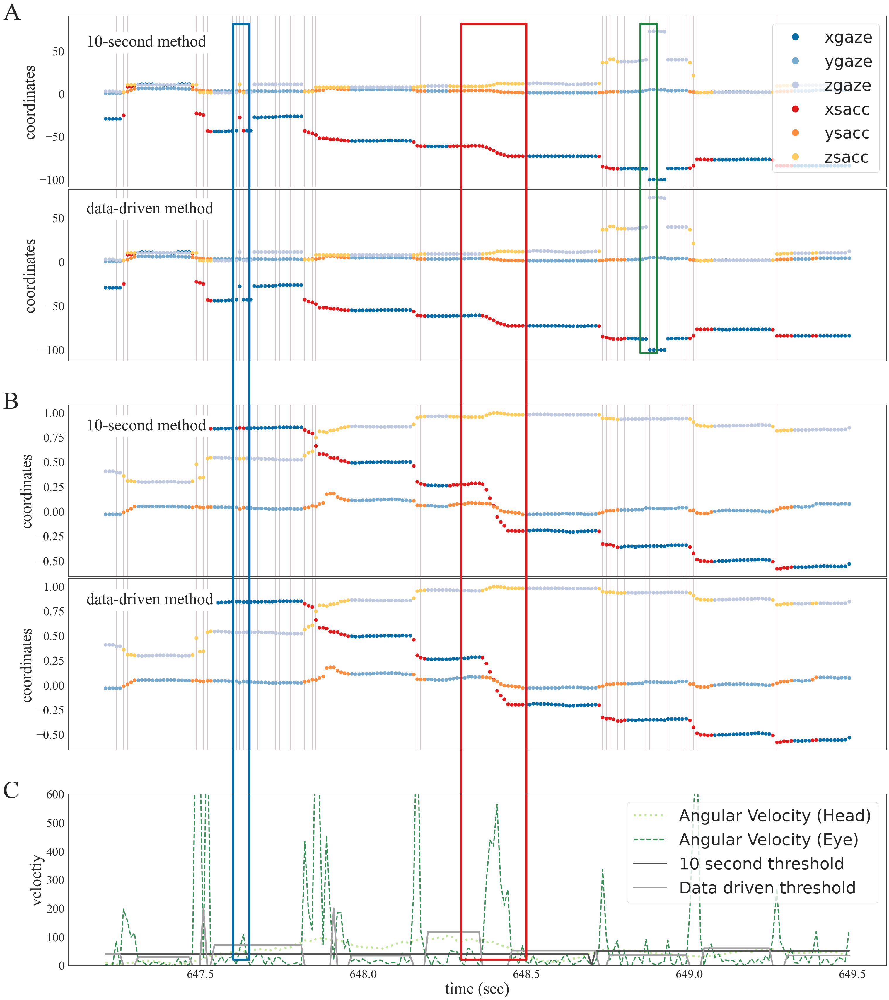

In [253]:
ids = recordings.index.tolist()
idd = ids[:1]

window_lower = 647.2
window_upper = 649.5#650

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Times New Roman" # font name

nr_r = 32
rs = 6

for i, uid in enumerate(idd):
    f = plt.figure(figsize=(30, 34), constrained_layout=True)
    sns.set_style("white") 
    ax0 = plt.subplot2grid(shape=(nr_r, 1), loc=(0, 0), rowspan=rs)
    ax1 = plt.subplot2grid(shape=(nr_r, 1), loc=(6, 0), rowspan=rs)
    ax2 = plt.subplot2grid(shape=(nr_r, 1), loc=(13, 0), rowspan=rs)
    ax3 = plt.subplot2grid(shape=(nr_r, 1), loc=(19, 0), rowspan=rs)
    ax4 = plt.subplot2grid(shape=(nr_r, 1), loc=(26, 0), rowspan=rs)
    
    #ax0.set_facecolor(ten_thres_color)
    #ax0.patch.set_alpha(0.07)
    #ax1.set_facecolor(dd_thres_color)
    #ax1.patch.set_alpha(0.07)
    #ax2.set_facecolor(ten_thres_color)
    #ax2.patch.set_alpha(0.07)
    #ax3.set_facecolor(dd_thres_color)
    #ax3.patch.set_alpha(0.07)
    

    ax0.text(647.15,60, '10-second method', horizontalalignment='left', verticalalignment='center', rotation=0,
            size=labelsize, fontname=fname, bbox=dict(facecolor='w', boxstyle='round,pad=0.2'))
    ax1.text(647.15,60, 'data-driven method', horizontalalignment='left', verticalalignment='center', rotation=0,
            size=labelsize, fontname=fname, bbox=dict(facecolor='w', boxstyle='round,pad=0.2'))
    ax2.text(647.15,0.86, '10-second method', horizontalalignment='left', verticalalignment='center', rotation=0,
            size=labelsize, fontname=fname, bbox=dict(facecolor='w', boxstyle='round,pad=0.2'))
    ax3.text(647.15,0.86, 'data-driven method', horizontalalignment='left', verticalalignment='center', rotation=0,
            size=labelsize, fontname=fname, bbox=dict(facecolor='w', boxstyle='round,pad=0.2'))
    
    
    
    
    axis = [ax0, ax1, ax2, ax3, ax4]
    
    for fe in range(2):
        # to plot hitpoints and gaze direction more easily
        for gh in range(2):
            # load data
            # 10 sec
            if fe == 0:
                for_eye = pd.read_csv(
                    f"{PATH_FOREYE}/correTS__10sec_{uid}.csv", index_col="time"
                )
                half_t = "10 second"
            else:
                for_eye = pd.read_csv(
                    f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv",
                    index_col="time",
                )
                half_t = "Data driven"
            if gh == 0:
                titel = "Hit Points: " + half_t
            else:
                titel = "Gaze Directions: " + half_t
                
            # get the direction vector
            if gh == 1:
                # get individual coordinates
                # position
                Xcorr_position = for_eye["xcoord_orig"].tolist()
                Ycorr_position = for_eye["ycoord_orig"].tolist()
                Zcorr_position = for_eye["zcoord_orig"].tolist()
                subj = list(
                    zip(Xcorr_position, Ycorr_position, Zcorr_position)
                )

                # hpoo
                hpooX = for_eye["xhpoo"].tolist()
                hpooY = for_eye["yhpoo"].tolist()
                hpooZ = for_eye["zhpoo"].tolist()
                hpoo = list(zip(hpooX, hpooY, hpooZ))

                # gaze_vec(t) is a unit vector in the direction of the gaze (eye+head) in world coordinates
                g_vec = [
                    np.array(hpoo[v] - np.array(subj[v]))
                    for v in range(len(subj))
                ]
                gaze_vec = [
                    np.array(v) / np.linalg.norm(np.array(v)) for v in g_vec
                ]
                # create df to plot
                gaze_vec = pd.DataFrame(
                    gaze_vec, columns=["gvx", "gvy", "gvz"]
                )
                gaze_vec["time"] = for_eye.index.tolist()
                gaze_vec = gaze_vec.set_index("time")
                # add it to for_eye so we can differentiate between gaze and saccade
                for_eye = pd.concat([for_eye, gaze_vec], axis=1)
            
            # get time:
            ts = for_eye.index.tolist()  # to make it easier
            time = ts[
                ts.index(
                    list(filter(lambda i: i > window_lower, ts))[0]
                ) : ts.index(list(filter(lambda i: i < window_upper, ts))[-1])
                + 1
            ]  # get all timestamps in the important time window

            # get shorter df:
            for_eye = for_eye.iloc[
                ts.index(time[0]) : (ts.index(time[-1]) + 1)
            ]
            
            # substract 500 to make the streams appear close together
            if gh == 0:
                # substract 600 from the x and y coordinates for easier plotting:
                for_eye["xhpoo"] = list(
                    map(lambda x: x - 600, for_eye["xhpoo"].tolist())
                )  # substract 600 from each element for better plotting
                for_eye["zhpoo"] = list(
                    map(lambda x: x - 600, for_eye["zhpoo"].tolist())
                )  # substract 600 from each element for better plotting
            
            # hon: for showing lines in plot
            hon = for_eye["hon"].tolist()
            hon_ts = [
                ti for cnt, ti in enumerate(time) if isinstance(hon[cnt], str)
            ]  # timestamps

            # get gazes:
            gaze = for_eye[~for_eye["isFix"].isnull()]
            gaze = gaze[~gaze["long_events"].isnull()]

            sacc = for_eye[~for_eye.index.isin(gaze.index)]
            sacc = sacc[~sacc["long_events"].isnull()]


            if gh == 0:
                gaze = gaze.rename(
                    {"xhpoo": "xgaze", "yhpoo": "ygaze", "zhpoo": "zgaze"}, axis=1
                )
                sacc = sacc.rename(
                    {"xhpoo": "xsacc", "yhpoo": "ysacc", "zhpoo": "zsacc"}, axis=1
                )
            else:
                gaze = gaze.rename(
                    {"gvx": "xgaze", "gvy": "ygaze", "gvz": "zgaze"}, axis=1
                )

                sacc = sacc.rename(
                    {"gvx": "xsacc", "gvy": "ysacc", "gvz": "zsacc"}, axis=1
                )

            long_events = for_eye[for_eye["long_events"].isnull()]
            long_events = long_events.rename({"xhpoo": "outliers"}, axis=1)
            
            blinks = for_eye[for_eye["blinks"].isnull()]

            # get the axis to plot:
            if gh == 0:
                axis_nr = fe
            else:
                axis_nr = 2+fe

            # plot collider changes:
            for x, xc in enumerate(hon_ts):
                if not np.isnan(xc):
                    axis[axis_nr].axvline(
                        x=xc, color=colliders_color, alpha=0.4, label="_Hidden label"
                    )

            color_gaze = {
                "xgaze": gaze_color_1,
                "ygaze": gaze_color_2,
                "zgaze": gaze_color_3,
            }

            color_sacc = {
                "xsacc": sacc_color_1,
                "ysacc": sacc_color_2, 
                "zsacc": sacc_color_3,
            }
            gaze[["xgaze", "ygaze", "zgaze"]].plot(
                color=[
                    color_gaze.get(x, "#333333")
                    for x in gaze[["xgaze", "ygaze", "zgaze"]]
                ],
                ax=axis[axis_nr],
                marker="o", ms=8,
                ls="",
            )
            
            sacc[["xsacc", "ysacc", "zsacc"]].plot(
                color=[
                    color_sacc.get(x, "#333333")
                    for x in sacc[["xsacc", "ysacc", "zsacc"]]
                ],
                ax=axis[axis_nr],
                marker="o", ms=8,
                ls="",
            )

            
            axis[axis_nr].set_xticklabels([])
                
            if axis_nr > 0 :
                axis[axis_nr].get_legend().remove()
            else:
                handles, labels = axis[0].get_legend_handles_labels()
                axis[axis_nr].get_legend().remove()
                
            axis[axis_nr].xaxis.label.set_visible(False)
            axis[axis_nr].set_ylabel("coordinates", fontsize=labelsize, fontname=fname)
            for label in axis[axis_nr].get_yticklabels():
                label.set_fontproperties(fname)
            axis[axis_nr].yaxis.set_tick_params(labelsize=ticksize)  # change tick size
            

            if fe == 0 and gh == 0:
                axis[4].plot(
                    time, for_eye["HT_combined_vel"].tolist(), vel_head_color,linestyle =":",linewidth=5, label="Angular Velocity (Head)"
                )
                axis[4].plot(
                    time,
                    for_eye["combined_vel"].tolist(),
                    vel_eye_color,
                    linestyle = "--",
                    linewidth=3,
                    label="Angular Velocity (Eye)",
                    alpha=0.9
                )
            
                c = [ten_thres_color, dd_thres_color]
                ls = [':','--']
            if gh == 0:
                axis[4].plot(
                    time,
                    for_eye["thresh"].tolist(),
                    c[fe],
                    #linestyle = ls[fe],
                    linewidth=4,
                    label=half_t + " threshold",
                )


    #handles, labels = axis[0].get_legend_handles_labels()
    f.legend(handles, labels, bbox_to_anchor=(0.5, 0.486, 0.5, 0.5), fontsize=legendsize, fancybox=True, markerscale=2.) #, framealpha=1)
    
    axis[4].set_ylim(0, 600)

    legend = axis[4].legend(loc="upper right", fontsize=legendsize, markerscale=2.)
    # legend.get_frame().set_alpha(None)
    # legend.get_frame().set_facecolor((0, 0, 1, 0.1))
    axis[4].set_xlabel("time (sec)", fontsize=labelsize, fontname=fname)
    axis[4].set_ylabel("veloctiy", fontsize=labelsize, fontname=fname)
    
    for label in axis[4].get_xticklabels():
        label.set_fontproperties(fname)
    for label in axis[4].get_yticklabels():
        label.set_fontproperties(fname)
    
    axis[4].yaxis.set_tick_params(labelsize=ticksize)  # change tick size
    axis[4].xaxis.set_tick_params(labelsize=ticksize)

    axis[0].set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname)
    axis[2].set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname)
    axis[4].set_title("C", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname)
    
    
    ####### Add boxes ########
    y_up, y_down = axis[0].get_ylim(), axis[4].get_ylim()
    
    axis[0].hlines(max(y_up), 647.6, 647.65, linewidth=5, color=gaze_color_1)
    axis[4].hlines(min(y_down)+20, 647.6, 647.65, linewidth=5, color=gaze_color_1)

    line1 = ConnectionPatch(xyA=[647.6,min(y_down)+20], xyB=[647.6,max(y_up)], coordsA="data", coordsB="data",
                          axesA= axis[4], axesB=axis[0], color=gaze_color_1, lw=5,zorder=2)
    line2 = ConnectionPatch(xyA=[647.65,min(y_down)+20], xyB=[647.65,max(y_up)], coordsA="data", coordsB="data",
                          axesA= axis[4], axesB=axis[0], color=gaze_color_1, lw=5,zorder=2)
    axis[4].add_artist(line1)
    axis[4].add_artist(line2)


    axis[0].hlines(max(y_up), 648.3, 648.5, linewidth=5, color=sacc_color_1)
    axis[4].hlines(min(y_down)+20, 648.3, 648.5, linewidth=5, color=sacc_color_1)

    line1 = ConnectionPatch(xyA=[648.3,min(y_down)+20], xyB=[648.3,max(y_up)], coordsA="data", coordsB="data",
                          axesA= axis[4], axesB=axis[0], color=sacc_color_1, lw=5,zorder=2)
    line2 = ConnectionPatch(xyA=[648.5,min(y_down)+20], xyB=[648.5,max(y_up)], coordsA="data", coordsB="data",
                          axesA= axis[4], axesB=axis[0], color=sacc_color_1, lw=5,zorder=2)
    axis[4].add_artist(line1)
    axis[4].add_artist(line2)
    #axis[0].text(window_lower+2,max(y_up)-12,'a', fontsize=30, fontweight="bold")
    
    y_down1 =  axis[1].get_ylim()

    axis[0].hlines(max(y_up), 648.85, 648.9, linewidth=5, color=vel_eye_color)
    axis[1].hlines(min(y_down1)+5, 648.85, 648.9, linewidth=5, color=vel_eye_color)

    line1 = ConnectionPatch(xyA=[648.85,min(y_down1)+5], xyB=[648.85,max(y_up)], coordsA="data", coordsB="data",
                          axesA= axis[1], axesB=axis[0], color=vel_eye_color, lw=5,zorder=3)
    line2 = ConnectionPatch(xyA=[648.9,min(y_down1)+5], xyB=[648.9,max(y_up)], coordsA="data", coordsB="data",
                          axesA= axis[1], axesB=axis[0], color=vel_eye_color, lw=5,zorder=3)
    axis[1].add_artist(line1)
    axis[1].add_artist(line2)



    
    

   #plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# Saccade Velocity vs. Amplitude

In [8]:
def compute_centroid(df, columns):
    centroid = df[columns].mean().values
    return centroid

def compute_saccade_amplitude(prev_gaze_centroid, prev_subject_centroid, gaze_centroid, subject_centroid):
    v_eye_vec = gaze_centroid - prev_gaze_centroid
    eye_vec = prev_gaze_centroid - prev_subject_centroid
    eye_vec = eye_vec/np.linalg.norm(eye_vec)
    projection = np.dot(v_eye_vec, eye_vec) * eye_vec
    v_eye_inplane = np.linalg.norm(v_eye_vec - projection)
    sacc_amplitude = np.arctan2(v_eye_inplane, np.linalg.norm(prev_subject_centroid - prev_gaze_centroid))
    return np.degrees(sacc_amplitude)

In [ ]:
# create the plot and add to it each loop


ids = recordings.index.tolist()
idd = ids[:1]

for uid in idd:
    display(uid)
    # load the data 
    for_eye = pd.read_csv(f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0)
    
    
    # --- SACCADE AMPLITUDE ---
    prev_gaze_centroid = None
    prev_subject_centroid = None
    for_eye['saccade_amplitude'] = np.nan # create a row in the df with nans
    start_indices = for_eye[for_eye['events'] == 2.0].index
    end_indices = for_eye[for_eye['events'] == -2.0].index
    start_sacc = for_eye[for_eye['events'] == 1.0].index # get the start of saccades to appropriately add the saccade amplitudes to the conditions
    # correct for two cases:
    # check if first start_sacc is smaller than first start_indices --> if not, add the first start_indices to the start_sacc list
    if start_sacc[0] > start_indices[0]:
        start_sacc = [start_indices[0]] + start_sacc
    # if the last start_sacc is bigger than the last start_indices --> remove it
    if start_sacc[-1] > start_indices[-1]:
        start_sacc = start_sacc[:-1]

    if len(end_indices) > len(start_indices):
        # in case there has been an end index without a start one, get rid of this
        if end_indices[0] < start_indices[0]:
            end_indices = end_indices[1:]
        else: 
            print(uid)

    for start, end, start_s in zip(start_indices, end_indices, start_sacc):
        group_df = for_eye.loc[start:end]
        # Compute the centroid of the gaze positions and the mean timestamp
        gaze_centroid = compute_centroid(group_df, ['xhpoo', 'yhpoo', 'zhpoo'])
        subject_centroid = compute_centroid(group_df, ['xcoord_orig', 'ycoord_orig', 'zcoord_orig'])

        # Compute the saccade amplitude and store it in the dataframe
        if prev_gaze_centroid is not None and prev_subject_centroid is not None:
            for_eye.loc[start_s:end, 'saccade_amplitude'] = compute_saccade_amplitude(prev_gaze_centroid, prev_subject_centroid, gaze_centroid, subject_centroid)

        # Update the previous centroids and timestamp
        prev_gaze_centroid = gaze_centroid
        prev_subject_centroid = subject_centroid
    # --- SACCADE AMPLITUDE ---
    
    
    # --- PEAK VELOCITY ---
    for start_s, start in zip(start_sacc, start_indices):
        gaze = for_eye[for_eye["events"] == 2.0]
    gaze = gaze[~gaze["long_events"].isnull()]
    trials = []
    max_vels = []
    for g, gz in enumerate(gaze.index.tolist()):
        if gz - start_fr_peak > 0 and gz + 3 < len(gaze.index.tolist()):
            cur = for_eye.iloc[gz - start_fr_peak : gz + 3]
            trials.append(
                cur["combined_vel"]
                .tolist()
                .index(np.nanmax(cur["combined_vel"].tolist()))
            )
            trials_all.append(
                cur["combined_vel"]
                .tolist()
                .index(np.nanmax(cur["combined_vel"].tolist()))
            )
            max_vels.append(np.nanmedian(
                cur["combined_vel"]
                .tolist())
            )
    max_vels_all['max_vels'][uid] = np.nanmedian(max_vels)
    # --- PEAK VELOCITY ---
    
    sacc = for_eye[for_eye["events"] == 1.0]
    #display(sacc)
    
    # plot it against each other

'70656182-09b3-4c19-9ae2-0a2ab2e19fed'

,time,valid,xcoord,ycoord,zcoord,xcoord_orig,ycoord_orig,zcoord_orig,xlocal_dir,ylocal_dir,...,isFix,HT_isFix,corrected_vel,events,length,distance,avg_dist,names,long_events,saccade_amplitude
0,0.000,1.0,0.988025,0.005818,-0.154171,552.43690,2.069883,588.65920,0.154922,0.024078,...,NaN,NaN,NaN,1.0,0.033,20.308743,17.708976,Lod_1,6.744908e-01,NaN
20,0.223,1.0,0.987359,0.009503,-0.158264,552.82965,2.066701,588.64870,0.130188,0.011597,...,NaN,48.230848,39.855934,1.0,0.100,15.418041,15.338283,Lod_1,3.525747e-01,11.993286
66,0.732,1.0,0.960162,0.289338,-0.177362,553.76904,2.070116,588.56995,0.042725,0.174881,...,NaN,NaN,102.104021,1.0,0.044,15.274196,15.245247,Lod_1,5.058681e-01,8.833794
85,0.944,1.0,0.929043,0.425159,-0.190226,554.14120,2.079228,588.46590,-0.006897,0.231583,...,NaN,32.642833,66.697832,1.0,0.034,15.633482,15.614829,Lod_1,6.591614e-01,4.356221
104,1.155,1.0,0.908324,0.488468,-0.205024,554.51510,2.088233,588.36990,-0.045227,0.205261,...,NaN,38.602838,26.860429,1.0,0.077,15.817282,15.764775,Lod_1,3.455279e-12,3.039949
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161769,1885.556,1.0,-0.072268,0.222326,0.983480,629.98663,2.115191,575.52540,-0.333344,-0.041245,...,NaN,NaN,531.624501,1.0,0.100,246.686498,246.691887,Sky (2),3.525747e-01,10.739452
161783,1885.711,1.0,-0.134801,0.189095,0.980768,630.01587,2.114039,575.51715,-0.342484,-0.051147,...,NaN,8.854861,44.538465,1.0,0.078,246.174550,246.173217,Sky (2),1.532934e-02,5.629192
161803,1885.933,1.0,0.146161,0.242073,0.972611,629.98364,2.111865,575.52716,-0.050156,-0.017029,...,NaN,NaN,52.700085,1.0,0.089,246.519819,246.520440,Sky (2),1.839520e-01,16.420878
161857,1886.533,1.0,0.541108,0.218853,0.824937,630.02580,2.108605,575.52234,0.291504,-0.031265,...,NaN,NaN,1000.000000,1.0,0.022,106.625912,106.625789,streetLight2 (13),8.431134e-01,11.031823


# Eye and Head Movements

NameError: name 'gaze_color_1' is not defined

D:\Software\Programme\Anaconda3\envs\graphs\lib\site-packages\IPython\core\pylabtools.py:132: UserWarning: Calling figure.constrained_layout, but figure not setup to do constrained layout.  You either called GridSpec without the fig keyword, you are using plt.subplot, or you need to call figure or subplots with the constrained_layout=True kwarg.
  fig.canvas.print_figure(bytes_io, **kw)


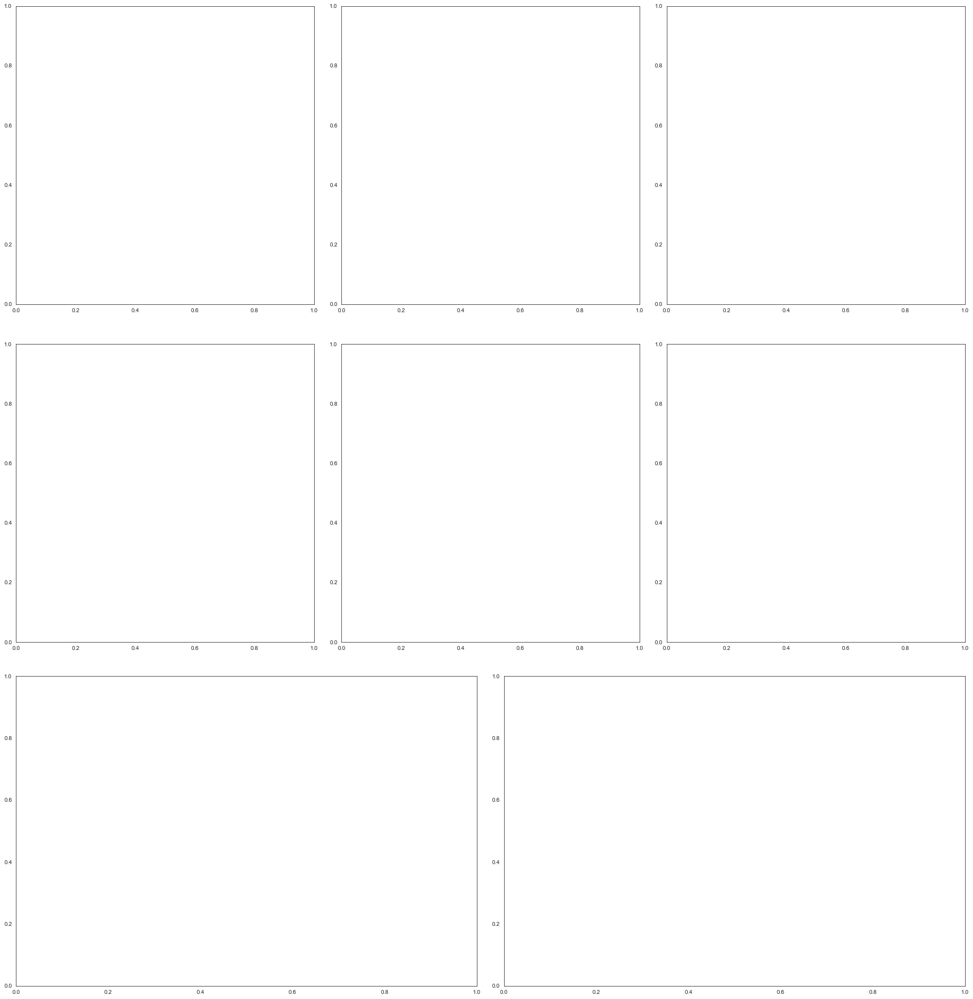

In [9]:
######## APA Style!!! ########

# ids = recordings.index.tolist()
idd = [1]

gze = []
sac = []
cnt = 0
min_x = 481
max_x = 661
min_y = 520
max_y = 655

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Arial" # font name

#sns.set(rc={"figure.figsize": (12, 6)})
plt.figure(figsize=(30, 32), constrained_layout=True)

sns.set_style("white") 
plt.rcParams["font.family"] = fname

ax11 = plt.subplot2grid(shape=(6, 6), loc=(0, 0), rowspan=2, colspan=2)
ax12 = plt.subplot2grid(shape=(6, 6), loc=(0, 2), rowspan=2, colspan=2)
ax13 = plt.subplot2grid(shape=(6, 6), loc=(0, 4), rowspan=2, colspan=2)
ax21 = plt.subplot2grid(shape=(6, 6), loc=(2, 0), rowspan=2, colspan=2)
ax22 = plt.subplot2grid(shape=(6, 6), loc=(2, 2), rowspan=2, colspan=2)
ax23 = plt.subplot2grid(shape=(6, 6), loc=(2, 4), rowspan=2, colspan=2)
ax3 = plt.subplot2grid(shape=(6, 6), loc=(4, 0), rowspan=2, colspan=3)
ax4 = plt.subplot2grid(shape=(6, 6), loc=(4, 3), rowspan=2, colspan=3)

ax11.set_aspect(1.0/ax11.get_data_ratio(), adjustable='box')
ax12.set_aspect(1.0/ax12.get_data_ratio(), adjustable='box')
ax13.set_aspect(1.0/ax13.get_data_ratio(), adjustable='box')
ax21.set_aspect(1.0/ax11.get_data_ratio(), adjustable='box')
ax22.set_aspect(1.0/ax12.get_data_ratio(), adjustable='box')
ax23.set_aspect(1.0/ax13.get_data_ratio(), adjustable='box')

####### Gazes in Space #######
# img = plt.imread("unity_scene_bird.png")
# ax4.imshow(img, extent=[min_x, max_x, min_y, max_y])

# ax4.set_xlim(min_x, max_x)  # 510, 635)
# ax4.set_ylim(min_y, max_y)  # 550, 625)
# ax4.set_xticks([])
# ax4.set_yticks([])
# ax4.set_title("F", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)

# trianglex = [ 516, 611, 611, 630, 630, 612, 615, 570, 568,    565.75, 561.5, 547,   537, 534.5,  532,   527,   528, 516, 516 ] 
# triangley = [ 565, 565, 555, 555, 621, 621, 611, 611, 610.75, 610.25, 609.5, 607.7, 609, 609.75, 610.5, 613.5, 621, 621, 565 ]
# for i in range(3):
#     plt.plot( trianglex, triangley, color=sacc_color_1, linestyle='-', linewidth=4)



for i, uid in enumerate(idd):
    # load data:
    
    # read in data
#     file= "1004_Session_1_ET_1_data_correTS_mad_wobig.csv"
#     data = pd.read_csv(os.path.join(data_savepath_intermediateP, file))  
    file= "1004_Session_1_ET_1_data_processed_gazes.csv"
    data = pd.read_csv(os.path.join(data_savepath_processed_gazes, file))  


    ####### Direction Vectors World #######
    # position
    Xcorr_position = data["eyePositionCombinedWorld_x"].tolist()
    Ycorr_position = data["eyePositionCombinedWorld_y"].tolist()
    Zcorr_position = data["eyePositionCombinedWorld_z"].tolist()
    subj = list(zip(Xcorr_position, Ycorr_position, Zcorr_position))
    # hpoo
    hpooX = data["processedCollider_hitPointOnObject_x"].tolist()
    hpooY = data["processedCollider_hitPointOnObject_y"].tolist()
    hpooZ = data["processedCollider_hitPointOnObject_z"].tolist()
    hpoo = list(zip(hpooX, hpooY, hpooZ))
    # gaze_vec(t) is a unit vector in the direction of the gaze (eye+head) in world coordinates
    g_vec = [np.array(hpoo[v] - np.array(subj[v])) for v in range(len(subj))]
    gaze_vec = [np.array(v) / np.linalg.norm(np.array(v)) for v in g_vec]
    # create df to plot
    gaze_vec = pd.DataFrame(gaze_vec, columns=["gvx", "gvy", "gvz"])
    # add it to for_eye so we can differentiate between gaze and saccade
    for_eye_new = pd.concat([data, gaze_vec], axis=1)
    # separate between gaze and saccade
    gaze = for_eye_new#[~for_eye_new["isFix"].isnull()]
#     sacc = for_eye_new[for_eye_new["isFix"].isnull()]
#     gaze = gaze[~gaze["long_events"].isnull()]
#     sacc = sacc[~sacc["long_events"].isnull()]
    # X vs Y
    ax11.scatter(gaze["gvx"].tolist(), gaze["gvy"].tolist(), color =gaze_color_1,s=4,edgecolors='none', alpha=0.04)
    # Z vs Y
    ax12.scatter(gaze["gvz"].tolist(), gaze["gvy"].tolist(), color =gaze_color_1,s=4,edgecolors='none', alpha=0.04)
    # X vs Z
    ax13.scatter(gaze["gvx"].tolist(), gaze["gvz"].tolist(), color =gaze_color_1,s=4,edgecolors='none', alpha=0.04)
    
    
    ####### Direction Vectors Local, Head, Saccade Vector #######
    # separate between gaze and saccade
#     gaze = data[~data["isFix"].isnull()]
#     gaze = gaze[~gaze["long_events"].isnull()]
    # get the saccade vectors: (diff between beginning and end of saccade)
#     events = [-1.0 if (data["events"][ev - 1] == 1.0 and for_eye["data"][ev] == 2.0)
#         else for_eye["events"][ev]
#         for ev in for_eye.index.tolist()[2:]
#     ]
#     events = [for_eye["events"][0]] + [for_eye["events"][1]]  + events
#     for_eye_new["events"] = events
#     # get the saccade vectors: (diff between beginning and end of saccade)
#     sacc_start = for_eye_new[for_eye_new["events"] == 1.0]
#     sacc_end = for_eye_new[for_eye_new["events"] == -1.0]
#     #for one subject, the beginning is messed up, so correct it:
#     if sacc_end.index[0] < sacc_start.index[0]:
#         sacc_end = sacc_end[1:]
#     # separate saccades
#     sacc = for_eye_new[for_eye_new["isFix"].isnull()]
#     # now get the diff between beginning and end
#     sacc_x = (
#         np.array(sacc_start["xcoord"].tolist())
#         - np.array(sacc_end["xcoord"].tolist())
#     ).tolist()
#     sacc_y = (
#         np.array(sacc_start["ycoord"].tolist())
#         - np.array(sacc_end["ycoord"].tolist())
#     ).tolist()
#     sacc_z = (
#         np.array(sacc_start["zcoord"].tolist())
#         - np.array(sacc_end["zcoord"].tolist())
#     ).tolist()
#     sacc_v = list(zip(sacc_x, sacc_y, sacc_z))
#     sacc_v_norm = [np.array(v) / np.linalg.norm(np.array(v)) for v in sacc_v]
#     sacc_v_norm_df = pd.DataFrame(sacc_v_norm, columns = ['x', 'y', 'z'])


    # Head:
    #ax21.plot(gaze["zhead"].tolist(), gaze["yhead"].tolist(), "#27408B", "o", alpha=0.09)
    ax21.scatter(gaze["hmdPosition_z"].tolist(), gaze["hmdPosition_y"].tolist(), color =gaze_color_1,s=4,edgecolors='none', alpha=0.04)
    # local ET data:
    #ax22.plot(gaze["xlocal_dir"].tolist(), gaze["ylocal_dir"].tolist(), "#27408B", "o", alpha=0.09)
    ax22.scatter(gaze["xlocal_dir"].tolist(), gaze["ylocal_dir"].tolist(), color =gaze_color_1,s=4,edgecolors='none', alpha=0.04)

    
#     # sacc vectors:
#     for mk in range(len(sacc_x)):
#         ax23.plot([0, sacc_x[mk]], [0, sacc_y[mk]], sacc_color_1, alpha=0.15)


    ####### Distance Distribution #######
    # separate between gaze and saccade
#     sacc = for_eye[for_eye["events"] == 1.0]
#     # exclude long events
#     sacc = sacc[~sacc["long_events"].isnull()]
#     sacc.replace([np.inf, -np.inf], np.nan, inplace=True)
#     sac.append(np.nanmedian(sacc["avg_dist"]))
#     sns.kdeplot(
#         sacc["avg_dist"],
#         color=sacc_color_1,
#         fill=False,
#         clip=[0, 100],
#         alpha=0.6,
#         label="Average Saccade Distances",
#         ax = ax3
#     )
#     cnt = cnt + 1
    # separate between gaze and saccade
#     gaze = for_eye[for_eye["events"] == 2.0]
#     # exclude long events
#     gaze = gaze[~gaze["long_events"].isnull()]
#     gze.append(np.nanmedian(gaze["avg_dist"]))
#     sns.kdeplot(
#         gaze["avg_dist"],
#         color=gaze_color_1,
#         fill=False,
#         clip=[0, 100],
#         alpha=0.9,
#         label="Average Gaze Distances",
#         ax = ax3
#     )
#     ax3.lines[cnt].set_linestyle("--")
#     cnt = cnt + 1
    
    ####### Gazes in Space #######
    # only get gazes without nans and wihtout long events
#     gaze = for_eye[for_eye["events"] == 2.0]
#     gaze = gaze[~gaze["long_events"].isnull()]  
#     ax4 = plt.scatter(
#         x=gaze["xhpoo"].tolist(),
#         y=gaze["zhpoo"].tolist(),
#         color="k",
#         marker=".",
#         alpha=0.2,
#         linewidth=0,
#     )  # colors, cmap='viridis')
    
    
####### Direction Vectors World #######
ax11.set_xlabel("X-Coordinates", fontsize=labelsize, fontname=fname)
ax11.set_ylabel("Y-Coordinates", fontsize=labelsize, fontname=fname)
for label in ax11.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax11.get_yticklabels():
    label.set_fontproperties(fname)
ax11.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax11.xaxis.set_tick_params(labelsize=ticksize)
ax11.set_xticks([-1, 0, 1])
ax11.set_yticks([-1, 0, 1])
ax11.set_xlim(-1.1, 1.1)
ax11.set_ylim(-1.1, 1.1)
ax11.set_xticks(np.linspace(-1.0, 1.0, num=3))

# Z vs Y
ax12.set_xlabel("Z-Coordinates", fontsize=labelsize, fontname=fname)
ax12.set_ylabel("Y-Coordinates", fontsize=labelsize, fontname=fname)
for label in ax12.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax12.get_yticklabels():
    label.set_fontproperties(fname)
ax12.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax12.xaxis.set_tick_params(labelsize=ticksize)
ax12.set_xticks([-1, 0, 1])
ax12.set_yticks([-1, 0, 1])
ax12.set_xlim(-1.1, 1.1)
ax12.set_ylim(-1.1, 1.1)

# X vs Z
ax13.set_xlabel("X-Coordinates", fontsize=labelsize, fontname=fname)
ax13.set_ylabel("Z-Coordinates", fontsize=labelsize, fontname=fname)
for label in ax13.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax13.get_yticklabels():
    label.set_fontproperties(fname)
ax13.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax13.xaxis.set_tick_params(labelsize=ticksize)
ax13.set_xticks([-2, -1, 0, 1, 2])
ax13.set_yticks([-2, -1, 0, 1, 2])
ax13.set_xlim(-1.1, 1.1)
ax13.set_ylim(-1.1, 1.1)


####### Direction Vectors Local, Head, Saccade Vector #######
# Head
ax21.set_xlabel("X-Coordinates", fontsize=labelsize, fontname=fname)
ax21.set_ylabel("Y-Coordinates", fontsize=labelsize, fontname=fname)
for label in ax21.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax21.get_yticklabels():
    label.set_fontproperties(fname)
ax21.set_xticks([-1, 0, 1])
ax21.set_yticks([-1, 0, 1])
ax21.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax21.xaxis.set_tick_params(labelsize=ticksize)
# ax21.set_xlim(-1.1, 1.1)
# ax21.set_ylim(-1.1, 1.1)
# Local ET
ax22.set_xlabel("X-Coordinates", fontsize=labelsize, fontname=fname)
ax22.set_ylabel("Y-Coordinates", fontsize=labelsize, fontname=fname)
for label in ax22.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax22.get_yticklabels():
    label.set_fontproperties(fname)
ax22.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax22.xaxis.set_tick_params(labelsize=ticksize)
ax22.set_xticks([-2, -1, 0, 1, 2])
ax22.set_yticks([-2, -1, 0, 1, 2])
# ax22.set_xlim(-1.1, 1.1)
# ax22.set_ylim(-1.1, 1.1)

# # Sacc Vector
# ax23.set_xlabel("X-Coordinates", fontsize=labelsize, fontname=fname)
# ax23.set_ylabel("Y-Coordinates", fontsize=labelsize, fontname=fname)
# for label in ax23.get_xticklabels(): # change tick font
#     label.set_fontproperties(fname)
# for label in ax23.get_yticklabels():
#     label.set_fontproperties(fname)
# ax23.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
# ax23.xaxis.set_tick_params(labelsize=ticksize)
# ax23.set_xticks([-2, -1, 0, 1, 2])
# ax23.set_yticks([-2, -1, 0, 1, 2])
# ax23.set_xlim(-1.1, 1.1)
# ax23.set_ylim(-1.1, 1.1)

####### Distance Distribution #######
handles, labels = ax3.get_legend_handles_labels()
# plt.legend(["average gaze duration", "average saccade duration"], fontsize=14)
leg = ax3.legend(
    [handles[0], handles[-1]],
    [labels[0], labels[-1]],
    loc="upper right",
    fontsize=legendsize,
)
for lh in leg.legendHandles:
    lh.set_alpha(1)
ax3.set_xlabel("Distance (in Unity Units)", fontsize=labelsize, fontname=fname)
ax3.set_ylabel("Density of Distances", fontsize=labelsize, fontname=fname)
for label in ax3.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax3.get_yticklabels():
    label.set_fontproperties(fname)
ax3.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax3.xaxis.set_tick_params(labelsize=ticksize)
ax3.locator_params(nbins=6, axis='y')

ax11.set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)
ax21.set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)
ax22.set_title("C", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)
ax23.set_title("D", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)
ax3.set_title("E", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)

plt.show()
# plt.savefig('gaze_pos.png')

In [10]:
ids = recordings.index.tolist()
idd = ids[:]

gze = []
sac = []
cnt = 0
min_x = 481
max_x = 661
min_y = 520
max_y = 655

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Times New Roman" # font name

#sns.set(rc={"figure.figsize": (12, 6)})
plt.figure(figsize=(30, 32), constrained_layout=True)

sns.set_style("white") 
plt.rcParams["font.family"] = fname

ax11 = plt.subplot2grid(shape=(6, 6), loc=(0, 0), rowspan=2, colspan=2)
ax12 = plt.subplot2grid(shape=(6, 6), loc=(0, 2), rowspan=2, colspan=2)
ax13 = plt.subplot2grid(shape=(6, 6), loc=(0, 4), rowspan=2, colspan=2)
ax21 = plt.subplot2grid(shape=(6, 6), loc=(2, 0), rowspan=2, colspan=2)
ax22 = plt.subplot2grid(shape=(6, 6), loc=(2, 2), rowspan=2, colspan=2)
ax23 = plt.subplot2grid(shape=(6, 6), loc=(2, 4), rowspan=2, colspan=2)
ax3 = plt.subplot2grid(shape=(6, 6), loc=(4, 0), rowspan=2, colspan=3)
ax4 = plt.subplot2grid(shape=(6, 6), loc=(4, 3), rowspan=2, colspan=3)

ax11.set_aspect(1.0/ax11.get_data_ratio(), adjustable='box')
ax12.set_aspect(1.0/ax12.get_data_ratio(), adjustable='box')
ax13.set_aspect(1.0/ax13.get_data_ratio(), adjustable='box')
ax21.set_aspect(1.0/ax11.get_data_ratio(), adjustable='box')
ax22.set_aspect(1.0/ax12.get_data_ratio(), adjustable='box')
ax23.set_aspect(1.0/ax13.get_data_ratio(), adjustable='box')

####### Gazes in Space #######
img = plt.imread("unity_scene_bird.png")
ax4.imshow(img, extent=[min_x, max_x, min_y, max_y])

ax4.set_xlim(min_x, max_x)  # 510, 635)
ax4.set_ylim(min_y, max_y)  # 550, 625)
ax4.set_xticks([])
ax4.set_yticks([])
ax4.set_title("F", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)

trianglex = [ 516, 611, 611, 630, 630, 612, 615, 570, 568,    565.75, 561.5, 547,   537, 534.5,  532,   527,   528, 516, 516 ] 
triangley = [ 565, 565, 555, 555, 621, 621, 611, 611, 610.75, 610.25, 609.5, 607.7, 609, 609.75, 610.5, 613.5, 621, 621, 565 ]
for i in range(3):
    plt.plot( trianglex, triangley, color=sacc_color_1, linestyle='-', linewidth=4)



for i, uid in enumerate(idd):
    # load data:
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )

    ####### Direction Vectors World #######
    # position
    Xcorr_position = for_eye["xcoord_orig"].tolist()
    Ycorr_position = for_eye["ycoord_orig"].tolist()
    Zcorr_position = for_eye["zcoord_orig"].tolist()
    subj = list(zip(Xcorr_position, Ycorr_position, Zcorr_position))
    # hpoo
    hpooX = for_eye["xhpoo"].tolist()
    hpooY = for_eye["yhpoo"].tolist()
    hpooZ = for_eye["zhpoo"].tolist()
    hpoo = list(zip(hpooX, hpooY, hpooZ))
    # gaze_vec(t) is a unit vector in the direction of the gaze (eye+head) in world coordinates
    g_vec = [np.array(hpoo[v] - np.array(subj[v])) for v in range(len(subj))]
    gaze_vec = [np.array(v) / np.linalg.norm(np.array(v)) for v in g_vec]
    # create df to plot
    gaze_vec = pd.DataFrame(gaze_vec, columns=["gvx", "gvy", "gvz"])
    # add it to for_eye so we can differentiate between gaze and saccade
    for_eye_new = pd.concat([for_eye, gaze_vec], axis=1)
    # separate between gaze and saccade
    gaze = for_eye_new[~for_eye_new["isFix"].isnull()]
    sacc = for_eye_new[for_eye_new["isFix"].isnull()]
    gaze = gaze[~gaze["long_events"].isnull()]
    sacc = sacc[~sacc["long_events"].isnull()]
    # X vs Y
    ax11.scatter(gaze["gvx"].tolist(), gaze["gvy"].tolist(), color =gaze_color_1,s=4,edgecolors='none', alpha=0.04)
    # Z vs Y
    ax12.scatter(gaze["gvz"].tolist(), gaze["gvy"].tolist(), color =gaze_color_1,s=4,edgecolors='none', alpha=0.04)
    # X vs Z
    ax13.scatter(gaze["gvx"].tolist(), gaze["gvz"].tolist(), color =gaze_color_1,s=4,edgecolors='none', alpha=0.04)
    
    
    ####### Direction Vectors Local, Head, Saccade Vector #######
    # separate between gaze and saccade
    gaze = for_eye[~for_eye["isFix"].isnull()]
    gaze = gaze[~gaze["long_events"].isnull()]
    # get the saccade vectors: (diff between beginning and end of saccade)
    events = [-1.0 if (for_eye["events"][ev - 1] == 1.0 and for_eye["events"][ev] == 2.0)
        else for_eye["events"][ev]
        for ev in for_eye.index.tolist()[2:]
    ]
    events = [for_eye["events"][0]] + [for_eye["events"][1]]  + events
    for_eye_new["events"] = events
    # get the saccade vectors: (diff between beginning and end of saccade)
    sacc_start = for_eye_new[for_eye_new["events"] == 1.0]
    sacc_end = for_eye_new[for_eye_new["events"] == -1.0]
    #for one subject, the beginning is messed up, so correct it:
    if sacc_end.index[0] < sacc_start.index[0]:
        sacc_end = sacc_end[1:]
    # separate saccades
    sacc = for_eye_new[for_eye_new["isFix"].isnull()]
    # now get the diff between beginning and end
    sacc_x = (
        np.array(sacc_start["xcoord"].tolist())
        - np.array(sacc_end["xcoord"].tolist())
    ).tolist()
    sacc_y = (
        np.array(sacc_start["ycoord"].tolist())
        - np.array(sacc_end["ycoord"].tolist())
    ).tolist()
    sacc_z = (
        np.array(sacc_start["zcoord"].tolist())
        - np.array(sacc_end["zcoord"].tolist())
    ).tolist()
    sacc_v = list(zip(sacc_x, sacc_y, sacc_z))
    sacc_v_norm = [np.array(v) / np.linalg.norm(np.array(v)) for v in sacc_v]
    sacc_v_norm_df = pd.DataFrame(sacc_v_norm, columns = ['x', 'y', 'z'])
    # Head:
    #ax21.plot(gaze["zhead"].tolist(), gaze["yhead"].tolist(), "#27408B", "o", alpha=0.09)
    ax21.scatter(gaze["zhead"].tolist(), gaze["yhead"].tolist(), color =gaze_color_1,s=4,edgecolors='none', alpha=0.04)
    # local ET data:
    #ax22.plot(gaze["xlocal_dir"].tolist(), gaze["ylocal_dir"].tolist(), "#27408B", "o", alpha=0.09)
    ax22.scatter(gaze["xlocal_dir"].tolist(), gaze["ylocal_dir"].tolist(), color =gaze_color_1,s=4,edgecolors='none', alpha=0.04)
    # sacc vectors:
    for mk in range(len(sacc_x)):
        ax23.plot([0, sacc_x[mk]], [0, sacc_y[mk]], sacc_color_1, alpha=0.15)


    ####### Distance Distribution #######
    # separate between gaze and saccade
    sacc = for_eye[for_eye["events"] == 1.0]
    # exclude long events
    sacc = sacc[~sacc["long_events"].isnull()]
    sacc.replace([np.inf, -np.inf], np.nan, inplace=True)
    sac.append(np.nanmedian(sacc["avg_dist"]))
    sns.kdeplot(
        sacc["avg_dist"],
        color=sacc_color_1,
        fill=False,
        clip=[0, 100],
        alpha=0.6,
        label="average saccade distances",
        ax = ax3
    )
    cnt = cnt + 1
    # separate between gaze and saccade
    gaze = for_eye[for_eye["events"] == 2.0]
    # exclude long events
    gaze = gaze[~gaze["long_events"].isnull()]
    gze.append(np.nanmedian(gaze["avg_dist"]))
    sns.kdeplot(
        gaze["avg_dist"],
        color=gaze_color_1,
        fill=False,
        clip=[0, 100],
        alpha=0.9,
        label="average gaze distances",
        ax = ax3
    )
    ax3.lines[cnt].set_linestyle("--")
    cnt = cnt + 1
    
    ####### Gazes in Space #######
    # only get gazes without nans and wihtout long events
    gaze = for_eye[for_eye["events"] == 2.0]
    gaze = gaze[~gaze["long_events"].isnull()]  
    ax4 = plt.scatter(
        x=gaze["xhpoo"].tolist(),
        y=gaze["zhpoo"].tolist(),
        color="k",
        marker=".",
        alpha=0.2,
        linewidth=0,
    )  # colors, cmap='viridis')
    
    
####### Direction Vectors World #######
ax11.set_xlabel("x-coordinates", fontsize=labelsize, fontname=fname)
ax11.set_ylabel("y-coordinates", fontsize=labelsize, fontname=fname)
for label in ax11.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax11.get_yticklabels():
    label.set_fontproperties(fname)
ax11.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax11.xaxis.set_tick_params(labelsize=ticksize)
ax11.set_xticks([-1, 0, 1])
ax11.set_yticks([-1, 0, 1])
ax11.set_xlim(-1.1, 1.1)
ax11.set_ylim(-1.1, 1.1)
ax11.set_xticks(np.linspace(-1.0, 1.0, num=3))

# Z vs Y
ax12.set_xlabel("z-coordinates", fontsize=labelsize, fontname=fname)
ax12.set_ylabel("y-coordinates", fontsize=labelsize, fontname=fname)
for label in ax12.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax12.get_yticklabels():
    label.set_fontproperties(fname)
ax12.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax12.xaxis.set_tick_params(labelsize=ticksize)
ax12.set_xticks([-1, 0, 1])
ax12.set_yticks([-1, 0, 1])
ax12.set_xlim(-1.1, 1.1)
ax12.set_ylim(-1.1, 1.1)

# X vs Z
ax13.set_xlabel("x-coordinates", fontsize=labelsize, fontname=fname)
ax13.set_ylabel("z-coordinates", fontsize=labelsize, fontname=fname)
for label in ax13.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax13.get_yticklabels():
    label.set_fontproperties(fname)
ax13.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax13.xaxis.set_tick_params(labelsize=ticksize)
ax13.set_xticks([-2, -1, 0, 1, 2])
ax13.set_yticks([-2, -1, 0, 1, 2])
ax13.set_xlim(-1.1, 1.1)
ax13.set_ylim(-1.1, 1.1)


####### Direction Vectors Local, Head, Saccade Vector #######
# Head
ax21.set_xlabel("x-coordinates", fontsize=labelsize, fontname=fname)
ax21.set_ylabel("y-coordinates", fontsize=labelsize, fontname=fname)
for label in ax21.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax21.get_yticklabels():
    label.set_fontproperties(fname)
ax21.set_xticks([-1, 0, 1])
ax21.set_yticks([-1, 0, 1])
ax21.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax21.xaxis.set_tick_params(labelsize=ticksize)
ax21.set_xlim(-1.1, 1.1)
ax21.set_ylim(-1.1, 1.1)
# Local ET
ax22.set_xlabel("x-coordinates", fontsize=labelsize, fontname=fname)
ax22.set_ylabel("y-coordinates", fontsize=labelsize, fontname=fname)
for label in ax22.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax22.get_yticklabels():
    label.set_fontproperties(fname)
ax22.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax22.xaxis.set_tick_params(labelsize=ticksize)
ax22.set_xticks([-2, -1, 0, 1, 2])
ax22.set_yticks([-2, -1, 0, 1, 2])
ax22.set_xlim(-1.1, 1.1)
ax22.set_ylim(-1.1, 1.1)
# Sacc Vector
ax23.set_xlabel("x-coordinates", fontsize=labelsize, fontname=fname)
ax23.set_ylabel("y-coordinates", fontsize=labelsize, fontname=fname)
for label in ax23.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax23.get_yticklabels():
    label.set_fontproperties(fname)
ax23.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax23.xaxis.set_tick_params(labelsize=ticksize)
ax23.set_xticks([-2, -1, 0, 1, 2])
ax23.set_yticks([-2, -1, 0, 1, 2])
ax23.set_xlim(-1.1, 1.1)
ax23.set_ylim(-1.1, 1.1)

####### Distance Distribution #######
handles, labels = ax3.get_legend_handles_labels()
# plt.legend(["average gaze duration", "average saccade duration"], fontsize=14)
leg = ax3.legend(
    [handles[0], handles[-1]],
    [labels[0], labels[-1]],
    loc="upper right",
    fontsize=legendsize,
)
for lh in leg.legendHandles:
    lh.set_alpha(1)
ax3.set_xlabel("distance (in unity units)", fontsize=labelsize, fontname=fname)
ax3.set_ylabel("density of distances", fontsize=labelsize, fontname=fname)
for label in ax3.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax3.get_yticklabels():
    label.set_fontproperties(fname)
ax3.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax3.xaxis.set_tick_params(labelsize=ticksize)
ax3.locator_params(nbins=6, axis='y')

ax11.set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)
ax21.set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)
ax22.set_title("C", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)
ax23.set_title("D", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)
ax3.set_title("E", fontsize=numbersize, fontweight="bold",loc="left", x=-0.1, y=1.05, pad=-30, fontname=fname)

plt.show()
# plt.savefig('gaze_pos.png')

NameError: name 'recordings' is not defined

In [29]:
##### Get the local min and max for x and y
ids = recordings.index.tolist()
idd = ids[:]

max_x = []
max_y = []

for i, uid in enumerate(idd):
    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )
    gaze = for_eye[~for_eye["isFix"].isnull()]
    gaze = gaze[~gaze["long_events"].isnull()]

    abs_x = [abs(ele) for ele in gaze["xlocal_dir"].tolist()]
    abs_y = [abs(ele) for ele in gaze["ylocal_dir"].tolist()]
    max_x = max_x + [np.nanmax(abs_x)]
    max_y = max_y + [np.nanmax(abs_y)]

columns=['max_x','max_y']
df = pd.DataFrame(list(zip(max_x,max_y)),columns=columns,index=idd)
#print(df)
display(df.describe())

print()

scipy.stats.ttest_rel(max_x,max_y)

,max_x,max_y
count,18.000000,18.000000
mean,0.599975,0.577915
std,0.042903,0.054155
min,0.485428,0.450348
25%,0.577961,0.555660
50%,0.616119,0.583412
75%,0.629822,0.627003
max,0.642365,0.637894


TtestResult(statistic=1.645953679938094, pvalue=0.11813400365288897, df=17)

## Eye Tracking direction vectors and saccade vector

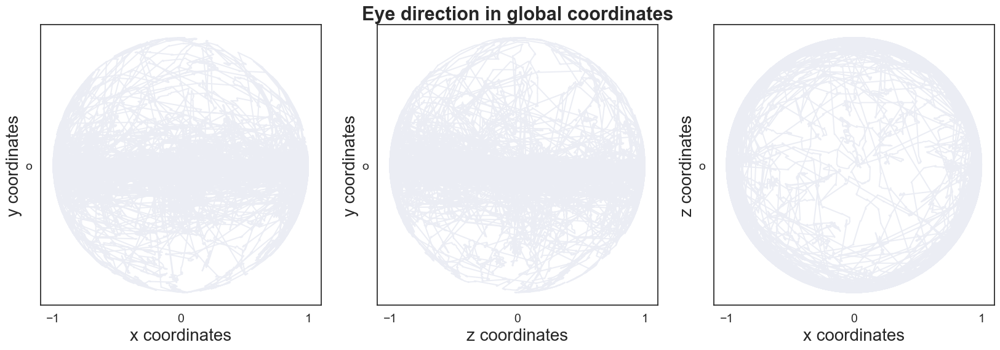

In [34]:
ids = recordings.index.tolist()
idd = ids[:1]

sns.set(rc={"figure.figsize": (20, 6)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, ax = plt.subplots(1, 3) #, constrained_layout=True)

for i, uid in enumerate(idd):
    # load data:
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )


    # get individual coordinates
    # position
    Xcorr_position = for_eye["xcoord_orig"].tolist()
    Ycorr_position = for_eye["ycoord_orig"].tolist()
    Zcorr_position = for_eye["zcoord_orig"].tolist()
    subj = list(zip(Xcorr_position, Ycorr_position, Zcorr_position))

    # hpoo
    hpooX = for_eye["xhpoo"].tolist()
    hpooY = for_eye["yhpoo"].tolist()
    hpooZ = for_eye["zhpoo"].tolist()
    hpoo = list(zip(hpooX, hpooY, hpooZ))

    # gaze_vec(t) is a unit vector in the direction of the gaze (eye+head) in world coordinates
    g_vec = [np.array(hpoo[v] - np.array(subj[v])) for v in range(len(subj))]
    gaze_vec = [np.array(v) / np.linalg.norm(np.array(v)) for v in g_vec]
    # create df to plot
    gaze_vec = pd.DataFrame(gaze_vec, columns=["gvx", "gvy", "gvz"])
    # add it to for_eye so we can differentiate between gaze and saccade
    for_eye = pd.concat([for_eye, gaze_vec], axis=1)

    # separate between gaze and saccade
    gaze = for_eye[~for_eye["isFix"].isnull()]
    sacc = for_eye[for_eye["isFix"].isnull()]
    gaze = gaze[~gaze["long_events"].isnull()]
    sacc = sacc[~sacc["long_events"].isnull()]

    # X vs Y
    ax[0].plot(
        gaze["gvx"].tolist(), gaze["gvy"].tolist(), "#27408B", "o", alpha=0.09
    )
    # ax[0].plot(sacc["gvx"].tolist(), sacc["gvy"].tolist(), "#BA1200", 'o', alpha=0.09)
    # Z vs Y
    ax[1].plot(
        gaze["gvz"].tolist(), gaze["gvy"].tolist(), "#27408B", "o", alpha=0.09
    )
    # ax[1].plot(sacc["gvz"].tolist(), sacc["gvy"].tolist(), "#BA1200", 'o', alpha=0.09)
    # X vs Z
    ax[2].plot(
        gaze["gvx"].tolist(), gaze["gvz"].tolist(), "#27408B", "o", alpha=0.09
    )
    # ax[2].plot(sacc["gvx"].tolist(), sacc["gvz"].tolist(), "#BA1200", 'o', alpha=0.09)

# X vs Y
ax[0].set_xlabel("x coordinates", fontsize=20)
ax[0].set_ylabel("y coordinates", fontsize=20)
ax[0].yaxis.set_tick_params(labelsize=14)  # change tick size
ax[0].xaxis.set_tick_params(labelsize=14)
ax[0].set_xticks([-1, 0, 1])
ax[0].set_yticks([-1, 0, 1])
ax[0].set_xlim(-1.1, 1.1)
ax[0].set_ylim(-1.1, 1.1)
# Z vs Y
ax[1].set_xlabel("z coordinates", fontsize=20)
ax[1].set_ylabel("y coordinates", fontsize=20)
ax[1].yaxis.set_tick_params(labelsize=14)  # change tick size
ax[1].xaxis.set_tick_params(labelsize=14)
ax[1].set_xticks([-1, 0, 1])
ax[1].set_yticks([-1, 0, 1])
ax[1].set_xlim(-1.1, 1.1)
ax[1].set_ylim(-1.1, 1.1)
ax[1].set_title(
    "Eye direction in global coordinates", fontsize=22, fontweight="bold"
)
# X vs Z
ax[2].set_xlabel("x coordinates", fontsize=20)
ax[2].set_ylabel("z coordinates", fontsize=20)
ax[2].yaxis.set_tick_params(labelsize=14)  # change tick size
ax[2].xaxis.set_tick_params(labelsize=14)
ax[2].set_xticks([-2, -1, 0, 1, 2])
#ax[2].set_yticks([-2, -1, 0, 1, 2])
ax[2].set(yticks=([-2, -1, 0, 1, 2]))
ax[2].set_xlim(-1.1, 1.1)
ax[2].set_ylim(-1.1, 1.1)


#plt.suptitle(
#    "The Direction Vector in Global Coordinates (Gaze)",
#    fontsize=22,
#    fontweight="bold",
#)
#plt.axis('square')
ax[0].set_aspect(1.0/ax[0].get_data_ratio(), adjustable='box')
ax[1].set_aspect(1.0/ax[0].get_data_ratio(), adjustable='box')
ax[2].set_aspect(1.0/ax[0].get_data_ratio(), adjustable='box')

# leg = f.legend(
#    ["gaze", "saccade"], loc="upper right", borderaxespad=0.1, fontsize=16
# )
# for lh in leg.legendHandles:
#    lh.set_alpha(1)

plt.show()

/tmp/ipykernel_13055/677569692.py:58: RuntimeWarning: invalid value encountered in true_divide
  sacc_v_norm = [np.array(v) / np.linalg.norm(np.array(v)) for v in sacc_v]
/tmp/ipykernel_13055/677569692.py:58: RuntimeWarning: invalid value encountered in true_divide
  sacc_v_norm = [np.array(v) / np.linalg.norm(np.array(v)) for v in sacc_v]
/tmp/ipykernel_13055/677569692.py:58: RuntimeWarning: invalid value encountered in true_divide
  sacc_v_norm = [np.array(v) / np.linalg.norm(np.array(v)) for v in sacc_v]
/tmp/ipykernel_13055/677569692.py:58: RuntimeWarning: invalid value encountered in true_divide
  sacc_v_norm = [np.array(v) / np.linalg.norm(np.array(v)) for v in sacc_v]
/tmp/ipykernel_13055/677569692.py:58: RuntimeWarning: invalid value encountered in true_divide
  sacc_v_norm = [np.array(v) / np.linalg.norm(np.array(v)) for v in sacc_v]
/tmp/ipykernel_13055/677569692.py:58: RuntimeWarning: invalid value encountered in true_divide
  sacc_v_norm = [np.array(v) / np.linalg.norm(np.a

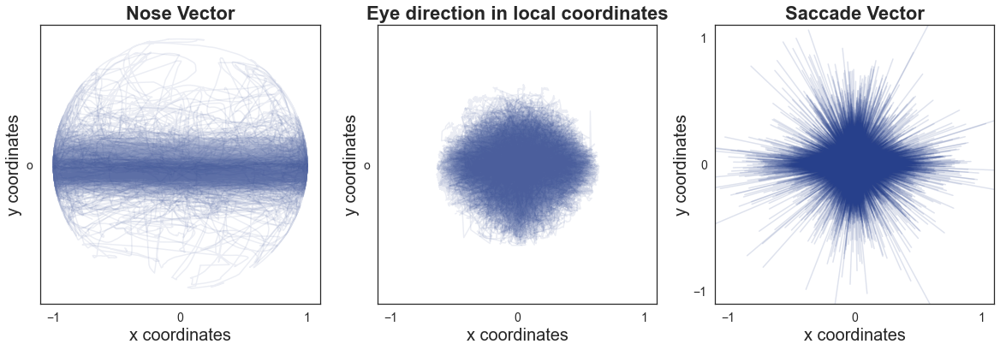

In [42]:
##### 08.03.23
ids = recordings.index.tolist()
idd = ids[:]

sns.set(rc={"figure.figsize": (20, 6)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, ax = plt.subplots(1, 3)


for i, uid in enumerate(idd):
    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )

    # get the corrected coordinates
    # separate between gaze and saccade
    gaze = for_eye[~for_eye["isFix"].isnull()]
    gaze = gaze[~gaze["long_events"].isnull()]

    # get the saccade vectors: (diff between beginning and end of saccade)
    events = [-1.0 if (for_eye["events"][ev - 1] == 1.0 and for_eye["events"][ev] == 2.0)
        else for_eye["events"][ev]
        for ev in for_eye.index.tolist()[2:]
    ]
    events = [for_eye["events"][0]] + [for_eye["events"][1]]  + events
    for_eye["events"] = events
    #for_eye = for_eye[~for_eye["long_events"].isnull()]

    # get the saccade vectors: (diff between beginning and end of saccade)
    sacc_start = for_eye[for_eye["events"] == 1.0]
    sacc_end = for_eye[for_eye["events"] == -1.0]
    #for one subject, the beginning is messed up, so correct it:
    if sacc_end.index[0] < sacc_start.index[0]:
        sacc_end = sacc_end[1:]


    # separate saccades
    sacc = for_eye[for_eye["isFix"].isnull()]

    # now get the diff between beginning and end
    sacc_x = (
        np.array(sacc_start["xcoord"].tolist())
        - np.array(sacc_end["xcoord"].tolist())
    ).tolist()
    sacc_y = (
        np.array(sacc_start["ycoord"].tolist())
        - np.array(sacc_end["ycoord"].tolist())
    ).tolist()
    sacc_z = (
        np.array(sacc_start["zcoord"].tolist())
        - np.array(sacc_end["zcoord"].tolist())
    ).tolist()

    sacc_v = list(zip(sacc_x, sacc_y, sacc_z))
    sacc_v_norm = [np.array(v) / np.linalg.norm(np.array(v)) for v in sacc_v]
    sacc_v_norm_df = pd.DataFrame(sacc_v_norm, columns = ['x', 'y', 'z'])

    # Head:
    ax[0].plot(
        gaze["zhead"].tolist(),
        gaze["yhead"].tolist(),
        "#27408B",
        "o",
        alpha=0.09,
    )
    # local ET data:
    ax[1].plot(
        gaze["xlocal_dir"].tolist(),
        gaze["ylocal_dir"].tolist(),
        "#27408B",
        "o",
        alpha=0.09,
    )
    # sacc vectors:
    for mk in range(len(sacc_x)):
        ax[2].plot([0, sacc_x[mk]], [0, sacc_y[mk]], "#27408B", alpha=0.15)
    # if normalised:
    #for mk in range(len(sacc_x)):
    #    ax[2].plot([0, sacc_v_norm_df.iloc[mk]['x']], [0, sacc_v_norm_df.iloc[mk]['y']], "#4C86A8", alpha=0.003)


# Head
ax[0].set_xlabel("x coordinates", fontsize=20)
ax[0].set_ylabel("y coordinates", fontsize=20)
ax[0].set_title("Nose Vector", fontsize=22, fontweight="bold")
ax[0].set_xticks([-1, 0, 1])
ax[0].set_yticks([-1, 0, 1])
ax[0].yaxis.set_tick_params(labelsize=14)  # change tick size
ax[0].xaxis.set_tick_params(labelsize=14)
ax[0].set_xlim(-1.1, 1.1)
ax[0].set_ylim(-1.1, 1.1)
# Local ET
ax[1].set_xlabel("x coordinates", fontsize=20)
ax[1].set_ylabel("y coordinates", fontsize=20)
ax[1].set_title(
    "Eye direction in local coordinates", fontsize=22, fontweight="bold"
)
ax[1].yaxis.set_tick_params(labelsize=14)  # change tick size
ax[1].xaxis.set_tick_params(labelsize=14)
ax[1].set_xticks([-2, -1, 0, 1, 2])
ax[1].set_yticks([-2, -1, 0, 1, 2])
ax[1].set_xlim(-1.1, 1.1)
ax[1].set_ylim(-1.1, 1.1)
# Sacc Vector
ax[2].set_xlabel("x coordinates", fontsize=20)
ax[2].set_ylabel("y coordinates", fontsize=20)
ax[2].set_title("Saccade Vector", fontsize=22, fontweight="bold")
ax[2].yaxis.set_tick_params(labelsize=14)  # change tick size
ax[2].xaxis.set_tick_params(labelsize=14)
ax[2].set_xticks([-2, -1, 0, 1, 2])
ax[2].set_yticks([-2, -1, 0, 1, 2])
ax[2].set_xlim(-1.1, 1.1)
ax[2].set_ylim(-1.1, 1.1)
ax[0].set_aspect(1.0/ax[0].get_data_ratio(), adjustable='box')
ax[1].set_aspect(1.0/ax[0].get_data_ratio(), adjustable='box')
ax[2].set_aspect(1.0/ax[0].get_data_ratio(), adjustable='box')

#plt.tight_layout()
plt.show()

In [27]:
##### Get the local min and max for x and y
ids = recordings.index.tolist()
idd = ids[:]

max_x = []
max_y = []

for i, uid in enumerate(idd):
    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )
    gaze = for_eye[~for_eye["isFix"].isnull()]
    gaze = gaze[~gaze["long_events"].isnull()]

    abs_x = [abs(ele) for ele in gaze["xlocal_dir"].tolist()]
    abs_y = [abs(ele) for ele in gaze["ylocal_dir"].tolist()]
    max_x = max_x + [np.nanmax(abs_x)]
    max_y = max_y + [np.nanmax(abs_y)]

columns=['max_x','max_y']
df = pd.DataFrame(list(zip(max_x,max_y)),columns=columns,index=idd)
#print(df)
display(df.describe())

print()

scipy.stats.ttest_rel(max_x,max_y)

,max_x,max_y
count,18.000000,18.000000
mean,0.600833,0.578261
std,0.040567,0.053863
min,0.500885,0.450348
25%,0.577961,0.555660
50%,0.616119,0.583412
75%,0.629822,0.627003
max,0.642365,0.637894


Ttest_relResult(statistic=1.6899778713368152, pvalue=0.1092850261906186)

## Distance Distribution

Median gaze distance: 17.015860918253196
Median sacc distance: 16.883785467634723
IQR gaze distance: 4.0782327408867545 (14.726292855105342-18.804525595992096)
IQR sacc distance: 3.933712960901172 (14.730297363506132-18.664010324407304)
KS statistic: 0.0556
P-value: 1.0000


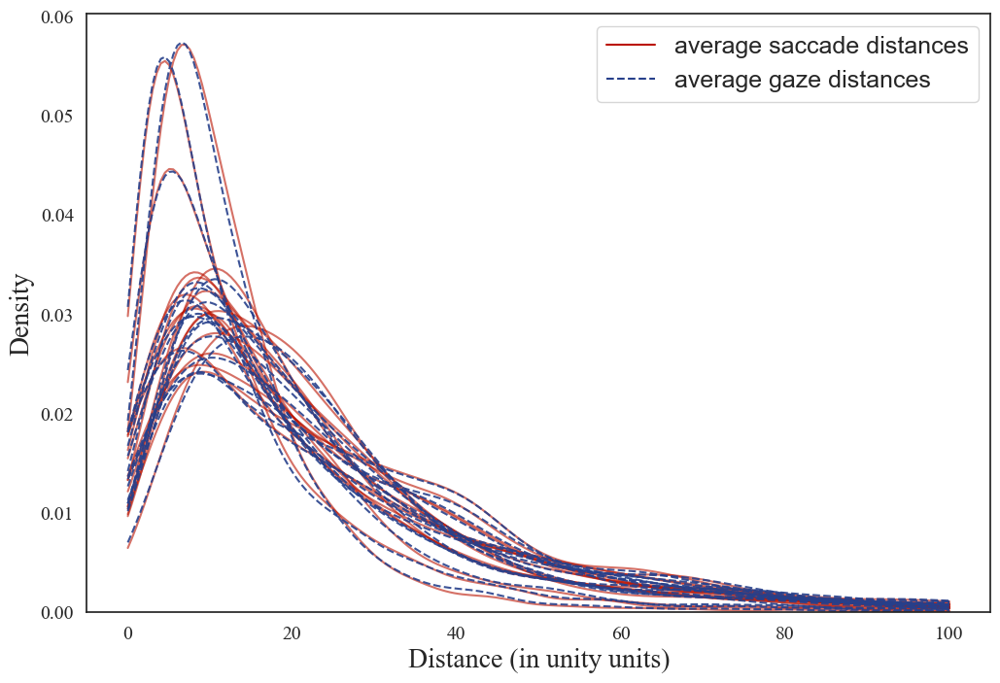

In [30]:
# perform median absolute deviation to find outliers in the event durations
ids = recordings.index.tolist()
idd = ids[:]

gze = []
sac = []

# plot 1: distplot
fig, ax = plt.subplots(figsize=(12, 8))
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}

cnt = 0
for uid in idd:
    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )

    # separate between gaze and saccade
    sacc = for_eye[for_eye["events"] == 1.0]
    # exclude long events
    sacc = sacc[~sacc["long_events"].isnull()]
    #sacc = sacc[~sacc["avg_dist"].isnull()]
    sacc.replace([np.inf, -np.inf], np.nan, inplace=True)



    sac.append(np.nanmedian(sacc["avg_dist"]))

    #display(sacc["avg_dist"].tolist())

    sns.kdeplot(
        sacc["avg_dist"],
        color="#BA1200",
        fill=False,
        # cut = 0,
        clip=[0, 100],
        # bw_adjust=.25,
        alpha=0.6,
        label="average saccade distances",
    )
    # ax.lines[cnt].set_linestyle("--")
    cnt = cnt + 1
for uid in idd:
    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )



    # separate between gaze and saccade
    gaze = for_eye[for_eye["events"] == 2.0]
    # exclude long events
    gaze = gaze[~gaze["long_events"].isnull()]

    gze.append(np.nanmedian(gaze["avg_dist"]))

    sns.kdeplot(
        gaze["avg_dist"],
        color="#27408B",
        fill=False,
        # cut = 0,
        clip=[0, 100],
        # bw_adjust=.25,
        alpha=0.9,
        label="average gaze distances",
    )
    ax.lines[cnt].set_linestyle("--")
    cnt = cnt + 1


# STATs
med_gaze = np.nanmedian(gze)
med_sacc = np.nanmedian(sac)
print(f"Median gaze distance: {med_gaze}")
print(f"Median sacc distance: {med_sacc}")
# Interquartile range:
q75_g, q25_g = np.nanpercentile(gze, [75, 25])
iqr_gaze = q75_g - q25_g
q75_s, q25_s = np.nanpercentile(sac, [75, 25])
iqr_sacc = q75_s - q25_s
print(f"IQR gaze distance: {iqr_gaze} ({q25_g}-{q75_g})")
print(f"IQR sacc distance: {iqr_sacc} ({q25_s}-{q75_s})")
# KS test
statistic, pvalue = ks_2samp(gze, sac)
print(f"KS statistic: {statistic:.4f}")
print(f"P-value: {pvalue:.4f}")

# plt.xlim(0, 200.0)
handles, labels = ax.get_legend_handles_labels()
# plt.legend(["average gaze duration", "average saccade duration"], fontsize=14)
leg = plt.legend(
    [handles[0], handles[-1]],
    [labels[0], labels[-1]],
    loc="upper right",
    fontsize=18,
)
for lh in leg.legend_handles:
    lh.set_alpha(1)
#plt.title(
#    "Distribution of Average Distances per Subject during Events",
#    fontsize=22,
#    fontweight="bold",
#)
ax.set_xlabel("Distance (in unity units)", fontsize=20)
ax.set_ylabel("Density", fontsize=20)
ax.yaxis.set_tick_params(labelsize=14)  # change tick size
ax.xaxis.set_tick_params(labelsize=14)

# ax.set_xlim(0, 200)#510, 635)
plt.show()

## Gazes in Space

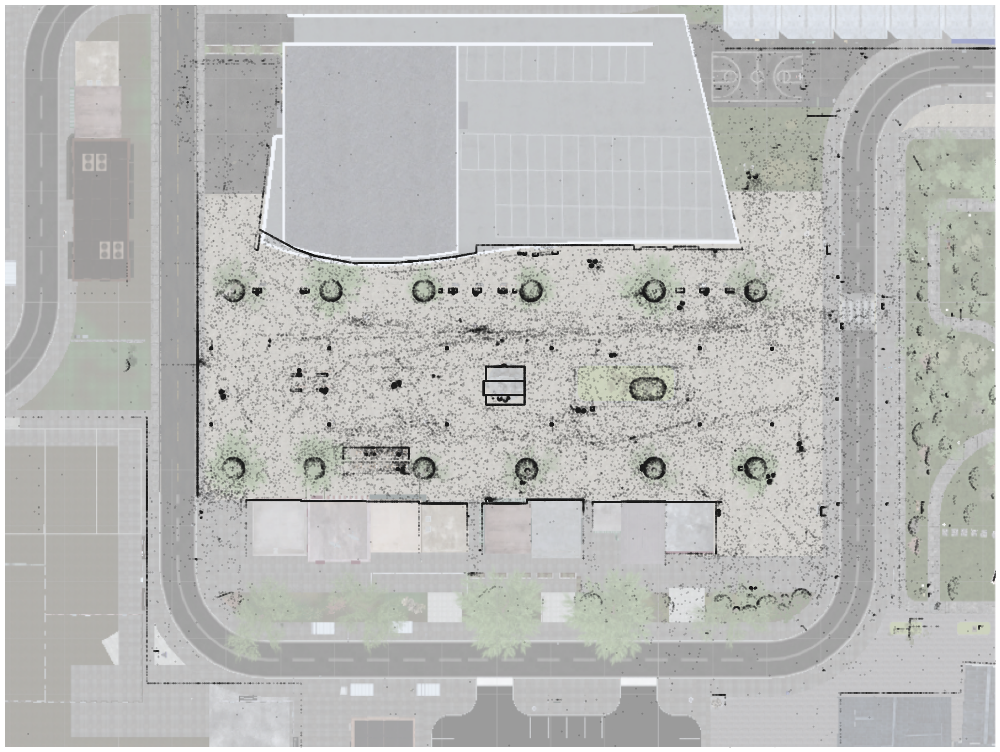

In [54]:
# participants ids
ids = recordings.index.tolist()
idd = ids[:]

min_x = 481
max_x = 661
min_y = 520
max_y = 655

fig, ax = plt.subplots(figsize=(30, 20))
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
img = plt.imread("unity_scene_bird.png")
#ax.imshow(img, extent=[510,660,560,650])
ax.imshow(img, extent=[min_x, max_x, min_y, max_y])
for uid in idd:
    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )

    # only get gazes without nans and wihtout long events
    gaze = for_eye[for_eye["events"] == 2.0]
    gaze = gaze[~gaze["names"].isnull()]
    gaze = gaze[
        ~gaze["long_events"].isnull()
    ]  # this changes nr. of face gazes from 52 to 48

    plt.scatter(
        x=gaze["xhpoo"].tolist(),
        y=gaze["zhpoo"].tolist(),
        color="k",
        marker=".",
        alpha=0.2,
        linewidth=0,
    )  # colors, cmap='viridis')


ax.set(xlabel="X-axis", ylabel="Z-axis")  # label axes
ax.grid(False)
# plt.colorbar()
ax.set_xlim(min_x, max_x)  # 510, 635)
ax.set_ylim(min_y, max_y)  # 550, 625)
ax.axis("off")
# plt.savefig('gaze_pos.png', transparent=True)
plt.show()
#fig.savefig("gaze_pos.png", transparent=True)

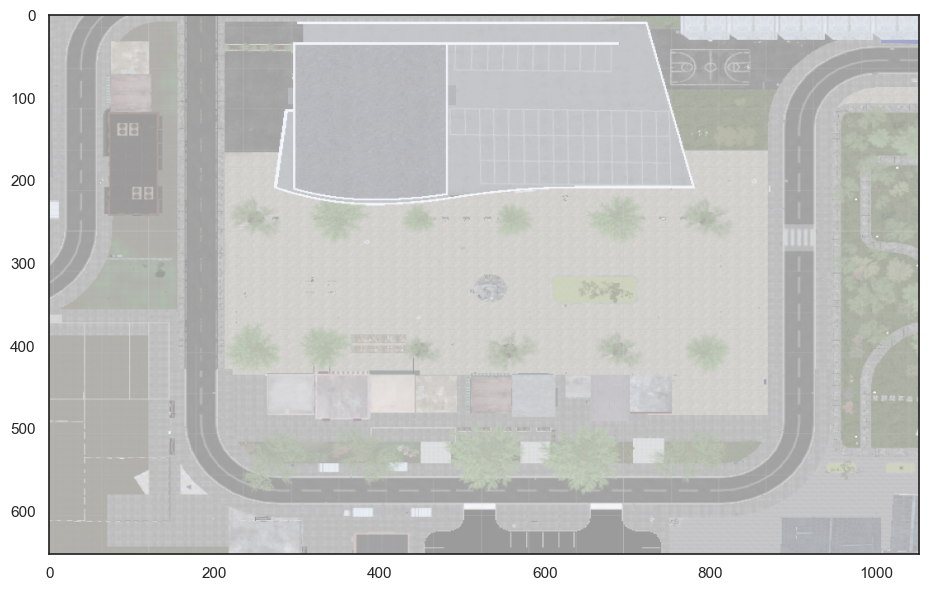

In [33]:
img = plt.imread("unity_scene_bird.png")
x = range(300)
fig, ax = plt.subplots()
ax.imshow(img)


# Data Distribution 

In [107]:
ids = recordings.index.tolist()
idd = ids[:]

stats = {}

for uid in idd:
    stats[uid] = {}
    for fe in range(2):
        # load data
        # 10 sec
        if fe == 0:
            for_eye = pd.read_csv(
                f"{PATH_FOREYE}/correTS__10sec_{uid}.csv", index_col=0
            )
            condition = "10"
        else:
            for_eye = pd.read_csv(
                f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
            )
            condition = "dd"


        gaze = for_eye[for_eye["events"] == 2.0]
        gaze = gaze[~gaze["long_events"].isnull()]

        sacc = for_eye[for_eye["events"] == 1.0]
        sacc = sacc[~sacc["long_events"].isnull()]


        stats[uid][condition + "_gaze"] = gaze.index.size
        stats[uid][condition + "_sacc"] = sacc.index.size

stats = pd.DataFrame(stats).transpose()
print()
print("Number of Events:")
print()

print(f"Median Gaze DD: {np.nanmedian(stats['dd_gaze'])}")
print(f"Median Gaze 10: {np.nanmedian(stats['10_gaze'])}")
print(f"Median Sacc DD: {np.nanmedian(stats['dd_sacc'])}")
print(f"Median Sacc 10: {np.nanmedian(stats['10_sacc'])}")
print()

# Interquartile range:
q75, q25 = np.nanpercentile(stats['dd_gaze'].tolist(), [75, 25])
iqr_gaze_dd = q75 - q25
print(f"IQR gaze DD: {iqr_gaze_dd} ({q25}-{q75})")

q75, q25 = np.nanpercentile(stats['dd_sacc'].tolist(), [75, 25])
iqr_sacc_dd = q75 - q25
print(f"IQR sacc DD: {iqr_sacc_dd} ({q25}-{q75})")

q75_g, q25 = np.nanpercentile(stats['10_gaze'].tolist(), [75, 25])
iqr_gaze_10 = q75 - q25
print(f"IQR gaze 10: {iqr_gaze_10} ({q25}-{q75})")

q75, q25 = np.nanpercentile(stats['10_sacc'].tolist(), [75, 25])
iqr_sacc_10 = q75 - q25
print(f"IQR sacc 10: {iqr_sacc_10} ({q25}-{q75})")
print()

#sns.kdeplot(stats,bw_adjust=.5)

# T-test
#print("T-Test")
#alpha = 0.05
#adjusted_alpha = alpha / 2  # Two tests were performed
#print(f"Adjusted alpha: {adjusted_alpha:.4f}")
#print()
#stat,p1 = ttest_rel(stats['10_gaze'], stats['dd_gaze'])
#print(f"P-value gaze: {p1:.4f}")
#stat,p2 = ttest_rel(stats['10_sacc'], stats['dd_sacc'])
#print(f"P-value sacc: {p2:.4f}")
#print()
#p_values = [p1,p2]
#corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]
#corrected_p_values = [round(pv, 3) for pv in corrected_p_values]
#
#print(f"Corrected p-values: {corrected_p_values}")

print()
print('KS-Test')
alpha = 0.05
adjusted_alpha = alpha / 4  # Two tests were performed
print(f"Adjusted alpha: {adjusted_alpha:.4f}")
print()

statistic, p1 = ks_2samp(stats['10_gaze'].tolist(), stats['dd_gaze'].tolist())
# Apply Bonferroni correction
adjusted_pvalue1 = p1 #* 2  # Multiply by 2 because it's a two-tailed test
print(f"Adjusted p-value gaze: {adjusted_pvalue1:.4f}")
statistic, p2 = ks_2samp(stats['10_sacc'].tolist(), stats['dd_sacc'].tolist())
# Apply Bonferroni correction
adjusted_pvalue2 = p2 #* 2  # Multiply by 2 because it's a two-tailed test
print(f"Adjusted p-value sacc: {adjusted_pvalue2:.4f}")


display(stats)


Number of Events:

Median Gaze DD: 4944.0
Median Gaze 10: 4860.5
Median Sacc DD: 4751.5
Median Sacc 10: 4634.5

IQR gaze DD: 691.0 (4490.25-5181.25)
IQR sacc DD: 491.25 (4437.75-4929.0)
IQR gaze 10: 335.25 (4593.75-4929.0)
IQR sacc 10: 600.5 (4425.5-5026.0)


KS-Test
Adjusted alpha: 0.0125

Adjusted p-value gaze: 0.7810
Adjusted p-value sacc: 0.9715


,10_gaze,10_sacc,dd_gaze,dd_sacc
70656182-09b3-4c19-9ae2-0a2ab2e19fed,4941,4749,4917,4799
d764851f-717d-4944-9023-74dda394f96e,4747,4529,4629,4539
20e8d35c-e7aa-4be3-a6e2-5b78f4cd44d8,4583,4290,4746,4540
d4bf073c-a3cc-450c-9412-ef15538ee293,5844,5631,5645,5533
caf93a54-5b95-4c55-ace9-619a0ca2dd98,5583,5335,5390,5162
e28fbd3e-516f-4c89-bc54-3cb32ddd5ef7,5316,4852,5191,4914
fdc06350-e1bb-4630-9d23-6631bb0a9498,4759,4562,4726,4658
61c0f1aa-b3ef-497b-8b6e-8ec6f05f6c42,4199,3872,4075,3816
391543f6-7ff0-4ed3-aefd-c0ef68ebbbf3,5429,5067,5152,4839
95184b7a-42f1-40b0-ae36-be6ef1e33f1d,5004,4707,4984,4873


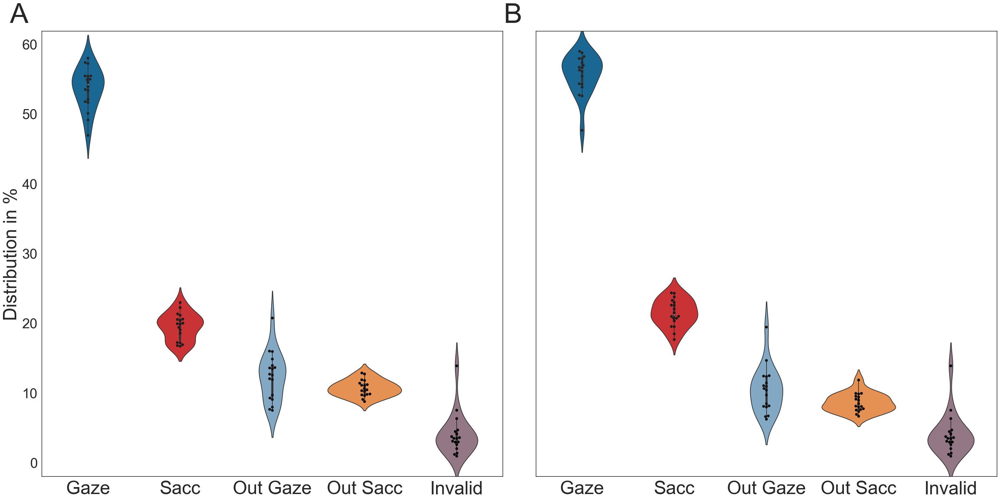

In [8]:
######## APA Style!!! ########

# % gaze, sacc, outliers, missing values
ids = recordings.index.tolist()
idd = ids[:]

sns.set(rc={"figure.figsize": (30, 15)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, (ax) = plt.subplots(1, 2, sharey=True, constrained_layout=True)

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Arial" # font name
plt.rcParams["font.family"] = fname

for fe in range(2):
    nr_gaze = []
    nr_sacc = []
    nr_gz_out = []
    nr_sc_out = []
    #nr_out = []
    non_val = []
    total_nr = []
    stats = {}
    for uid in idd:
        # load data
        # 10 sec
        if fe == 0:
            for_eye = pd.read_csv(
                f"{PATH_FOREYE}/correTS__10sec_{uid}.csv", index_col=0
            )
            condition = "10-Second Intervals"
        else:
            for_eye = pd.read_csv(
                f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
            )
            condition = "Data driven intervals"

        total = for_eye.index.size

        outbig = for_eye[for_eye["valid"] == 0.0]
        for_eye = for_eye[for_eye["valid"] == 1.0]

        #outl = for_eye[for_eye["long_events"].isnull()]

        gaze = for_eye[~for_eye["isFix"].isnull()]
        sacc = for_eye[for_eye["isFix"].isnull()]

        gaze_out = gaze[gaze["long_events"].isnull()]
        sacc_out = sacc[sacc["long_events"].isnull()]
        gaze = gaze[~gaze["long_events"].isnull()]
        sacc = sacc[~sacc["long_events"].isnull()]

        nr_gaze = nr_gaze + [gaze.index.size * 100 / total]
        nr_sacc = nr_sacc + [sacc.index.size * 100 / total]
        nr_gz_out = nr_gz_out + [gaze_out.index.size * 100 / total]
        nr_sc_out = nr_sc_out + [sacc_out.index.size * 100 / total]
        #nr_out = nr_out + [outl.index.size * 100 / total]
        non_val = non_val + [outbig.index.size * 100 / total]

        total_nr = total_nr + [gaze.index.size * 100 / total + sacc.index.size * 100 / total + gaze_out.index.size * 100 / total + sacc_out.index.size * 100 
                               / total + outbig.index.size * 100 / total]

    stats["Gaze"] = nr_gaze
    stats["Sacc"] = nr_sacc
    stats["Out Gaze"] = nr_gz_out
    stats["Out Sacc"] = nr_sc_out
    stats["Invalid"] = non_val
    stats["Total"] = total_nr

    stats = pd.DataFrame(stats)
    #display(stats)
    plt.subplot(1, 2, fe + 1)
    
    pallet = {
        "Gaze": gaze_color_1,
        "Sacc": sacc_color_1,
        "Out Gaze": gaze_color_2,
        "Out Sacc": sacc_color_2,
        "Invalid": colliders_color,
    }

    sns.violinplot(
        data=stats[
            ["Gaze", "Sacc","Out Gaze", "Out Sacc", "Invalid"]
        ],
        palette=pallet,
        orient="v",
        inner="box",
        alpha=0.2,
    )
    sns.swarmplot(
        data=stats[
            ["Gaze", "Sacc","Out Gaze", "Out Sacc", "Invalid"]
        ],
        color="black",
        marker="o",
        size=6,
        #alpha=0.7,
    )  # stripplot

    if fe == 0:
        ax[fe].set_ylabel("Distribution in %", fontsize=labelsize, fontname=fname)
    
    for label in ax[fe].get_xticklabels(): # change tick font
        label.set_fontproperties(fname)
    for label in ax[fe].get_yticklabels():
        label.set_fontproperties(fname)
    ax[fe].xaxis.set_tick_params(labelsize=labelsize)  # change tick size
    ax[fe].yaxis.set_tick_params(labelsize=ticksize)  # change tick size

    # plt.tight_layout()
ax[0].set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname)
ax[1].set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname)

#ax[0].set_facecolor(ten_thres_color)
#ax[0].patch.set_alpha(0.07)

plt.show()

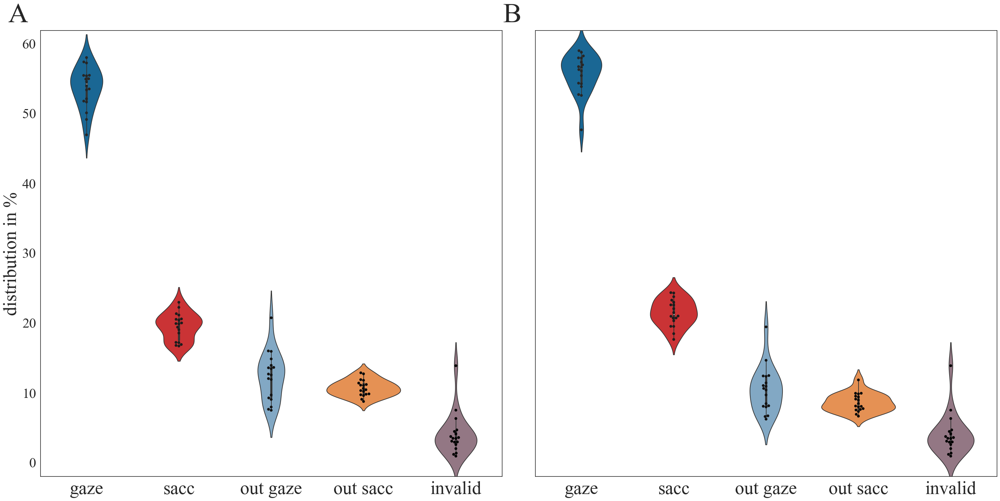

In [6]:
##### 14.03.23
# % gaze, sacc, outliers, missing values
ids = recordings.index.tolist()
idd = ids[:]

sns.set(rc={"figure.figsize": (30, 15)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, (ax) = plt.subplots(1, 2, sharey=True, constrained_layout=True)

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Times New Roman" # font name
plt.rcParams["font.family"] = fname

for fe in range(2):
    nr_gaze = []
    nr_sacc = []
    nr_gz_out = []
    nr_sc_out = []
    #nr_out = []
    non_val = []
    total_nr = []
    stats = {}
    for uid in idd:
        # load data
        # 10 sec
        if fe == 0:
            for_eye = pd.read_csv(
                f"{PATH_FOREYE}/correTS__10sec_{uid}.csv", index_col=0
            )
            condition = "10 second intervals"
        else:
            for_eye = pd.read_csv(
                f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
            )
            condition = "Data driven intervals"

        total = for_eye.index.size

        outbig = for_eye[for_eye["valid"] == 0.0]
        for_eye = for_eye[for_eye["valid"] == 1.0]

        #outl = for_eye[for_eye["long_events"].isnull()]

        gaze = for_eye[~for_eye["isFix"].isnull()]
        sacc = for_eye[for_eye["isFix"].isnull()]

        gaze_out = gaze[gaze["long_events"].isnull()]
        sacc_out = sacc[sacc["long_events"].isnull()]
        gaze = gaze[~gaze["long_events"].isnull()]
        sacc = sacc[~sacc["long_events"].isnull()]

        nr_gaze = nr_gaze + [gaze.index.size * 100 / total]
        nr_sacc = nr_sacc + [sacc.index.size * 100 / total]
        nr_gz_out = nr_gz_out + [gaze_out.index.size * 100 / total]
        nr_sc_out = nr_sc_out + [sacc_out.index.size * 100 / total]
        #nr_out = nr_out + [outl.index.size * 100 / total]
        non_val = non_val + [outbig.index.size * 100 / total]

        total_nr = total_nr + [gaze.index.size * 100 / total + sacc.index.size * 100 / total + gaze_out.index.size * 100 / total + sacc_out.index.size * 100 
                               / total + outbig.index.size * 100 / total]

    stats["gaze"] = nr_gaze
    stats["sacc"] = nr_sacc
    stats["out gaze"] = nr_gz_out
    stats["out sacc"] = nr_sc_out
    stats["invalid"] = non_val
    stats["total"] = total_nr

    stats = pd.DataFrame(stats)
    #display(stats)
    plt.subplot(1, 2, fe + 1)
    
    pallet = {
        "gaze": gaze_color_1,
        "sacc": sacc_color_1,
        "out gaze": gaze_color_2,
        "out sacc": sacc_color_2,
        "invalid": colliders_color,
    }

    sns.violinplot(
        data=stats[
            ["gaze", "sacc","out gaze", "out sacc", "invalid"]
        ],
        palette=pallet,
        orient="v",
        inner="box",
        alpha=0.2,
    )
    sns.swarmplot(
        data=stats[
            ["gaze", "sacc","out gaze", "out sacc", "invalid"]
        ],
        color="black",
        marker="o",
        size=6,
        #alpha=0.7,
    )  # stripplot

    if fe == 0:
        ax[fe].set_ylabel("distribution in %", fontsize=labelsize, fontname=fname)
    
    for label in ax[fe].get_xticklabels(): # change tick font
        label.set_fontproperties(fname)
    for label in ax[fe].get_yticklabels():
        label.set_fontproperties(fname)
    ax[fe].xaxis.set_tick_params(labelsize=labelsize)  # change tick size
    ax[fe].yaxis.set_tick_params(labelsize=ticksize)  # change tick size

    # plt.tight_layout()
ax[0].set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname)
ax[1].set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname)

#ax[0].set_facecolor(ten_thres_color)
#ax[0].patch.set_alpha(0.07)

plt.show()

In [17]:
### Check if there is a statistical significnace between them
print("% of events and outliers")
print()

ids = recordings.index.tolist()
idd = ids[:]

for fe in range(2):
    nr_gaze = []
    nr_sacc = []
    nr_gz_out = []
    nr_sc_out = []
    non_val = []
    total_nr = []
    nr_out = []
    if fe == 0:
        stats_10 = {}
        condition = "10 second intervals"
    else:
        stats_dd = {}
        condition = "Data driven intervals"
    mean_std = {}
    for uid in idd:
        # load data
        # 10 sec
        if fe == 0:
            for_eye = pd.read_csv(
                f"{PATH_FOREYE}/correTS__10sec_{uid}.csv", index_col=0
            )
        else:
            for_eye = pd.read_csv(
                f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
            )

        total = for_eye.index.size

        outbig = for_eye[for_eye["valid"] == 0.0]
        for_eye = for_eye[for_eye["valid"] == 1.0]

        outl = for_eye[for_eye["long_events"].isnull()]

        gaze = for_eye[~for_eye["isFix"].isnull()]
        sacc = for_eye[for_eye["isFix"].isnull()]

        gaze_out = gaze[gaze["long_events"].isnull()]
        sacc_out = sacc[sacc["long_events"].isnull()]
        gaze = gaze[~gaze["long_events"].isnull()]
        sacc = sacc[~sacc["long_events"].isnull()]

        nr_gaze = nr_gaze + [gaze.index.size * 100 / total]
        nr_sacc = nr_sacc + [sacc.index.size * 100 / total]
        nr_gz_out = nr_gz_out + [gaze_out.index.size * 100 / total]
        nr_sc_out = nr_sc_out + [sacc_out.index.size * 100 / total]
        nr_out = nr_out + [outbig.index.size * 100 / total + gaze_out.index.size * 100 / total + sacc_out.index.size * 100 / total]
        
        non_val = non_val + [outbig.index.size * 100 / total]

        total_nr = total_nr + [gaze.index.size * 100 / total + sacc.index.size * 100 / total + gaze_out.index.size * 100 / total + sacc_out.index.size * 100 / total + outbig.index.size * 100 / total]

    # now get a df for mean + std across all subjects:
    mean_std['mean'] = {}
    mean_std['std'] = {}
    mean_std['mean']['nr_gaze'] = np.mean(nr_gaze)
    mean_std['std']['nr_gaze'] = np.std(nr_gaze)
    mean_std['mean']['nr_sacc'] = np.mean(nr_sacc)
    mean_std['std']['nr_sacc'] = np.std(nr_sacc)
    mean_std['mean']['nr_gz_out'] = np.mean(nr_gz_out)
    mean_std['std']['nr_gz_out'] = np.std(nr_gz_out)
    mean_std['mean']['nr_sc_out'] = np.mean(nr_sc_out)
    mean_std['std']['nr_sc_out'] = np.std(nr_sc_out)
    mean_std['mean']['nr_out'] = np.mean(nr_out)
    mean_std['std']['nr_out'] = np.std(nr_out)
    mean_std['mean']['non_val'] = np.mean(non_val)
    mean_std['std']['non_val'] = np.std(non_val)
    mean_std = pd.DataFrame(mean_std)
    #display(mean_std.transpose())

    print(f"% events and outliers - {condition}")
    print()

    # Gaze
    print(f"Median % Gaze: {np.nanmedian(nr_gaze)}")
    q75, q25 = np.nanpercentile(nr_gaze, [75, 25])
    iqr = q75 - q25
    print(f"IQR % Gaze: {iqr} ({q25}-{q75})")
    # Sacc
    print(f"Median % Sacc: {np.nanmedian(nr_sacc)}")
    q75, q25 = np.nanpercentile(nr_sacc, [75, 25])
    iqr = q75 - q25
    print(f"IQR % Sacc: {iqr} ({q25}-{q75})")
    # Gaze_out
    print(f"Median % Gaze_out: {np.nanmedian(nr_gz_out)}")
    q75, q25 = np.nanpercentile(nr_gz_out, [75, 25])
    iqr = q75 - q25
    print(f"IQR % Gaze_out: {iqr} ({q25}-{q75})")
    # Sacc_out
    print(f"Median % Sacc_out: {np.nanmedian(nr_sc_out)}")
    q75, q25 = np.nanpercentile(nr_sc_out, [75, 25])
    iqr = q75 - q25
    print(f"IQR % Sacc_out: {iqr} ({q25}-{q75})")
    print(f"Median % Total Outliers: {np.nanmedian(nr_out)}")
    print()


    if fe == 0:
        stats_10["Gaze"] = nr_gaze
        stats_10["Sacc"] = nr_sacc
        stats_10["Out Gaze"] = nr_gz_out
        stats_10["Out Sacc"] = nr_sc_out
        stats_10["Invalid"] = non_val
        stats_10["Total"] = total_nr
        stats_10["total_out"] = nr_out
        stats_10 = pd.DataFrame(stats_10)
        #display(stats_10)
    else:
        stats_dd["Gaze"] = nr_gaze
        stats_dd["Sacc"] = nr_sacc
        stats_dd["Out Gaze"] = nr_gz_out
        stats_dd["Out Sacc"] = nr_sc_out
        stats_dd["Invalid"] = non_val
        stats_dd["Total"] = total_nr
        stats_dd["total_out"] = nr_out
        stats_dd = pd.DataFrame(stats_dd)
        #display(stats_dd)


# Invalid
print(f"Median % Invalid: {np.nanmedian(non_val)}")
# Interquartile range:
q75, q25 = np.nanpercentile(non_val, [75, 25])
iqr = q75 - q25
print(f"IQR % Invalid: {iqr} ({q25}-{q75})")
print()

alpha = 0.05
adjusted_alpha = alpha / 4  # Four tests were performed
print(f"Adjusted alpha: {adjusted_alpha:.4f}")
print()

for column in stats_dd:
    if column not in ['Invalid', 'Total', 'total_out']:
        statistic, pvalue = ks_2samp(stats_10[column], stats_dd[column])
        # Apply Bonferroni correction
        adjusted_pvalue = pvalue * 2  # Multiply by 2 because it's a two-tailed test
        # Print the adjusted p-values
        if adjusted_pvalue <= adjusted_alpha:
            print(f"Adjusted p-value {column}: {adjusted_pvalue:.4f} - this test is significant after Bonferroni correction")
        else:
            print(f"Adjusted p-value {column}: {adjusted_pvalue:.4f}")


% of events and outliers

% events and outliers - 10 second intervals

Median % Gaze: 54.206762143860175
IQR % Gaze: 3.58224694322827 (51.81650937186258-55.39875631509085)
Median % Sacc: 19.854884942004873
IQR % Sacc: 3.013024989944057 (17.512586592012553-20.52561158195661)
Median % Gaze_out: 12.57947812848317
IQR % Gaze_out: 4.489432512515831 (9.327961005357395-13.817393517873226)
Median % Sacc_out: 10.491394678887495
IQR % Sacc_out: 1.5359896835234057 (9.762850085089974-11.29883976861338)
Median % Total Outliers: 26.407225054671613

% events and outliers - Data driven intervals

Median % Gaze: 56.408672064011704
IQR % Gaze: 3.5282259970882777 (54.23414486320854-57.76237086029682)
Median % Sacc: 21.199940784909735
IQR % Sacc: 2.471744198237669 (20.367499674595795-22.839243872833464)
Median % Gaze_out: 10.471007931667002
IQR % Gaze_out: 4.0320221836148775 (8.047577779492757-12.079599963107635)
Median % Sacc_out: 8.232922391212766
IQR % Sacc_out: 1.8480755884815752 (7.601565940876454-9.

In [19]:
10.471007931667002 + 8.232922391212766 + 3.4276482756642723

22.13157859854404

# Event Durations

data-driven interval
Median gaze duration: 0.014879941940307615
Median sacc duration: 0.01885008811950684
IQR gaze duration: 0.0 (0.014879941940307615-0.014879941940307615)
IQR sacc duration: 0.0 (0.01885008811950684-0.01885008811950684)

KS statistic: 1.0000
P-value: 1.0000
Alpha: 0.0500
P-value: 2.0000
Mean gaze duration: 0.014879941940307615; std: 0.0
Mean sacc duration: 0.01885008811950684; std: 0.0



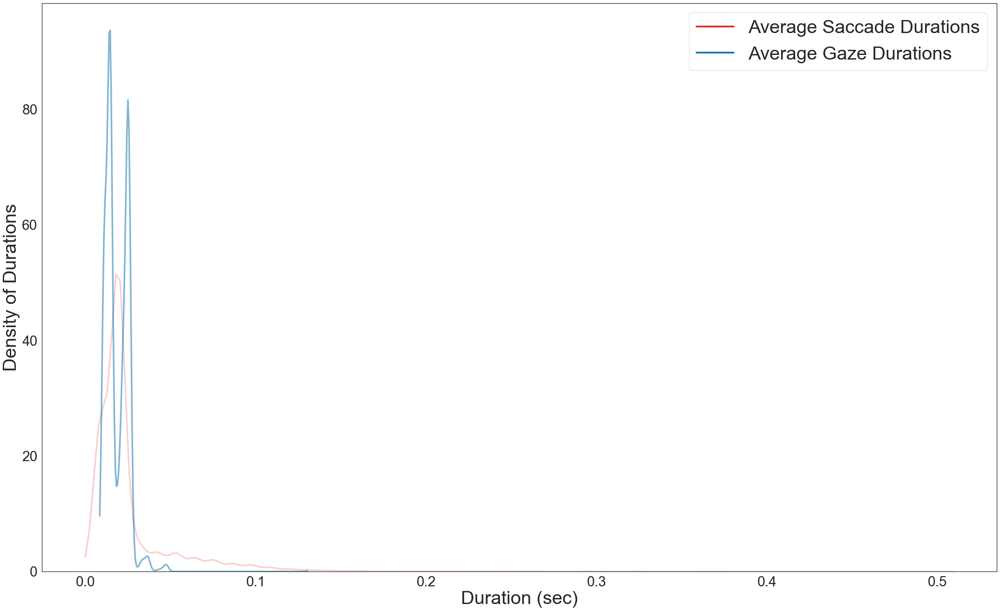

In [18]:
######## APA Style!!! ########

from scipy.stats import ks_2samp



# plot 1: distplot
sns.set(rc={"figure.figsize": (30,20)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, (axis) = plt.subplots(1, 1, sharey=True,)


labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Arial" # font name
plt.rcParams["font.family"] = fname

gze = []
sac = []

# print('start')
# # useful overviews
# noFilePartList = [len(PartList)]
# missingFiles = pd.DataFrame(columns=['Participant', 'Session'])


# for indexPart, currentPart in enumerate(PartList):
# #     currentPart = PartList[indexPart]
#     print(f'Participant {indexPart} - participant ID {currentPart}')
    
#     sessions = list(range(1,6))

    
#     # loop over recording sessions (should be 5 for each participant)
# #     for indexSess in range(1, 6):
# #     for indexSess in range(1, 2):
#     for indexSess in sessions:

#         # get all eye tracking sessions and loop over them (amount of ET files can vary)
#         fileNames = [f for f in os.listdir(data_savepath_processed_gazes) if f.startswith(f'{currentPart}_Session_{indexSess}') and f.endswith('_data_processed_gazes.csv')]
# #         print(dirSess)
# #         print(f'Session {indexSess}')
        
#         if len(fileNames)< 3:
#             hMF = pd.DataFrame({'Participant': [currentPart], 'Session': [indexSess], 'onlyExistingFilesInSession': [fileNames]})
#             missingFiles = pd.concat([missingFiles, hMF], ignore_index=True)
            

#         for file in fileNames:

######################################################
file= "1004_Session_1_ET_1_data_correTS_mad_wobig.csv"
# data = pd.read_csv(os.path.join(data_savepath_processed_gazes, file))    
data = pd.read_csv(os.path.join(data_savepath_intermediateP, file))  

c = sacc_color_1
l = "Average Saccade Durations"

# separate between gaze and saccade
sacc = data[data["events"] == 1.0]
# exclude long events
# sacc = sacc[~sacc["long_events"].isnull()]

sac.append(np.nanmedian(sacc["length"]))
#plt.subplot(2,1, fe+1)
sns.kdeplot(
    sacc["length"],
    color=c,
    fill=False,
    alpha=0.2,
    # cut = 0,
    clip=[0, 1],
    linewidth=3.5,
    # bw_adjust=.25,
    label=l,
)  # cut is used to only show real data, clip to only show the curve between the values 0 and 1

######################################################



# print('start')
# # useful overviews
# noFilePartList = [len(PartList)]
# missingFiles = pd.DataFrame(columns=['Participant', 'Session'])


# for indexPart, currentPart in enumerate(PartList):
# #     currentPart = PartList[indexPart]
#     print(f'Participant {indexPart} - participant ID {currentPart}')
    
#     sessions = list(range(1,6))

    
#     # loop over recording sessions (should be 5 for each participant)
# #     for indexSess in range(1, 6):
# #     for indexSess in range(1, 2):
#     for indexSess in sessions:

#         # get all eye tracking sessions and loop over them (amount of ET files can vary)
#         fileNames = [f for f in os.listdir(data_savepath_processed_gazes) if f.startswith(f'{currentPart}_Session_{indexSess}') and f.endswith('_data_processed_gazes.csv')]
# #         print(dirSess)
# #         print(f'Session {indexSess}')
        
#         if len(fileNames)< 3:
#             hMF = pd.DataFrame({'Participant': [currentPart], 'Session': [indexSess], 'onlyExistingFilesInSession': [fileNames]})
#             missingFiles = pd.concat([missingFiles, hMF], ignore_index=True)
            

#         for file in fileNames:

#####################################
# read in data
file= "1004_Session_1_ET_1_data_correTS_mad_wobig.csv"
# data = pd.read_csv(os.path.join(data_savepath_processed_gazes, file))    
data = pd.read_csv(os.path.join(data_savepath_intermediateP, file))  

c = gaze_color_1
l = "Average Gaze Durations"

# separate between gaze and saccade
gaze = data[data["events"] == 2.0]
# exclude long events
# gaze = gaze[~gaze["long_events"].isnull()]

gze.append(np.nanmedian(gaze["length"]))
#plt.subplot(2,1, fe+1)
sns.kdeplot(
    gaze["length"],
    color=c,
    fill=False,
    alpha=0.5,
    cut = 0,
    clip=[0, 1],
    linewidth=3.5,
    # bw_adjust=.25,
    label=l,
)

###########################################


print("data-driven interval")
# as they are not completely normally distributed, we will use median to get the average results:
med_gaze = np.nanmedian(gze)
med_sacc = np.nanmedian(sac)
print(f"Median gaze duration: {med_gaze}")
print(f"Median sacc duration: {med_sacc}")
# Interquartile range:
q75_g, q25_g = np.nanpercentile(gze, [75, 25])
iqr_gaze = q75_g - q25_g
q75_s, q25_s = np.nanpercentile(sac, [75, 25])
iqr_sacc = q75_s - q25_s
print(f"IQR gaze duration: {iqr_gaze} ({q25_g}-{q75_g})")
print(f"IQR sacc duration: {iqr_sacc} ({q25_s}-{q75_s})")

# Perform the KS test
print()
statistic, pvalue = ks_2samp(gze, sac)
print(f"KS statistic: {statistic:.4f}")
print(f"P-value: {pvalue:.4f}")
# Apply Bonferroni correction
alpha = 0.05
adjusted_pvalue = pvalue *2  # Multiply by 2 because it's a two-tailed test
# Print the adjusted p-values
print(f"Alpha: {alpha:.4f}")
print(f"P-value: {adjusted_pvalue:.4f}")
# Now also get the mean to compare to other studies:
mean_gaze = np.nanmean(gze)
mean_sacc = np.nanmean(sac)
std_gaze = np.std(gze)
std_sacc = np.std(sac)
print(f"Mean gaze duration: {mean_gaze}; std: {std_gaze}")
print(f"Mean sacc duration: {mean_sacc}; std: {std_sacc}")
print()



# plt.xlim(0, 200.0)
handles, labels = axis.get_legend_handles_labels()

leg = axis.legend([handles[0], handles[-1]],
                [labels[0], labels[-1]],
                loc="upper right", fontsize=legendsize)#

for lh in leg.legendHandles:
    lh.set_alpha(1)

#plt.title(
#    "Data-Driven Intervals", fontsize=20, fontweight="bold"
#)



axis.set_xlabel("Duration (sec)", fontsize=labelsize, fontname=fname)
axis.set_ylabel("Density of Durations", fontsize=labelsize, fontname=fname)
for label in axis.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in axis.get_yticklabels():
    label.set_fontproperties(fname)
axis.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
axis.xaxis.set_tick_params(labelsize=ticksize)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

data-driven interval
Median gaze duration: 0.17850000000004934
Median sacc duration: 0.0670000000000072
IQR gaze duration: 0.019999999999905427 (0.17725000000008603-0.19724999999999146)
IQR sacc duration: 5.329070518200751e-15 (0.06700000000000188-0.0670000000000072)

KS statistic: 1.0000
P-value: 0.0000
Alpha: 0.0500
P-value: 0.0000
Mean gaze duration: 0.1847222222222401; std: 0.01398334547298446
Mean sacc duration: 0.068972222222214; std: 0.005437708417978209



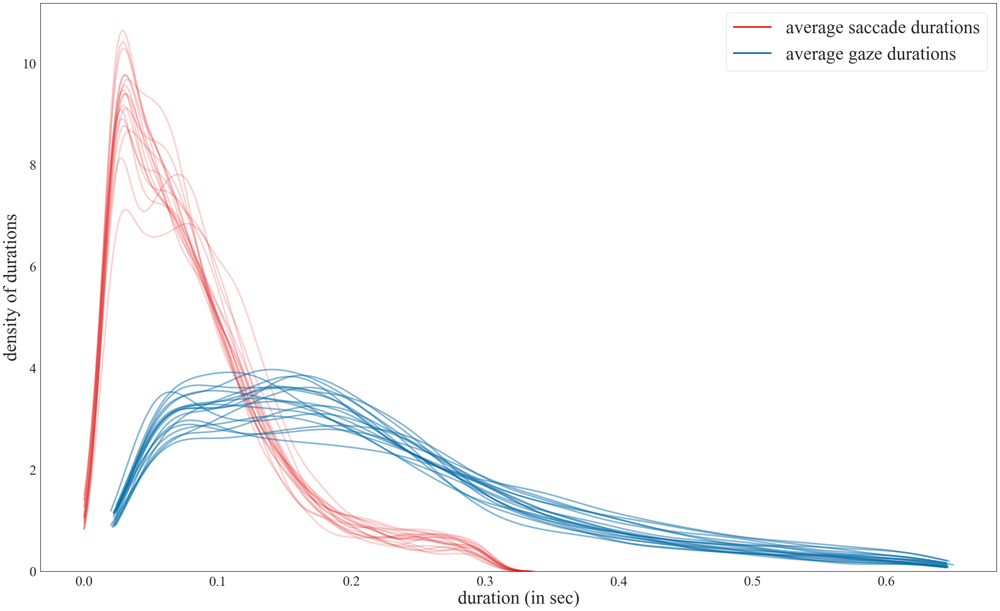

In [251]:
from scipy.stats import ks_2samp

# plot the data without outliers across all subject
ids = recordings.index.tolist()
idd = ids[:]


# plot 1: distplot
sns.set(rc={"figure.figsize": (30,20)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, (axis) = plt.subplots(1, 1, sharey=True,)


labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Times New Roman" # font name
plt.rcParams["font.family"] = fname

gze = []
sac = []
for uid in idd:
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )
    c = sacc_color_1
    l = "average saccade durations"

    # separate between gaze and saccade
    sacc = for_eye[for_eye["events"] == 1.0]
    # exclude long events
    sacc = sacc[~sacc["long_events"].isnull()]

    sac.append(np.nanmedian(sacc["length"]))
    #plt.subplot(2,1, fe+1)
    sns.kdeplot(
        sacc["length"],
        color=c,
        fill=False,
        alpha=0.2,
        # cut = 0,
        clip=[0, 1],
        linewidth=3.5,
        # bw_adjust=.25,
        label=l,
    )  # cut is used to only show real data, clip to only show the curve between the values 0 and 1


for uid in idd:
    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )
    c = gaze_color_1
    l = "average gaze durations"

    # separate between gaze and saccade
    gaze = for_eye[for_eye["events"] == 2.0]
    # exclude long events
    gaze = gaze[~gaze["long_events"].isnull()]

    gze.append(np.nanmedian(gaze["length"]))
    #plt.subplot(2,1, fe+1)
    sns.kdeplot(
        gaze["length"],
        color=c,
        fill=False,
        alpha=0.5,
        cut = 0,
        clip=[0, 1],
        linewidth=3.5,
        # bw_adjust=.25,
        label=l,
    )

print("data-driven interval")
# as they are not completely normally distributed, we will use median to get the average results:
med_gaze = np.nanmedian(gze)
med_sacc = np.nanmedian(sac)
print(f"Median gaze duration: {med_gaze}")
print(f"Median sacc duration: {med_sacc}")
# Interquartile range:
q75_g, q25_g = np.nanpercentile(gze, [75, 25])
iqr_gaze = q75_g - q25_g
q75_s, q25_s = np.nanpercentile(sac, [75, 25])
iqr_sacc = q75_s - q25_s
print(f"IQR gaze duration: {iqr_gaze} ({q25_g}-{q75_g})")
print(f"IQR sacc duration: {iqr_sacc} ({q25_s}-{q75_s})")

# Perform the KS test
print()
statistic, pvalue = ks_2samp(gze, sac)
print(f"KS statistic: {statistic:.4f}")
print(f"P-value: {pvalue:.4f}")
# Apply Bonferroni correction
alpha = 0.05
adjusted_pvalue = pvalue *2  # Multiply by 2 because it's a two-tailed test
# Print the adjusted p-values
print(f"Alpha: {alpha:.4f}")
print(f"P-value: {adjusted_pvalue:.4f}")
# Now also get the mean to compare to other studies:
mean_gaze = np.nanmean(gze)
mean_sacc = np.nanmean(sac)
std_gaze = np.std(gze)
std_sacc = np.std(sac)
print(f"Mean gaze duration: {mean_gaze}; std: {std_gaze}")
print(f"Mean sacc duration: {mean_sacc}; std: {std_sacc}")
print()



# plt.xlim(0, 200.0)
handles, labels = axis.get_legend_handles_labels()

leg = axis.legend([handles[0], handles[-1]],
                [labels[0], labels[-1]],
                loc="upper right", fontsize=legendsize)#

for lh in leg.legendHandles:
    lh.set_alpha(1)

#plt.title(
#    "Data-Driven Intervals", fontsize=20, fontweight="bold"
#)



axis.set_xlabel("duration (in sec)", fontsize=labelsize, fontname=fname)
axis.set_ylabel("density of durations", fontsize=labelsize, fontname=fname)
for label in axis.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in axis.get_yticklabels():
    label.set_fontproperties(fname)
axis.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
axis.xaxis.set_tick_params(labelsize=ticksize)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

# Velocity distribution in relation to gaze onset

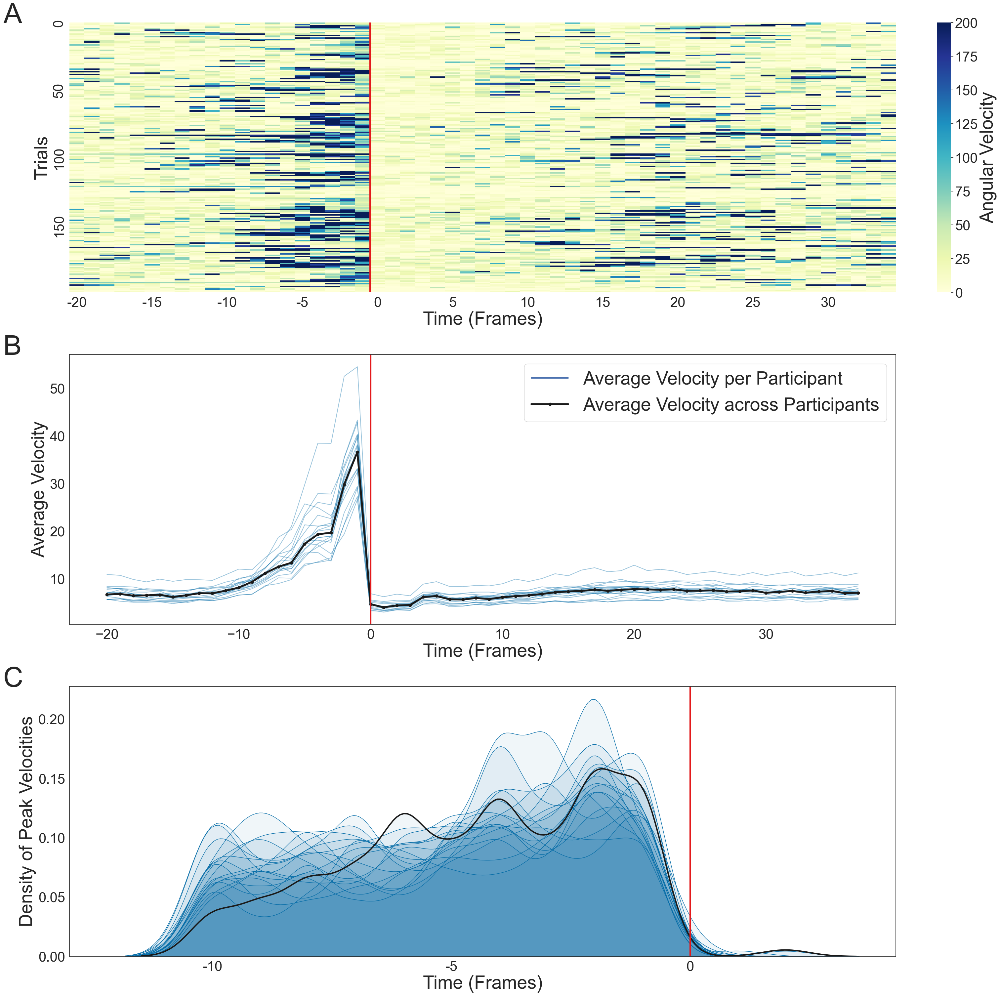

In [10]:
######## APA Style!!! ########

ids = recordings.index.tolist()
idd = ids[:]

start_fr = 20  # how many frames before gaze onset
end_fr = 35  # how many frames to include after gaze onset
data = {} # save data
trials_all = []
start_fr_peak = 10  # how many frames before gaze onset
max_vels_all = {}
max_vels_all['max_vels'] = {}



sns.set(rc={"figure.figsize": (30, 30)})
sns.set_style("white")  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, (ax) = plt.subplots(3,1, constrained_layout=True)

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Arial" # font name
plt.rcParams["font.family"] = fname

for i, uid in enumerate(idd):
    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )
    condition = "Data driven intervals"

    ####### Velocity over trials #######
    if i == 0:
        for_eye_new = for_eye
        # replace all velocities over 200 with 200
        combined_vel = for_eye["combined_vel"].tolist()
        c_v = [200 if cv > 200 else cv for cv in combined_vel]
        for_eye_new["combined_vel"] = c_v
        # get gazes
        gaze = for_eye_new[for_eye_new["events"] == 2.0]
        gaze = gaze[~gaze["long_events"].isnull()]
        # get trial onsets
        gaze = gaze.iloc[50:250]
        # now go through the trials
        trials = {}
        for g, gz in enumerate(gaze.index.tolist()):
            cur = for_eye.iloc[gz - start_fr : gz + end_fr]
            trials[g] = cur["combined_vel"].tolist()
        # plot the results
        trials = pd.DataFrame(trials).transpose()
        trials = trials.to_numpy()
        trials[np.isnan(trials)] = 0
        sns.heatmap(trials, cmap="YlGnBu", xticklabels=5, yticklabels=50, ax=ax[0])  
        ax[0].axvline(x=start_fr, linewidth=3, color=sacc_color_1)
        ax[0].set_xlabel("Time (Frames)", fontsize=labelsize, fontname=fname)
        ax[0].set_ylabel("Trials", fontsize=labelsize, fontname=fname)
        for label in ax[0].get_xticklabels(): # change tick font
            label.set_fontproperties(fname)
        for label in ax[0].get_yticklabels():
            label.set_fontproperties(fname)
        ax[0].yaxis.set_tick_params(labelsize=ticksize)  # change tick size
        ax[0].xaxis.set_tick_params(labelsize=ticksize)
        cbar = ax[0].collections[0].colorbar
        cbar.ax.tick_params(labelsize=ticksize)
        cbar.set_label("Angular Velocity", fontsize=labelsize, fontname=fname)
        ax[0].set_xticklabels(list(np.arange(-start_fr, end_fr, 5)),)
        
        end_fr = end_fr + 3

    ####### Velocity over subjects #######
    # get gazes
    gaze = for_eye[for_eye["events"] == 2.0]
    gaze = gaze[~gaze["long_events"].isnull()]
    # now go through the trials
    trials = {}
    for g, gz in enumerate(gaze.index.tolist()):
        if (gz - start_fr) > 0 and (gz + end_fr) < len(for_eye):
            cur = for_eye.iloc[gz - start_fr : gz + end_fr]
            trials[g] = cur["combined_vel"].tolist()
    trials = pd.DataFrame(trials).transpose()
    # add the mean for this subjects to data
    data[uid[:5]] = trials.median(skipna=True)
    ax[1].plot(list(range(-start_fr,end_fr)), data[uid[:5]], color=gaze_color_1, 
                linestyle='solid',linewidth=1.5, alpha=0.4, label="Average Velocity per Participant")

    ####### Peak Velocities #######
    gaze = for_eye[for_eye["events"] == 2.0]
    gaze = gaze[~gaze["long_events"].isnull()]
    trials = []
    max_vels = []
    for g, gz in enumerate(gaze.index.tolist()):
        if gz - start_fr_peak > 0 and gz + 3 < len(gaze.index.tolist()):
            cur = for_eye.iloc[gz - start_fr_peak : gz + 3]
            trials.append(
                cur["combined_vel"]
                .tolist()
                .index(np.nanmax(cur["combined_vel"].tolist()))
            )
            trials_all.append(
                cur["combined_vel"]
                .tolist()
                .index(np.nanmax(cur["combined_vel"].tolist()))
            )
            max_vels.append(np.nanmedian(
                cur["combined_vel"]
                .tolist())
            )
    max_vels_all['max_vels'][uid] = np.nanmedian(max_vels)
    sns.kdeplot(
        trials,
        bw_adjust=0.5, #0.4,
        color=gaze_color_1,
        alpha=0.06,
        fill=True,
        ax = ax[2]
    )

    
####### Velocity over subjects #######
data = pd.DataFrame(data).transpose()
# get mean across subjects
finished_data = data.median(skipna=True)
ax[1].plot(list(range(-start_fr,end_fr)), finished_data, color='k', 
    linestyle='solid', marker='o',linewidth=4, label="Average Velocity across Participants")
# legend:
handles, labels = ax[1].get_legend_handles_labels()
line2d_obj = Line2D([0], [0], linewidth=3, linestyle='solid', alpha = 1.0)
handles[-2] = line2d_obj
ax[1].legend(handles[-2:],labels[-2:],loc="upper right", fontsize=legendsize)
ax[1].axvline(x=0, linewidth=3, color=sacc_color_1)
ax[1].set_xlabel("Time (Frames)", fontsize=labelsize, fontname=fname)
ax[1].set_ylabel("Average Velocity", fontsize=labelsize, fontname=fname)
for label in ax[1].get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax[1].get_yticklabels():
    label.set_fontproperties(fname)
ax[1].yaxis.set_tick_params(labelsize = ticksize) # change tick size
ax[1].xaxis.set_tick_params(labelsize = ticksize)

####### Peak Velocities #######
sns.kdeplot(
    trials,
    bw_adjust=0.5,
    color="k",
    linewidth = 3,
    ax = ax[2]
)
ax[2].axvline(x=start_fr_peak, linewidth=3, color=sacc_color_1)
ax[2].set_xlabel("Time (Frames)", fontsize=labelsize, fontname=fname)
ax[2].set_ylabel("Density of Peak Velocities", fontsize=labelsize, fontname=fname)
for label in ax[2].get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax[2].get_yticklabels():
    label.set_fontproperties(fname)
ax[2].yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax[2].xaxis.set_tick_params(labelsize=ticksize)
ax[2].set_xticks(list(np.arange(-3, 15, 1)),)
ax[2].set_xticklabels(list(np.arange(-13, 5, 1)),)
xticks = ax[2].xaxis.get_major_ticks()
ticks = [0,1,2,4,5,6,7,9,10,11,12,14,15,16,17]
for x in ticks:
    xticks[x].label1.set_visible(False)  # Hide the 4th x-tick
ax[2].locator_params(nbins=5, axis='y')


ax[0].set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname)  
ax[1].set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname) 
ax[2].set_title("C", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname)  

plt.show()

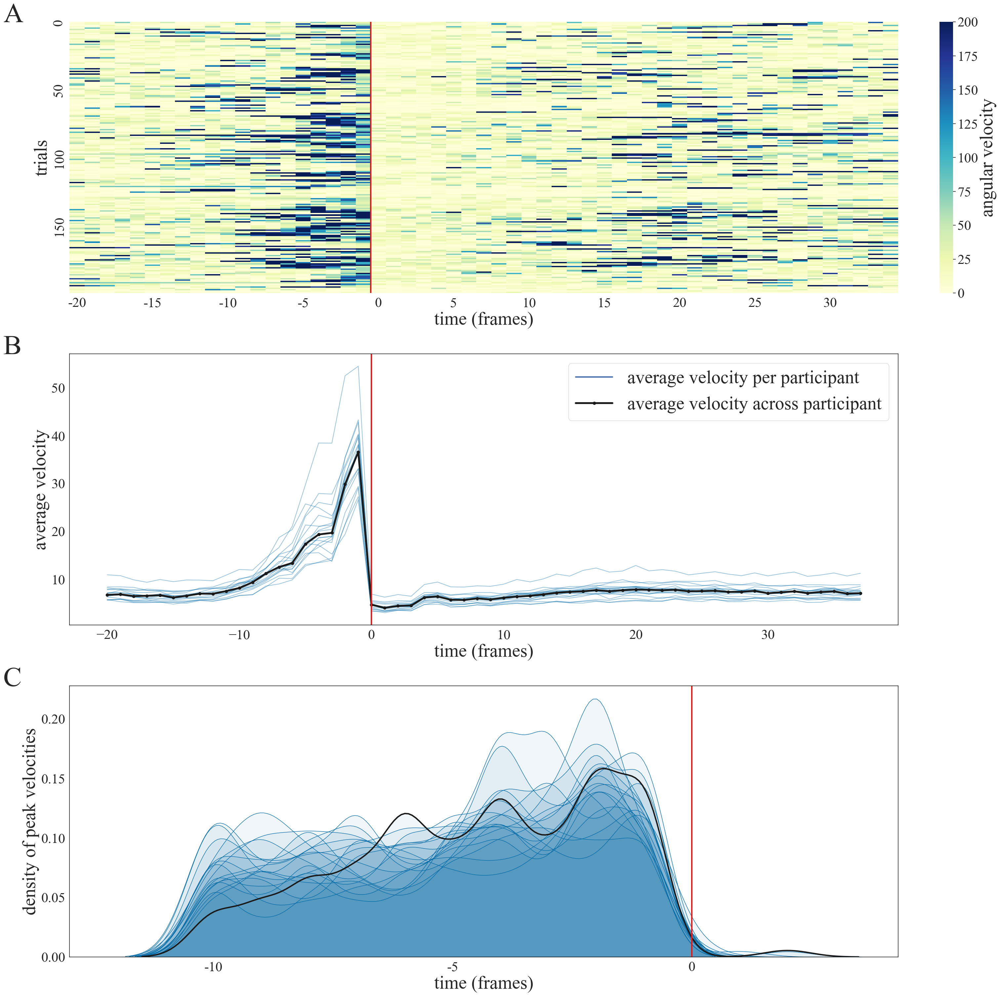

In [252]:
ids = recordings.index.tolist()
idd = ids[:]

start_fr = 20  # how many frames before gaze onset
end_fr = 35  # how many frames to include after gaze onset
data = {} # save data
trials_all = []
start_fr_peak = 10  # how many frames before gaze onset
max_vels_all = {}
max_vels_all['max_vels'] = {}



sns.set(rc={"figure.figsize": (30, 30)})
sns.set_style("white")  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, (ax) = plt.subplots(3,1, constrained_layout=True)

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Times New Roman" # font name
plt.rcParams["font.family"] = fname

for i, uid in enumerate(idd):
    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )
    condition = "Data driven intervals"

    ####### Velocity over trials #######
    if i == 0:
        for_eye_new = for_eye
        # replace all velocities over 200 with 200
        combined_vel = for_eye["combined_vel"].tolist()
        c_v = [200 if cv > 200 else cv for cv in combined_vel]
        for_eye_new["combined_vel"] = c_v
        # get gazes
        gaze = for_eye_new[for_eye_new["events"] == 2.0]
        gaze = gaze[~gaze["long_events"].isnull()]
        # get trial onsets
        gaze = gaze.iloc[50:250]
        # now go through the trials
        trials = {}
        for g, gz in enumerate(gaze.index.tolist()):
            cur = for_eye.iloc[gz - start_fr : gz + end_fr]
            trials[g] = cur["combined_vel"].tolist()
        # plot the results
        trials = pd.DataFrame(trials).transpose()
        trials = trials.to_numpy()
        trials[np.isnan(trials)] = 0
        sns.heatmap(trials, cmap="YlGnBu", xticklabels=5, yticklabels=50, ax=ax[0])  
        ax[0].axvline(x=start_fr, linewidth=3, color=sacc_color_1)
        ax[0].set_xlabel("time (frames)", fontsize=labelsize, fontname=fname)
        ax[0].set_ylabel("trials", fontsize=labelsize, fontname=fname)
        for label in ax[0].get_xticklabels(): # change tick font
            label.set_fontproperties(fname)
        for label in ax[0].get_yticklabels():
            label.set_fontproperties(fname)
        ax[0].yaxis.set_tick_params(labelsize=ticksize)  # change tick size
        ax[0].xaxis.set_tick_params(labelsize=ticksize)
        cbar = ax[0].collections[0].colorbar
        cbar.ax.tick_params(labelsize=ticksize)
        cbar.set_label("angular velocity", fontsize=labelsize, fontname=fname)
        ax[0].set_xticklabels(list(np.arange(-start_fr, end_fr, 5)),)
        
        end_fr = end_fr + 3

    ####### Velocity over subjects #######
    # get gazes
    gaze = for_eye[for_eye["events"] == 2.0]
    gaze = gaze[~gaze["long_events"].isnull()]
    # now go through the trials
    trials = {}
    for g, gz in enumerate(gaze.index.tolist()):
        if (gz - start_fr) > 0 and (gz + end_fr) < len(for_eye):
            cur = for_eye.iloc[gz - start_fr : gz + end_fr]
            trials[g] = cur["combined_vel"].tolist()
    trials = pd.DataFrame(trials).transpose()
    # add the mean for this subjects to data
    data[uid[:5]] = trials.median(skipna=True)
    ax[1].plot(list(range(-start_fr,end_fr)), data[uid[:5]], color=gaze_color_1, 
                linestyle='solid',linewidth=1.5, alpha=0.4, label="average velocity per participant")

    ####### Peak Velocities #######
    gaze = for_eye[for_eye["events"] == 2.0]
    gaze = gaze[~gaze["long_events"].isnull()]
    trials = []
    max_vels = []
    for g, gz in enumerate(gaze.index.tolist()):
        if gz - start_fr_peak > 0 and gz + 3 < len(gaze.index.tolist()):
            cur = for_eye.iloc[gz - start_fr_peak : gz + 3]
            trials.append(
                cur["combined_vel"]
                .tolist()
                .index(np.nanmax(cur["combined_vel"].tolist()))
            )
            trials_all.append(
                cur["combined_vel"]
                .tolist()
                .index(np.nanmax(cur["combined_vel"].tolist()))
            )
            max_vels.append(np.nanmedian(
                cur["combined_vel"]
                .tolist())
            )
    max_vels_all['max_vels'][uid] = np.nanmedian(max_vels)
    sns.kdeplot(
        trials,
        bw_adjust=0.5, #0.4,
        color=gaze_color_1,
        alpha=0.06,
        fill=True,
        ax = ax[2]
    )

    
####### Velocity over subjects #######
data = pd.DataFrame(data).transpose()
# get mean across subjects
finished_data = data.median(skipna=True)
ax[1].plot(list(range(-start_fr,end_fr)), finished_data, color='k', 
    linestyle='solid', marker='o',linewidth=4, label="average velocity across participant")
# legend:
handles, labels = ax[1].get_legend_handles_labels()
line2d_obj = Line2D([0], [0], linewidth=3, linestyle='solid', alpha = 1.0)
handles[-2] = line2d_obj
ax[1].legend(handles[-2:],labels[-2:],loc="upper right", fontsize=legendsize)
ax[1].axvline(x=0, linewidth=3, color=sacc_color_1)
ax[1].set_xlabel("time (frames)", fontsize=labelsize, fontname=fname)
ax[1].set_ylabel("average velocity", fontsize=labelsize, fontname=fname)
for label in ax[1].get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax[1].get_yticklabels():
    label.set_fontproperties(fname)
ax[1].yaxis.set_tick_params(labelsize = ticksize) # change tick size
ax[1].xaxis.set_tick_params(labelsize = ticksize)

####### Peak Velocities #######
sns.kdeplot(
    trials,
    bw_adjust=0.5,
    color="k",
    linewidth = 3,
    ax = ax[2]
)
ax[2].axvline(x=start_fr_peak, linewidth=3, color=sacc_color_1)
ax[2].set_xlabel("time (frames)", fontsize=labelsize, fontname=fname)
ax[2].set_ylabel("density of peak velocities", fontsize=labelsize, fontname=fname)
for label in ax[2].get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax[2].get_yticklabels():
    label.set_fontproperties(fname)
ax[2].yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax[2].xaxis.set_tick_params(labelsize=ticksize)
ax[2].set_xticks(list(np.arange(-3, 15, 1)),)
ax[2].set_xticklabels(list(np.arange(-13, 5, 1)),)
xticks = ax[2].xaxis.get_major_ticks()
ticks = [0,1,2,4,5,6,7,9,10,11,12,14,15,16,17]
for x in ticks:
    xticks[x].label1.set_visible(False)  # Hide the 4th x-tick
ax[2].locator_params(nbins=5, axis='y')


ax[0].set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname)  
ax[1].set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname) 
ax[2].set_title("C", fontsize=numbersize, fontweight="bold",loc="left", x=-0.08, y=1.05, pad=-30, fontname=fname)  

plt.show()

## Individual Plots

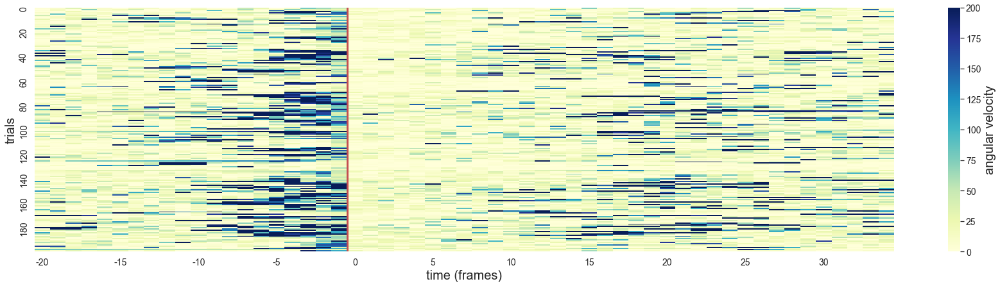

In [83]:
#### FOR PUBLICATION:
# compare 10sec and data driven interval
ids = recordings.index.tolist()
idd = ids[:1]

#nr_trials = 200  # how many trials should be included
start_fr = 20  # how many frames before gaze onset
end_fr = 35  # how many frames to include after gaze onset
for i, uid in enumerate(idd):
    # prepare plot
    sns.set(rc={"figure.figsize": (30, 7)})
    sns.set_style(
        "whitegrid"
    )  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
    f, (ax) = plt.subplots(1)

    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )
    condition = "Data driven intervals"

    # replace all velocities over 200 with 200
    combined_vel = for_eye["combined_vel"].tolist()
    c_v = [200 if cv > 200 else cv for cv in combined_vel]
    for_eye["combined_vel"] = c_v

    # get gazes
    gaze = for_eye[for_eye["events"] == 2.0]
    # get rid of long gaze events
    gaze = gaze[~gaze["long_events"].isnull()]

    # get trial onsets
    gaze = gaze.iloc[50:250]
    # now go through the trials
    trials = {}
    for g, gz in enumerate(gaze.index.tolist()):
        cur = for_eye.iloc[gz - start_fr : gz + end_fr]
        trials[g] = cur["combined_vel"].tolist()

    # plot the results
    trials = pd.DataFrame(trials).transpose()
    trials = trials.to_numpy()
    trials[np.isnan(trials)] = 0

    ax = sns.heatmap(
        trials, cmap="YlGnBu", xticklabels=5, yticklabels=20, ax=ax
    )  # , cbar_kws={'label': 'angular velocity'})
    ax.axvline(x=start_fr, linewidth=3, color="r")
    ax.set_xlabel("time (frames)", fontsize=20)
    ax.set_ylabel("trials", fontsize=20)
    ax.yaxis.set_tick_params(labelsize=14)  # change tick size
    ax.xaxis.set_tick_params(labelsize=14)
    cbar = ax.collections[0].colorbar
    cbar.ax.tick_params(labelsize=14)
    cbar.set_label("angular velocity", fontsize=20)

    #ax.set_title(
    #    "Eye Angular Velocity (" + condition + ")",
    #    fontsize=22,
    #    fontweight="bold",
    #)
    ax.set_xticklabels(list(np.arange(-start_fr, end_fr, 5)),)
    #xticks = ax.xaxis.get_major_ticks()
    #ticks = [0,1,2,4,5,6,7,9,10,11,12,14,15,16,17]
    #for x in ticks:
    #    xticks[x].label1.set_visible(False)  # Hide the 4th x-tick

    #plt.tight_layout(rect=[0, 0.03, 0.9, 1])
    plt.show()

    # f.savefig(f"eye_ang_vel{condition}.pdf", dpi = 1200)

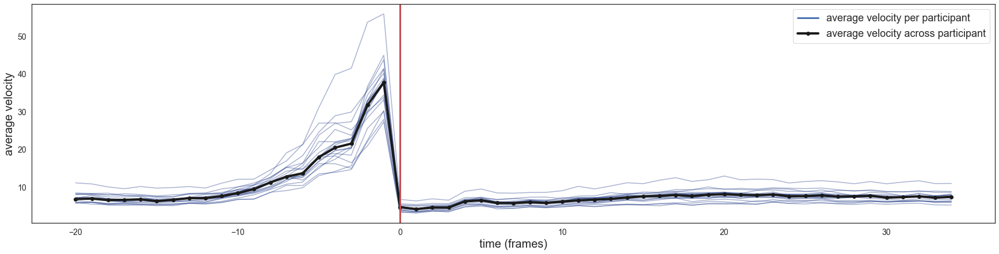

In [86]:
#### FOR PUBLICATION:
# compare 10sec and data driven interval
ids = recordings.index.tolist()
idd = ids[:]

start_fr = 20  # how many frames before gaze onset
end_fr = 35  # how many frames to include after gaze onset

# plot it:
sns.set(rc={"figure.figsize": (30, 7)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, (ax) = plt.subplots(1)
data = {} # save data
for i, uid in enumerate(idd):

    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )
    condition = "Data driven intervals"

    colors = ["#27408B"]

    # get gazes
    gaze = for_eye[for_eye["events"] == 2.0]
    # get rid of long gaze events
    gaze = gaze[~gaze["long_events"].isnull()]

    # now go through the trials
    trials = {}
    for g, gz in enumerate(gaze.index.tolist()):
        if (gz - start_fr) > 0 and (gz + end_fr) < len(for_eye):
            cur = for_eye.iloc[gz - start_fr : gz + end_fr]
            trials[g] = cur["combined_vel"].tolist()

    trials = pd.DataFrame(trials).transpose()
    # add the mean for this subjects to data
    data[uid[:5]] = trials.median(skipna=True)
    ax.plot(list(range(-start_fr,end_fr)), data[uid[:5]], color=colors[0], 
                linestyle='solid',linewidth=1.5, alpha=0.4, label="average velocity per participant")
# create df
data = pd.DataFrame(data).transpose()
# get mean across subjects
finished_data = data.median(skipna=True)
ax.plot(list(range(-start_fr,end_fr)), finished_data, color='k', 
    linestyle='solid', marker='o',linewidth=4, label="average velocity across participant")


# legend:
handles, labels = plt.gca().get_legend_handles_labels()
line2d_obj = Line2D([0], [0], linewidth=3, linestyle='solid', alpha = 1.0)
handles[-2] = line2d_obj
ax.legend(handles[-2:],labels[-2:],loc="upper right", fontsize=18)


ax.axvline(x=0, linewidth=3, color="r")
ax.set_xlabel("time (frames)", fontsize=20)
ax.set_ylabel("average velocity", fontsize=20)
ax.yaxis.set_tick_params(labelsize = 14) # change tick size
ax.xaxis.set_tick_params(labelsize = 14)

plt.show()

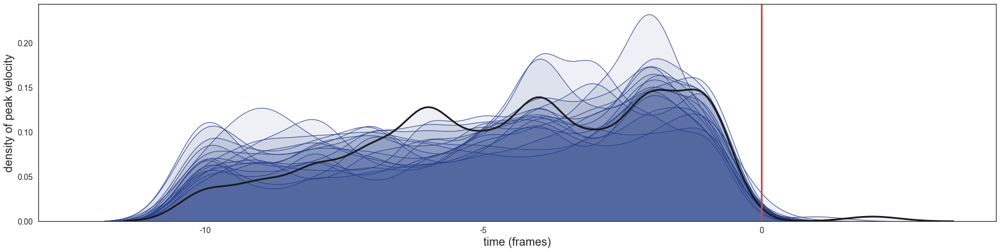

Mean: 12.8721
Std: 3.6771


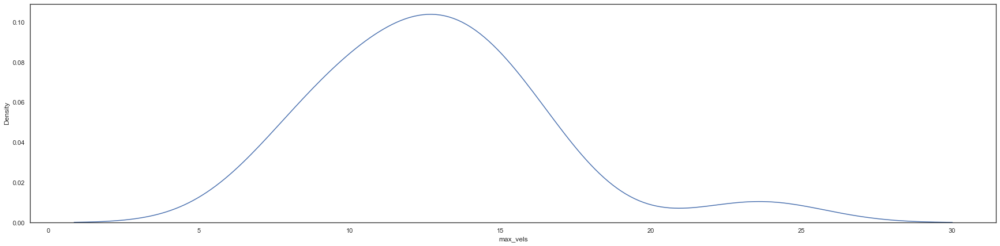

In [87]:
#### FOR PUBLICATION:
# compare 10sec and data driven interval
ids = recordings.index.tolist()
idd = ids[:]

start_fr = 10  # how many frames before gaze onset
max_vels_all = {}
max_vels_all['max_vels'] = {}

sns.set(rc={"figure.figsize": (30, 7)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, (ax) = plt.subplots(1, sharey=True)
colors = ["#27408B"]


trials_all = []
for i, uid in enumerate(idd):
    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )
    condition = "Data driven intervals"

    # replace all velocities over 200 with 200
    combined_vel = for_eye["combined_vel"].tolist()
    # c_v = [200 if cv > 200 else cv for cv in combined_vel]
    # for_eye["combined_vel"] = c_v

    # get gazes
    gaze = for_eye[for_eye["events"] == 2.0]
    # get rid of long gaze events
    gaze = gaze[~gaze["long_events"].isnull()]

    # get trial onsets
    # gaze = gaze.iloc[50:150]
    # now go through the trials
    trials = []
    max_vels = []
    for g, gz in enumerate(gaze.index.tolist()):
        if gz - start_fr > 0 and gz + 3 < len(gaze.index.tolist()):
            cur = for_eye.iloc[gz - start_fr : gz + 3]
            trials.append(
                cur["combined_vel"]
                .tolist()
                .index(np.nanmax(cur["combined_vel"].tolist()))
            )
            trials_all.append(
                cur["combined_vel"]
                .tolist()
                .index(np.nanmax(cur["combined_vel"].tolist()))
            )
            max_vels.append(np.nanmedian(
                cur["combined_vel"]
                .tolist())
            )

    max_vels_all['max_vels'][uid] = np.nanmedian(max_vels)
    # prepare plot
    #plt.subplot(2,1, fe+1)
    sns.kdeplot(
        trials,
        bw_adjust=0.5, #0.4,
        color=colors[0],
        alpha=0.08,
        fill=True,
        #cut=0,
    )


#plt.subplot(2,1, fe+1)
sns.kdeplot(
    trials,
    bw_adjust=0.5,
    color="k", #"#4C86A8",
    #fill=True,
    #cut=0,
    linewidth = 3,
)
ax.axvline(x=start_fr, linewidth=3, color="r")
#ax[fe].set_xlim(-10, 15)
ax.set_xlabel("time (frames)", fontsize=20)
ax.set_ylabel("density of peak velocity", fontsize=20)
ax.yaxis.set_tick_params(labelsize=14)  # change tick size
ax.xaxis.set_tick_params(labelsize=14)
ax.set_xticks(list(np.arange(-3, 15, 1)),)

ax.set_xticklabels(list(np.arange(-13, 5, 1)),)
xticks = ax.xaxis.get_major_ticks()
ticks = [0,1,2,4,5,6,7,9,10,11,12,14,15,16,17]
for x in ticks:
    xticks[x].label1.set_visible(False)  # Hide the 4th x-tick

#plt.title(
#    "Distribution of Peak velocity before gaze onset (" + condition + ")",
#    fontsize=22,
#    fontweight="bold",
#)

#plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()
#
# f.savefig(f"eye_ang_vel{condition}.pdf", dpi = 1200)

max_vels_all = pd.DataFrame(max_vels_all)
#display(max_vels_all)
#plt.hist(max_vels_all['max_vels'])
sns.kdeplot((max_vels_all['max_vels']))
print(f"Mean: {np.mean(max_vels_all['max_vels']).transpose():.4f}")
print(f"Std: {np.std(max_vels_all['max_vels']).transpose():.4f}")

# Dispersion distribution in relation to gaze onset

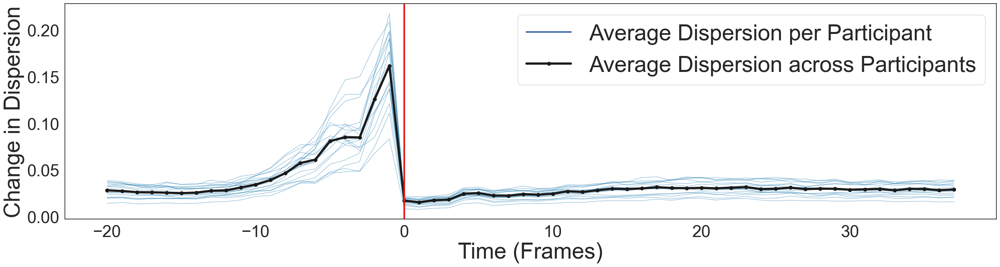

In [11]:
######## APA Style!!! ########

# compare 10sec and data driven interval
ids = recordings.index.tolist()
idd = ids[:]

start_fr = 20  # how many frames before gaze onset
end_fr = 38  # how many frames to include after gaze onset

ten_sec = {}  # save data
data_driven = {}


# plot it:
sns.set(rc={"figure.figsize": (30, 7)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, (ax) = plt.subplots(1)



labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Arial" # font name
plt.rcParams["font.family"] = fname

data = {}  # save data
# we go through each subject:
# get the trials
# vcalculate the average for each subject
# save the data
for i, uid in enumerate(idd):
    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )
    condition = "Data driven intervals"

    # get distances
    distances = np.sqrt(np.square(for_eye['xhpoo'].diff()) + np.square(for_eye['yhpoo'].diff()) + np.square(for_eye['zhpoo'].diff()))
    for_eye["distance_hpoo"] = distances

    # get gazes
    gaze = for_eye[for_eye["events"] == 2.0]
    # get rid of long gaze events
    gaze = gaze[~gaze["long_events"].isnull()]

    # now go through the trials
    trials = {}
    for g, gz in enumerate(gaze.index.tolist()):
        if (gz - start_fr) > 0 and (gz + end_fr) < len(for_eye):
            cur = for_eye.iloc[gz - start_fr : gz + end_fr]
            trials[g] = cur["distance_hpoo"].tolist()

    trials = pd.DataFrame(trials).transpose()
    # add the mean for this subjects to data
    data[uid[:5]] = trials.median(skipna=True)

    ax.plot(
        list(range(-start_fr, end_fr)),
        data[uid[:5]],
        color=gaze_color_1,
        linestyle="solid",
        linewidth=1,
        alpha=0.4,
        label="Average Dispersion per Participant"
    )

# create df
data = pd.DataFrame(data).transpose()
# get mean across subjects
finished_data = data.median(skipna=True)


ax.plot(
    list(range(-start_fr, end_fr)),
    finished_data,
    color="k",
    linestyle="solid",
    marker="o",
    linewidth=4,
    label="Average Dispersion across Participants"
)

# legend:
handles, labels = plt.gca().get_legend_handles_labels()
line2d_obj = Line2D([0], [0], linewidth=3, linestyle='solid', alpha = 1.0)
handles[-2] = line2d_obj
ax.legend(handles[-2:],labels[-2:],loc="upper right", fontsize=legendsize)

ax.axvline(x=0, linewidth=3, color=sacc_color_1)
ax.set_xlabel("Time (Frames)", fontsize=labelsize, fontname=fname)
ax.set_ylabel("Change in Dispersion", fontsize=labelsize, fontname=fname)
for label in ax.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax.get_yticklabels():
    label.set_fontproperties(fname)
ax.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax.xaxis.set_tick_params(labelsize=ticksize)

plt.show()

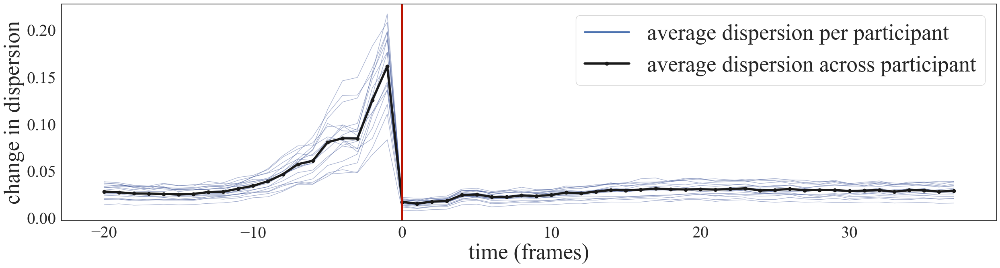

In [280]:
#### FOR PUBLICATION:
# compare 10sec and data driven interval
ids = recordings.index.tolist()
idd = ids[:]

start_fr = 20  # how many frames before gaze onset
end_fr = 38  # how many frames to include after gaze onset

ten_sec = {}  # save data
data_driven = {}


# plot it:
sns.set(rc={"figure.figsize": (30, 7)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
f, (ax) = plt.subplots(1)



labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Times New Roman" # font name
plt.rcParams["font.family"] = fname

data = {}  # save data
# we go through each subject:
# get the trials
# vcalculate the average for each subject
# save the data
for i, uid in enumerate(idd):
    # load data
    for_eye = pd.read_csv(
        f"{PATH_FOREYE}/correTS_mad_wobig_{uid}.csv", index_col=0
    )
    condition = "Data driven intervals"

    # get distances
    distances = np.sqrt(np.square(for_eye['xhpoo'].diff()) + np.square(for_eye['yhpoo'].diff()) + np.square(for_eye['zhpoo'].diff()))
    for_eye["distance_hpoo"] = distances

    # get gazes
    gaze = for_eye[for_eye["events"] == 2.0]
    # get rid of long gaze events
    gaze = gaze[~gaze["long_events"].isnull()]

    # now go through the trials
    trials = {}
    for g, gz in enumerate(gaze.index.tolist()):
        if (gz - start_fr) > 0 and (gz + end_fr) < len(for_eye):
            cur = for_eye.iloc[gz - start_fr : gz + end_fr]
            trials[g] = cur["distance_hpoo"].tolist()

    trials = pd.DataFrame(trials).transpose()
    # add the mean for this subjects to data
    data[uid[:5]] = trials.median(skipna=True)

    ax.plot(
        list(range(-start_fr, end_fr)),
        data[uid[:5]],
        color=gaze_color_1,
        linestyle="solid",
        linewidth=1,
        alpha=0.4,
        label="average dispersion per participant"
    )

# create df
data = pd.DataFrame(data).transpose()
# get mean across subjects
finished_data = data.median(skipna=True)


ax.plot(
    list(range(-start_fr, end_fr)),
    finished_data,
    color="k",
    linestyle="solid",
    marker="o",
    linewidth=4,
    label="average dispersion across participant"
)

# legend:
handles, labels = plt.gca().get_legend_handles_labels()
line2d_obj = Line2D([0], [0], linewidth=3, linestyle='solid', alpha = 1.0)
handles[-2] = line2d_obj
ax.legend(handles[-2:],labels[-2:],loc="upper right", fontsize=legendsize)

ax.axvline(x=0, linewidth=3, color=sacc_color_1)
ax.set_xlabel("time (frames)", fontsize=labelsize, fontname=fname)
ax.set_ylabel("change in dispersion", fontsize=labelsize, fontname=fname)
for label in ax.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax.get_yticklabels():
    label.set_fontproperties(fname)
ax.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax.xaxis.set_tick_params(labelsize=ticksize)

plt.show()

# EEG results

## ERP

In [81]:
# Number of events going into the average ERPs:
# data calculated in figures_ET_EEG_paper.m
mat = scipy.io.loadmat(f"{PATH_EEG}/nr_trials_erp.mat")
mat = mat["nr_events"]
mat = pd.DataFrame(mat)

print(f"Median Amount of Interpolation: {np.nanmedian(mat[0])}")
# Interquartile range:
q75, q25 = np.nanpercentile(mat[0].tolist(), [75, 25])
iqr_interp = q75 - q25
print(f"IQR gaze DD: {iqr_interp} ({q25}-{q75})")

Median Amount of Interpolation: 3224.5
IQR gaze DD: 1407.75 (2737.75-4145.5)


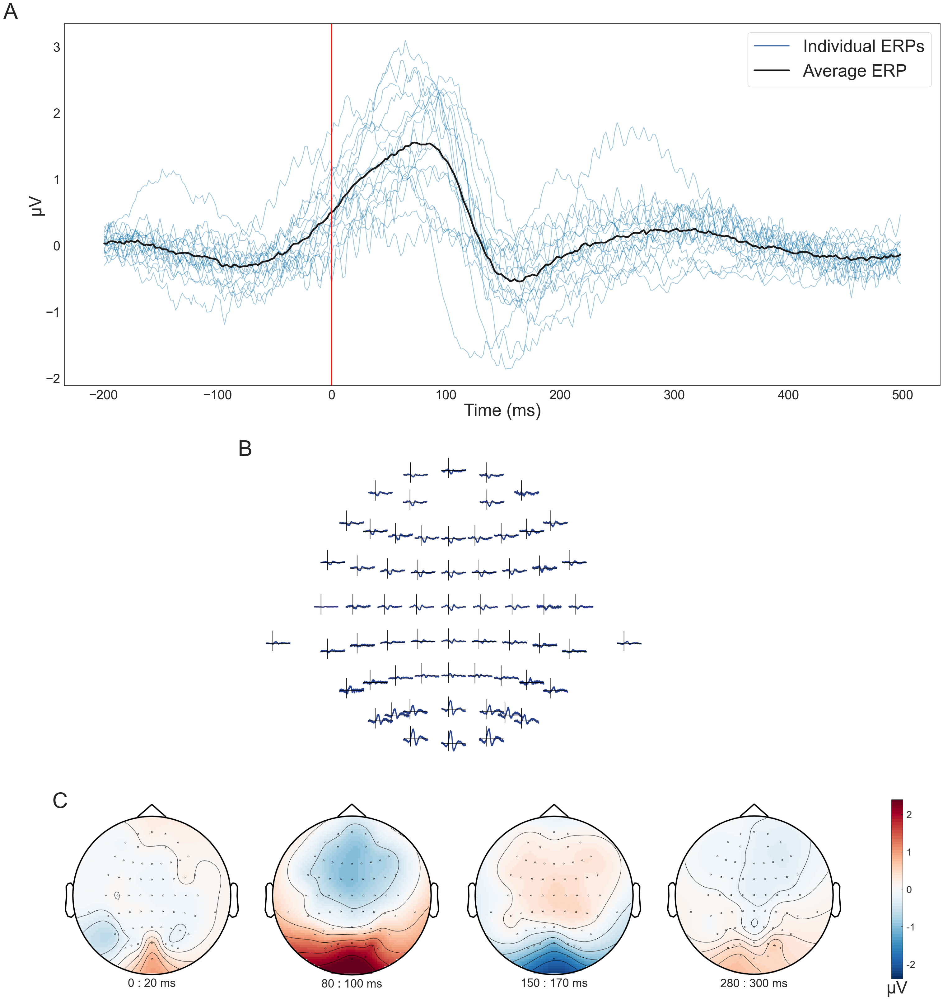

In [13]:
######## APA Style!!! ########

### ERP Plots

plt.figure(figsize=(30, 32), constrained_layout=True)

sns.set_style("white") 

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Arial" # font name
plt.rcParams["font.family"] = fname

ax1 = plt.subplot2grid(shape=(5, 9), loc=(0, 0), rowspan=2, colspan=9)
ax2 = plt.subplot2grid(shape=(5, 9), loc=(2, 2), rowspan=2, colspan=4)
ax31 = plt.subplot2grid(shape=(5, 9), loc=(4, 0), rowspan=1, colspan=2)
ax32 = plt.subplot2grid(shape=(5, 9), loc=(4, 2), rowspan=1, colspan=2)
ax33 = plt.subplot2grid(shape=(5, 9), loc=(4, 4), rowspan=1, colspan=2)
ax34 = plt.subplot2grid(shape=(5, 9), loc=(4, 6), rowspan=1, colspan=2)
ax35 = plt.subplot2grid(shape=(5, 9), loc=(4, 8), rowspan=1, colspan=1)

####### Average ERPs #######
#load the appropriate file
mat = scipy.io.loadmat(f"{PATH_EEG}/avg_erps.mat")
times = mat["times"].tolist()[0]
mat = mat["avg_erps_no"]
mat = pd.DataFrame(mat)
for i in range(len(mat.index[:])):
    ax1.plot(times,mat.iloc[i].values.tolist(),color=gaze_color_1,alpha=0.4,label="Individual ERPs")
ax1.plot(times,mat.mean().tolist(),color="k",linewidth=4,label="Average ERP")
ax1.axvline(x=0, linewidth=3, color=sacc_color_1)
# legend:
handles, labels = ax1.get_legend_handles_labels()
line2d_obj = Line2D([0], [0], linewidth=3, linestyle='solid', alpha = 1.0)
handles[-2] = line2d_obj
ax1.legend(handles[-2:],labels[-2:],loc="upper right", fontsize=legendsize)
ax1.set_xlabel("Time (ms)", fontsize=labelsize, fontname=fname)
ax1.set_ylabel(u'\u03bc' + 'V', fontsize=labelsize, fontname=fname)
for label in ax1.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax1.get_yticklabels():
    label.set_fontproperties(fname)
ax1.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax1.xaxis.set_tick_params(labelsize=ticksize)
ax1.set_title("A", fontsize=50, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 


####### Topoplot ######
img = plt.imread(f"{PATH_EEG}/Topoplot_ERPs.png")
ax2.imshow(img)
ax2.axis('off')
ax2.set_title("B", fontsize=50, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 


####### Topoplot 0.0 ######
img = plt.imread(f"{PATH_EEG}/Topoplot_0.png")
ax31.imshow(img)
ax31.axis('off')
ax31.set_title("C", fontsize=50, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 
ax31.text(0.5, -0.05, '0 : 20 ms',fontsize=27, horizontalalignment='center', verticalalignment='center', transform=ax31.transAxes, fontname=fname)

####### Topoplot 0.08 ######
img = plt.imread(f"{PATH_EEG}/Topoplot_0.08.png")
ax32.imshow(img)
ax32.axis('off')
ax32.text(0.5, -0.05, '80 : 100 ms',fontsize=27, horizontalalignment='center', verticalalignment='center', transform=ax32.transAxes, fontname=fname)

####### Topoplot 0.15 ######
img = plt.imread(f"{PATH_EEG}/Topoplot_0.15.png")
ax33.imshow(img)
ax33.axis('off')
ax33.text(0.5, -0.05, '150 : 170 ms',fontsize=27, horizontalalignment='center', verticalalignment='center', transform=ax33.transAxes, fontname=fname)

####### Topoplot 0.28 ######
img = plt.imread(f"{PATH_EEG}/Topoplot_0.28.png")
ax34.imshow(img)
ax34.axis('off')
ax34.text(0.5, -0.05, '280 : 300 ms',fontsize=27, horizontalalignment='center', verticalalignment='center', transform=ax34.transAxes, fontname=fname)

####### Colorbar ######
img = plt.imread(f"{PATH_EEG}/Topoplot_0_colorbar.png")
ax35.imshow(img)
ax35.axis('off')
ax35.text(0.25, -0.05, u'\u03bc' + 'V', fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax35.transAxes, fontname=fname)


plt.show()

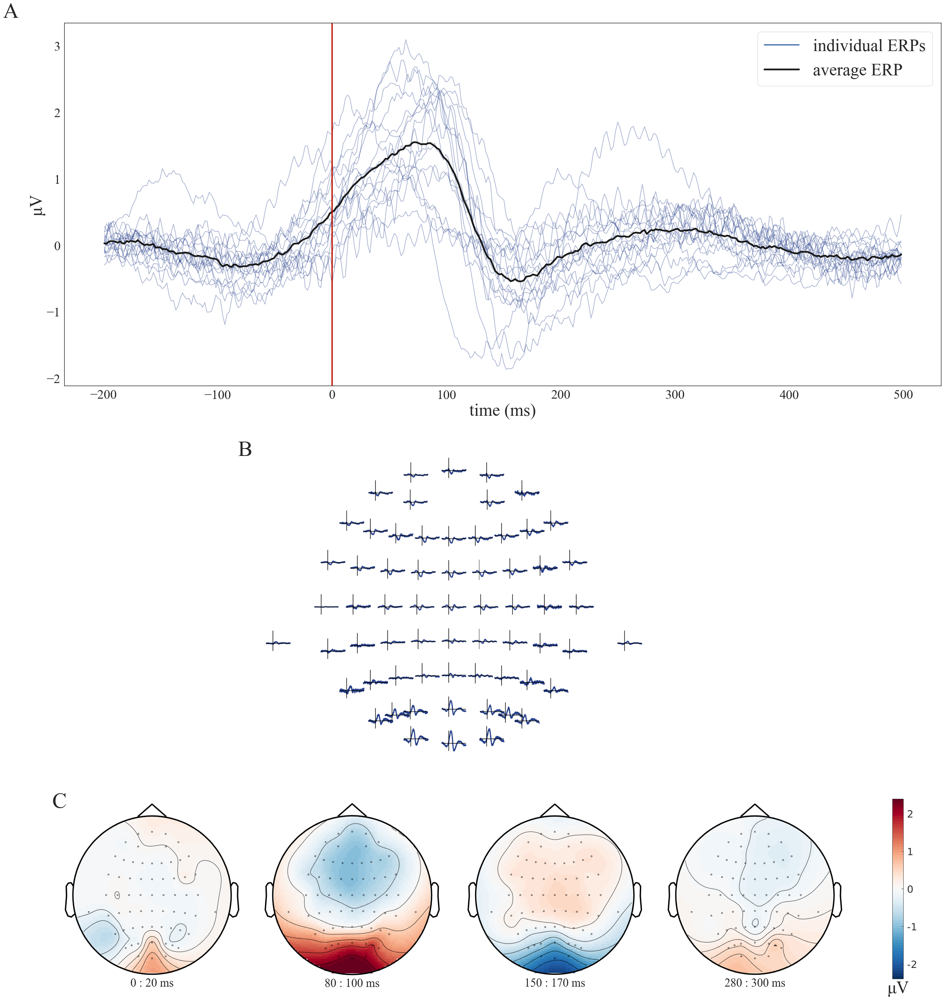

In [281]:
### ERP Plots

plt.figure(figsize=(30, 32), constrained_layout=True)

sns.set_style("white") 

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Times New Roman" # font name
plt.rcParams["font.family"] = fname

ax1 = plt.subplot2grid(shape=(5, 9), loc=(0, 0), rowspan=2, colspan=9)
ax2 = plt.subplot2grid(shape=(5, 9), loc=(2, 2), rowspan=2, colspan=4)
ax31 = plt.subplot2grid(shape=(5, 9), loc=(4, 0), rowspan=1, colspan=2)
ax32 = plt.subplot2grid(shape=(5, 9), loc=(4, 2), rowspan=1, colspan=2)
ax33 = plt.subplot2grid(shape=(5, 9), loc=(4, 4), rowspan=1, colspan=2)
ax34 = plt.subplot2grid(shape=(5, 9), loc=(4, 6), rowspan=1, colspan=2)
ax35 = plt.subplot2grid(shape=(5, 9), loc=(4, 8), rowspan=1, colspan=1)

####### Average ERPs #######
#load the appropriate file
mat = scipy.io.loadmat(f"{PATH_EEG}/avg_erps.mat")
times = mat["times"].tolist()[0]
mat = mat["avg_erps_no"]
mat = pd.DataFrame(mat)
for i in range(len(mat.index[:])):
    ax1.plot(times,mat.iloc[i].values.tolist(),color=gaze_color_1,alpha=0.4,label="individual ERPs")
ax1.plot(times,mat.mean().tolist(),color="k",linewidth=4,label="average ERP")
ax1.axvline(x=0, linewidth=3, color=sacc_color_1)
# legend:
handles, labels = ax1.get_legend_handles_labels()
line2d_obj = Line2D([0], [0], linewidth=3, linestyle='solid', alpha = 1.0)
handles[-2] = line2d_obj
ax1.legend(handles[-2:],labels[-2:],loc="upper right", fontsize=legendsize)
ax1.set_xlabel("time (ms)", fontsize=labelsize, fontname=fname)
ax1.set_ylabel(u'\u03bc' + 'V', fontsize=labelsize, fontname=fname)
for label in ax1.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax1.get_yticklabels():
    label.set_fontproperties(fname)
ax1.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax1.xaxis.set_tick_params(labelsize=ticksize)
ax1.set_title("A", fontsize=50, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 


####### Topoplot ######
img = plt.imread(f"{PATH_EEG}/Topoplot_ERPs.png")
ax2.imshow(img)
ax2.axis('off')
ax2.set_title("B", fontsize=50, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 


####### Topoplot 0.0 ######
img = plt.imread(f"{PATH_EEG}/Topoplot_0.png")
ax31.imshow(img)
ax31.axis('off')
ax31.set_title("C", fontsize=50, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 
ax31.text(0.5, -0.05, '0 : 20 ms',fontsize=27, horizontalalignment='center', verticalalignment='center', transform=ax31.transAxes, fontname=fname)

####### Topoplot 0.08 ######
img = plt.imread(f"{PATH_EEG}/Topoplot_0.08.png")
ax32.imshow(img)
ax32.axis('off')
ax32.text(0.5, -0.05, '80 : 100 ms',fontsize=27, horizontalalignment='center', verticalalignment='center', transform=ax32.transAxes, fontname=fname)

####### Topoplot 0.15 ######
img = plt.imread(f"{PATH_EEG}/Topoplot_0.15.png")
ax33.imshow(img)
ax33.axis('off')
ax33.text(0.5, -0.05, '150 : 170 ms',fontsize=27, horizontalalignment='center', verticalalignment='center', transform=ax33.transAxes, fontname=fname)

####### Topoplot 0.28 ######
img = plt.imread(f"{PATH_EEG}/Topoplot_0.28.png")
ax34.imshow(img)
ax34.axis('off')
ax34.text(0.5, -0.05, '280 : 300 ms',fontsize=27, horizontalalignment='center', verticalalignment='center', transform=ax34.transAxes, fontname=fname)

####### Colorbar ######
img = plt.imread(f"{PATH_EEG}/Topoplot_0_colorbar.png")
ax35.imshow(img)
ax35.axis('off')
ax35.text(0.25, -0.05, u'\u03bc' + 'V', fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax35.transAxes, fontname=fname)


plt.show()

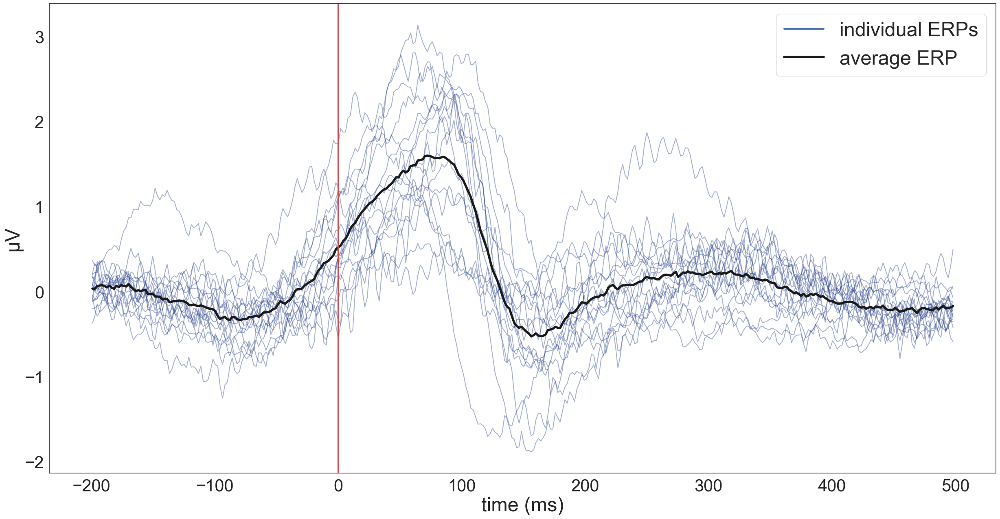

In [103]:
### ERP Plots
#set up figure
sns.set(rc={"figure.figsize": (30, 15)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
#plt.figure(figsize=(20, 20))


fig, ax = plt.subplots(1)

labelsize = 35 #text
legendsize = 35 #ledgend
ticksize = 30 #ticks

# load data
#condition = "10 Second Intervals"
condition = "Data-Driven Intervals"

#load the appropriate file
mat = scipy.io.loadmat(f"{PATH_EEG}/avg_erps.mat")
times = mat["times"].tolist()[0]
mat = mat["avg_erps_no"]
mat = pd.DataFrame(mat)

for i in range(len(mat.index[:])):
    plt.plot(times,mat.iloc[i].values.tolist(),color="#27408B",alpha=0.4,label="individual ERPs")

    
plt.plot(times,mat.mean().tolist(),color="k",linewidth=4,label="average ERP")

ax.axvline(x=0, linewidth=3, color="r")

# legend:
handles, labels = plt.gca().get_legend_handles_labels()
line2d_obj = Line2D([0], [0], linewidth=3, linestyle='solid', alpha = 1.0)
handles[-2] = line2d_obj
ax.legend(handles[-2:],labels[-2:],loc="upper right", fontsize=legendsize)

ax.set_xlabel("time (ms)", fontsize=labelsize)
#ax.set_ylabel("change in dispersion", fontsize=labelsize)
ax.set_ylabel(u'\u03bc' + 'V', fontsize=labelsize)
ax.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
ax.xaxis.set_tick_params(labelsize=ticksize)

plt.show()

## ERSPs

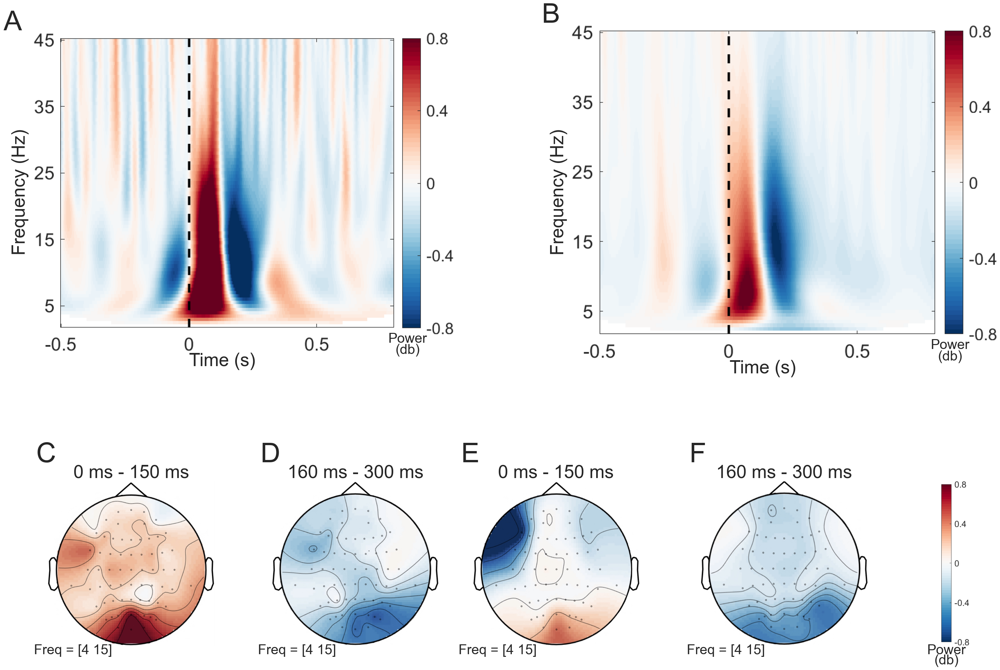

In [15]:
######## APA Style!!! ########

labelsize = 35 #text

# plot it:
plt.figure(figsize=(30, 22), constrained_layout=True)
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Arial" # font name
plt.rcParams["font.family"] = fname

ax1 = plt.subplot2grid(shape=(4, 9), loc=(0, 0), rowspan=3, colspan=4)
ax2 = plt.subplot2grid(shape=(4, 9), loc=(0, 5), rowspan=3, colspan=4)
ax3 = plt.subplot2grid(shape=(4, 9), loc=(3, 0), rowspan=1, colspan=2)
ax4 = plt.subplot2grid(shape=(4, 9), loc=(3, 2), rowspan=1, colspan=2)
ax5 = plt.subplot2grid(shape=(4, 9), loc=(3, 4), rowspan=1, colspan=2)
ax6 = plt.subplot2grid(shape=(4, 9), loc=(3, 6), rowspan=1, colspan=2)
ax7 = plt.subplot2grid(shape=(4, 9), loc=(3, 8), rowspan=1, colspan=1)


####### ERSP single subject ######
img = plt.imread(f"{PATH_EEG}/NEW_ERSP_at_Oz_single_Subject.png")
ax1.imshow(img)
ax1.set_yticklabels([])
ax1.set_xticklabels([])
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 
ax1.text(0.45, -0.03, 'Time (s)',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax1.transAxes, fontname=fname)
ax1.text(-0.03, 0.5, 'Frequency (Hz)',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', rotation = 90, transform=ax1.transAxes, fontname=fname)
ax1.text(0.89, 0.04, 'Power',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax1.transAxes, fontname=fname)
ax1.text(0.89, 0.005, '(db)',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax1.transAxes, fontname=fname)

####### ERSP all subjects ######
img = plt.imread(f"{PATH_EEG}/NEW_ERSP_at_Oz_all_Subject.png")
ax2.imshow(img)
ax2.set_yticklabels([])
ax2.set_xticklabels([])
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['bottom'].set_visible(False)
ax2.spines['left'].set_visible(False)
ax2.set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 
ax2.text(0.45, -0.03, 'Time (s)',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax2.transAxes, fontname=fname)
ax2.text(-0.03, 0.5, 'Frequency (Hz)',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', rotation = 90, transform=ax2.transAxes, fontname=fname)
ax2.text(0.89, 0.04, 'Power',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax2.transAxes, fontname=fname)
ax2.text(0.89, 0.005, '(db)',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax2.transAxes, fontname=fname)

####### Topo 1 single subject ######
img = plt.imread(f"{PATH_EEG}/ERSP_topo_single_Subject_0-0.15s.jpg")
ax3.imshow(img)
ax3.set_yticklabels([])
ax3.set_xticklabels([])
ax3.spines['top'].set_visible(False)
ax3.spines['right'].set_visible(False)
ax3.spines['bottom'].set_visible(False)
ax3.spines['left'].set_visible(False)
ax3.set_title("C", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.2, pad=-30, fontname=fname) 
ax3.text(0.15, -0.03, 'Freq = [4 15]',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax3.transAxes, fontname=fname)
ax3.text(0.5, 1.05, '0 ms - 150 ms',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax3.transAxes, fontname=fname)

####### Topo 2 single subject ######
img = plt.imread(f"{PATH_EEG}/ERSP_topo_single_Subject_0.16-0.3s.jpg")
ax4.imshow(img)
ax4.set_yticklabels([])
ax4.set_xticklabels([])
ax4.spines['top'].set_visible(False)
ax4.spines['right'].set_visible(False)
ax4.spines['bottom'].set_visible(False)
ax4.spines['left'].set_visible(False)
ax4.set_title("D", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.2, pad=-30, fontname=fname) 
ax4.text(0.15, -0.03, 'Freq = [4 15]',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax4.transAxes, fontname=fname)
ax4.text(0.5, 1.05, '160 ms - 300 ms',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax4.transAxes, fontname=fname)

####### Topo 1 all subjects ######
img = plt.imread(f"{PATH_EEG}/ERSP_topo_all_Subject_0-0.15s.jpg")
ax5.imshow(img)
ax5.set_yticklabels([])
ax5.set_xticklabels([])
ax5.spines['top'].set_visible(False)
ax5.spines['right'].set_visible(False)
ax5.spines['bottom'].set_visible(False)
ax5.spines['left'].set_visible(False)
ax5.set_title("E", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.2, pad=-30, fontname=fname) 
ax5.text(0.15, -0.03, 'Freq = [4 15]',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax5.transAxes, fontname=fname)
ax5.text(0.5, 1.05, '0 ms - 150 ms',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax5.transAxes, fontname=fname)

####### Topo 2 all subjects ######
img = plt.imread(f"{PATH_EEG}/ERSP_topo_all_Subject_0.16-0.3s.jpg")
ax6.imshow(img)
ax6.set_yticklabels([])
ax6.set_xticklabels([])
ax6.spines['top'].set_visible(False)
ax6.spines['right'].set_visible(False)
ax6.spines['bottom'].set_visible(False)
ax6.spines['left'].set_visible(False)
ax6.set_title("F", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.2, pad=-30, fontname=fname) 
ax6.text(0.15, -0.03, 'Freq = [4 15]',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax6.transAxes, fontname=fname)
ax6.text(0.5, 1.05, '160 ms - 300 ms',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax6.transAxes, fontname=fname)

####### Colorbar single subject ######
img = plt.imread(f"{PATH_EEG}/NEW_Topoplot_all_Subject_colorbar.png")
ax7.imshow(img)
ax7.set_yticklabels([])
ax7.set_xticklabels([])
ax7.spines['top'].set_visible(False)
ax7.spines['right'].set_visible(False)
ax7.spines['bottom'].set_visible(False)
ax7.spines['left'].set_visible(False)
ax7.text(0.2, -0.03, 'Power',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax7.transAxes, fontname=fname)
ax7.text(0.2, -0.09, '(db)',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax7.transAxes, fontname=fname)

plt.show()

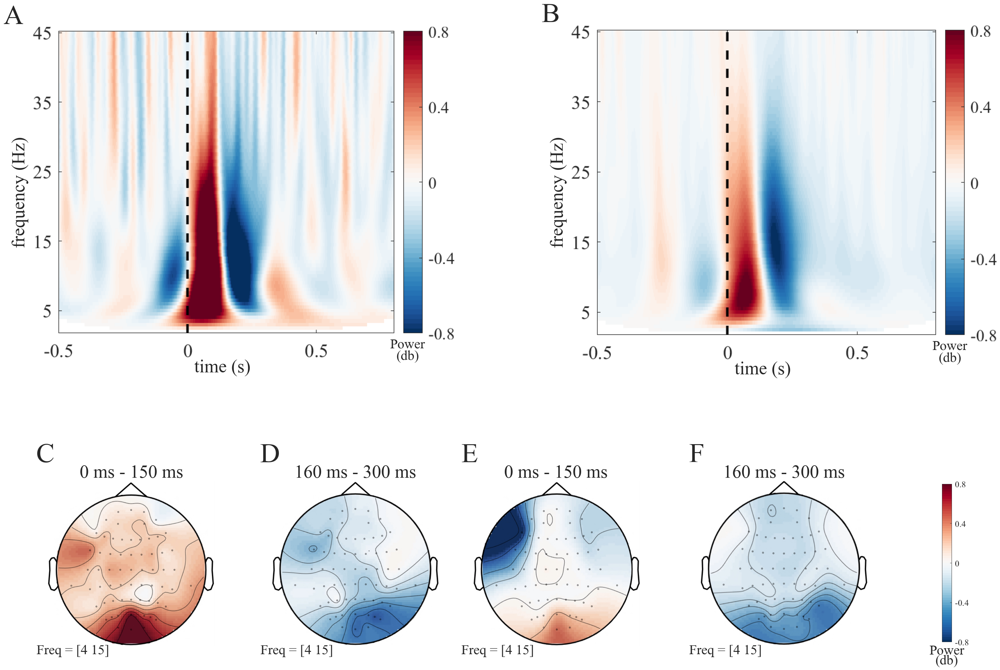

In [11]:
labelsize = 35 #text

# plot it:
plt.figure(figsize=(30, 22), constrained_layout=True)
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Times New Roman" # font name
plt.rcParams["font.family"] = fname

ax1 = plt.subplot2grid(shape=(4, 9), loc=(0, 0), rowspan=3, colspan=4)
ax2 = plt.subplot2grid(shape=(4, 9), loc=(0, 5), rowspan=3, colspan=4)
ax3 = plt.subplot2grid(shape=(4, 9), loc=(3, 0), rowspan=1, colspan=2)
ax4 = plt.subplot2grid(shape=(4, 9), loc=(3, 2), rowspan=1, colspan=2)
ax5 = plt.subplot2grid(shape=(4, 9), loc=(3, 4), rowspan=1, colspan=2)
ax6 = plt.subplot2grid(shape=(4, 9), loc=(3, 6), rowspan=1, colspan=2)
ax7 = plt.subplot2grid(shape=(4, 9), loc=(3, 8), rowspan=1, colspan=1)


####### ERSP single subject ######
img = plt.imread(f"{PATH_EEG}/NEW_ERSP_at_Oz_single_Subject.png")
ax1.imshow(img)
ax1.set_yticklabels([])
ax1.set_xticklabels([])
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 
ax1.text(0.45, -0.03, 'time (s)',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax1.transAxes, fontname=fname)
ax1.text(-0.03, 0.5, 'frequency (Hz)',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', rotation = 90, transform=ax1.transAxes, fontname=fname)
ax1.text(0.89, 0.04, 'Power',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax1.transAxes, fontname=fname)
ax1.text(0.89, 0.005, '(db)',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax1.transAxes, fontname=fname)

####### ERSP all subjects ######
img = plt.imread(f"{PATH_EEG}/NEW_ERSP_at_Oz_all_Subject.png")
ax2.imshow(img)
ax2.set_yticklabels([])
ax2.set_xticklabels([])
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['bottom'].set_visible(False)
ax2.spines['left'].set_visible(False)
ax2.set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 
ax2.text(0.45, -0.03, 'time (s)',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax2.transAxes, fontname=fname)
ax2.text(-0.03, 0.5, 'frequency (Hz)',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', rotation = 90, transform=ax2.transAxes, fontname=fname)
ax2.text(0.89, 0.04, 'Power',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax2.transAxes, fontname=fname)
ax2.text(0.89, 0.005, '(db)',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax2.transAxes, fontname=fname)

####### Topo 1 single subject ######
img = plt.imread(f"{PATH_EEG}/ERSP_topo_single_Subject_0-0.15s.jpg")
ax3.imshow(img)
ax3.set_yticklabels([])
ax3.set_xticklabels([])
ax3.spines['top'].set_visible(False)
ax3.spines['right'].set_visible(False)
ax3.spines['bottom'].set_visible(False)
ax3.spines['left'].set_visible(False)
ax3.set_title("C", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.2, pad=-30, fontname=fname) 
ax3.text(0.15, -0.03, 'Freq = [4 15]',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax3.transAxes, fontname=fname)
ax3.text(0.5, 1.05, '0 ms - 150 ms',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax3.transAxes, fontname=fname)

####### Topo 2 single subject ######
img = plt.imread(f"{PATH_EEG}/ERSP_topo_single_Subject_0.16-0.3s.jpg")
ax4.imshow(img)
ax4.set_yticklabels([])
ax4.set_xticklabels([])
ax4.spines['top'].set_visible(False)
ax4.spines['right'].set_visible(False)
ax4.spines['bottom'].set_visible(False)
ax4.spines['left'].set_visible(False)
ax4.set_title("D", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.2, pad=-30, fontname=fname) 
ax4.text(0.15, -0.03, 'Freq = [4 15]',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax4.transAxes, fontname=fname)
ax4.text(0.5, 1.05, '160 ms - 300 ms',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax4.transAxes, fontname=fname)

####### Topo 1 all subjects ######
img = plt.imread(f"{PATH_EEG}/ERSP_topo_all_Subject_0-0.15s.jpg")
ax5.imshow(img)
ax5.set_yticklabels([])
ax5.set_xticklabels([])
ax5.spines['top'].set_visible(False)
ax5.spines['right'].set_visible(False)
ax5.spines['bottom'].set_visible(False)
ax5.spines['left'].set_visible(False)
ax5.set_title("E", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.2, pad=-30, fontname=fname) 
ax5.text(0.15, -0.03, 'Freq = [4 15]',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax5.transAxes, fontname=fname)
ax5.text(0.5, 1.05, '0 ms - 150 ms',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax5.transAxes, fontname=fname)

####### Topo 2 all subjects ######
img = plt.imread(f"{PATH_EEG}/ERSP_topo_all_Subject_0.16-0.3s.jpg")
ax6.imshow(img)
ax6.set_yticklabels([])
ax6.set_xticklabels([])
ax6.spines['top'].set_visible(False)
ax6.spines['right'].set_visible(False)
ax6.spines['bottom'].set_visible(False)
ax6.spines['left'].set_visible(False)
ax6.set_title("F", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.2, pad=-30, fontname=fname) 
ax6.text(0.15, -0.03, 'Freq = [4 15]',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax6.transAxes, fontname=fname)
ax6.text(0.5, 1.05, '160 ms - 300 ms',fontsize=labelsize, horizontalalignment='center', verticalalignment='center', transform=ax6.transAxes, fontname=fname)

####### Colorbar single subject ######
img = plt.imread(f"{PATH_EEG}/NEW_Topoplot_all_Subject_colorbar.png")
ax7.imshow(img)
ax7.set_yticklabels([])
ax7.set_xticklabels([])
ax7.spines['top'].set_visible(False)
ax7.spines['right'].set_visible(False)
ax7.spines['bottom'].set_visible(False)
ax7.spines['left'].set_visible(False)
ax7.text(0.2, -0.03, 'Power',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax7.transAxes, fontname=fname)
ax7.text(0.2, -0.09, '(db)',fontsize=labelsize-10, horizontalalignment='center', verticalalignment='center', transform=ax7.transAxes, fontname=fname)

plt.show()

## Correlation ERPs

0.06927006505429745

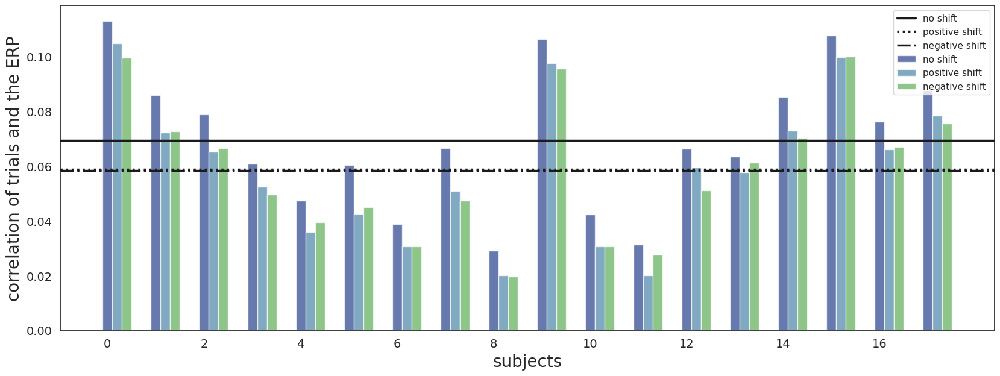

In [246]:
### Finished Version --> use this (20.03.23)
ids = recordings.index.tolist()
idd = ids[:]

all_sub = None #df to save all subjects in

#set up figure
sns.set(rc={"figure.figsize": (20, 7)})
sns.set_style("white") 
fig, ax = plt.subplots(1)

pallet = ["#27408B","#4C86A8","#5FAD56",]

no_shift = []
pos_shift = []
neg_shift = []

for i, uid in enumerate(idd):
    # load data
    #condition = "10 Second Intervals"
    condition = "Data-Driven Intervals"
    cond = "dd"
    #load the appropriate file
    mat = scipy.io.loadmat(f"{PATH_EEG}/correlation_shift_{cond}_{subj_to_inlcude[i]}.mat")

    # get the data out if the mat file
    mat = mat["corr_coef"]
    mat = pd.DataFrame(mat).transpose()


    # plot bars
    ax.bar(i,mat[mat[0] != 0][0].median(),width = 0.2, color = "#27408B", alpha=0.7, label='no shift')
    ax.bar(i+0.2,mat[mat[1] != 0][1].median(),width = 0.2, color = "#4C86A8", alpha=0.7, label='positive shift')
    ax.bar(i+0.4,mat[mat[2] != 0][2].median(),width = 0.2, color = "#5FAD56", alpha=0.7, label='negative shift')


    no_shift = no_shift + [np.median(mat[mat[0] != 0][0].tolist())]
    pos_shift = pos_shift + [np.median(mat[mat[1] != 0][1].tolist())]
    neg_shift = neg_shift + [np.median(mat[mat[2] != 0][2].tolist())]



#ax.set_ylim(-0.3, 0.4)
ax.axhline(y = np.mean(no_shift), color = 'k', linewidth=2.5, linestyle = '-', zorder = 10, label='no shift')
ax.axhline(y = np.mean(pos_shift), color = 'k', linewidth=2.5, linestyle = ':', zorder = 10, label='positive shift')
ax.axhline(y = np.mean(neg_shift), color = 'k', linewidth=2.5, linestyle = '-.', zorder = 10, label='negative shift')

display(np.mean(no_shift))

ax.set_xlabel("subjects", fontsize=20)
ax.set_ylabel("correlation of trials and the ERP", fontsize=20)
ax.yaxis.set_tick_params(labelsize=14)  # change tick size
ax.xaxis.set_tick_params(labelsize=14)
locs, labels = plt.xticks()  # Get the current locations and labels.
plt.xticks(np.arange(0, len(no_shift), step=2))  # Set label locations.

# modify the legend handles
handles, labels = ax.get_legend_handles_labels()

ax.legend(handles=handles[:6], labels=labels[:6], loc='upper right')
#plt.tight_layout()
plt.show()


In [8]:
### Statistics if using

ids = recordings.index.tolist()
idd = ids[:]

all_sub = None #df to save all subjects in


no_shift = []
pos_shift = []
neg_shift = []

for i, uid in enumerate(idd):
    # load data
    #condition = "10 Second Intervals"
    condition = "Data-Driven Intervals"
    cond = "dd"
    #load the appropriate file
    mat = scipy.io.loadmat(f"{PATH_EEG}/correlation_shift_{cond}_{subj_to_inlcude[i]}.mat")

    # get the data out if the mat file
    mat = mat["corr_coef"]
    mat = pd.DataFrame(mat).transpose()

    no_shift = no_shift + [np.median(mat[mat[0] != 0][0].tolist())]
    pos_shift = pos_shift + [np.median(mat[mat[1] != 0][1].tolist())]
    neg_shift = neg_shift + [np.median(mat[mat[2] != 0][2].tolist())]





corr = {}
corr['no_shift'] = no_shift
corr['pos_shift'] = pos_shift
corr['neg_shift'] = neg_shift
corr = pd.DataFrame(corr)
#display(corr)

corr_long = {}
corr_long['subject'] = [int(li) for li in np.linspace(0,17,18)] * 3 # subject nr
corr_long['shift'] = ['no_shift'] * len(no_shift) + ['pos_shift'] * len(pos_shift) + ['neg_shift'] * len(neg_shift)
corr_long['corr_coef'] = no_shift + pos_shift + neg_shift
corr_long = pd.DataFrame(corr_long)
#display(corr_long)


### Repeated measure ANOVA
print("Repeated measure ANOVA")
print(AnovaRM(data=corr_long, depvar='corr_coef',
              subject='subject', within=['shift']).fit())

print()
### Check Assumtions:
# 1. Sphericity using the Mauchly test
mauchly_result = pg.sphericity(corr_long, dv='corr_coef', subject='subject', 
                               within='shift')
print(mauchly_result)
print()


### Compute pairwise comparisons with Fisher's LSD test
stat,p1 = scipy.stats.ttest_rel(no_shift, pos_shift)
stat,p2 = scipy.stats.ttest_rel(no_shift, neg_shift)
stat,p3 = scipy.stats.ttest_rel(pos_shift, neg_shift)

p_values = [p1,p2,p3]

print([round(pv,3) for pv in p_values])
print()
print('corrected p-values')
corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]
print(corrected_p_values)
corrected_p_values = [round(pv, 3) for pv in corrected_p_values]
# Print the corrected p-value4
print(corrected_p_values)


Repeated measure ANOVA
               Anova
      F Value  Num DF  Den DF Pr > F
------------------------------------
shift 103.9421 2.0000 34.0000 0.0000


SpherResults(spher=True, W=inf, chi2=-inf, dof=2, pval=1.0)

[0.0, 0.0, 0.612]

corrected p-values
[2.25286069e-10 8.74350835e-09 1.00000000e+00]
[0.0, 0.0, 1.0]


/net/store/nbp/projects/wd_ride_village/venvs/wd_village/lib/python3.10/site-packages/pingouin/distribution.py:1006: RuntimeWarning: divide by zero encountered in scalar divide
  W = np.product(eig) / (eig.sum() / d) ** d


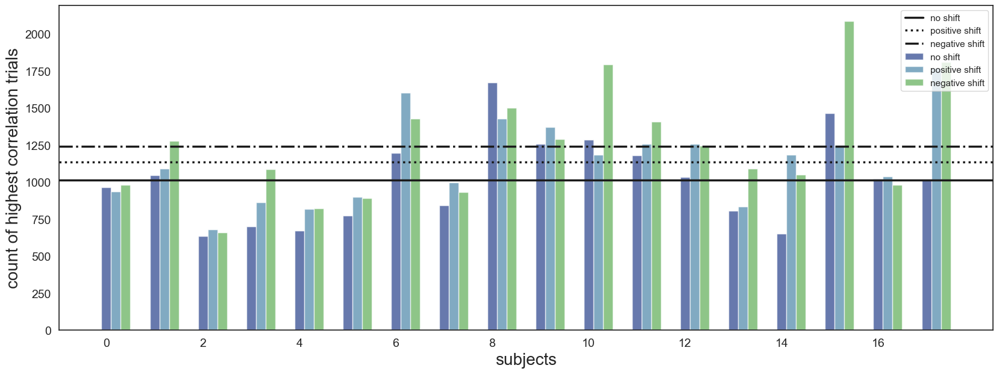

In [9]:
### Finished Version --> use this (20.03.23)
ids = recordings.index.tolist()
idd = ids[:]

all_sub = None #df to save all subjects in

#set up figure
sns.set(rc={"figure.figsize": (20, 7)})
sns.set_style(
    "white"
)  # styledict, or one of {darkgrid, whitegrid, dark, white, ticks}
#plt.figure(figsize=(20, 20))


fig, ax = plt.subplots(1)

pallet = ["#27408B","#4C86A8","#5FAD56",]

no_shift = []
pos_shift = []
neg_shift = []

for i, uid in enumerate(idd):
    # load data
    #condition = "10 Second Intervals"
    condition = "Data-Driven Intervals"
    cond = "dd"
    #load the appropriate file
    mat = scipy.io.loadmat(f"{PATH_EEG}/correlation_shift_{cond}_{subj_to_inlcude[i]}.mat")

    # get the data out if the mat file
    mat = mat["corr_count"]
    mat = pd.DataFrame(mat).transpose()

    # plot bars
    ax.bar(i,len(mat[mat[0]==1]),width = 0.2, color = "#27408B", alpha=0.7, label='no shift')
    ax.bar(i+0.2,len(mat[mat[0]==2]),width = 0.2, color = "#4C86A8", alpha=0.7, label='positive shift')
    ax.bar(i+0.4,len(mat[mat[0]==3]),width = 0.2, color = "#5FAD56", alpha=0.7, label='negative shift')
    
    no_shift = no_shift + [len(mat[mat[0]==1])]
    pos_shift = pos_shift + [len(mat[mat[0]==2])]
    neg_shift = neg_shift + [len(mat[mat[0]==3])]

ax.axhline(y = np.mean(no_shift), color = 'k', linewidth=2.5, linestyle = '-', zorder = 10, label='no shift')
ax.axhline(y = np.mean(pos_shift), color = 'k', linewidth=2.5, linestyle = ':', zorder = 10, label='positive shift')
ax.axhline(y = np.mean(neg_shift), color = 'k', linewidth=2.5, linestyle = '-.', zorder = 10, label='negative shift')

ax.set_xlabel("subjects", fontsize=20)
ax.set_ylabel("count of highest correlation trials", fontsize=20)
ax.yaxis.set_tick_params(labelsize=14)  # change tick size
ax.xaxis.set_tick_params(labelsize=14)
locs, labels = plt.xticks()  # Get the current locations and labels.
plt.xticks(np.arange(0, len(no_shift), step=2))  # Set label locations.

# modify the legend handles
handles, labels = ax.get_legend_handles_labels()

ax.legend(handles=handles[:6], labels=labels[:6], loc='upper right')
#plt.tight_layout()
plt.show()
    
  

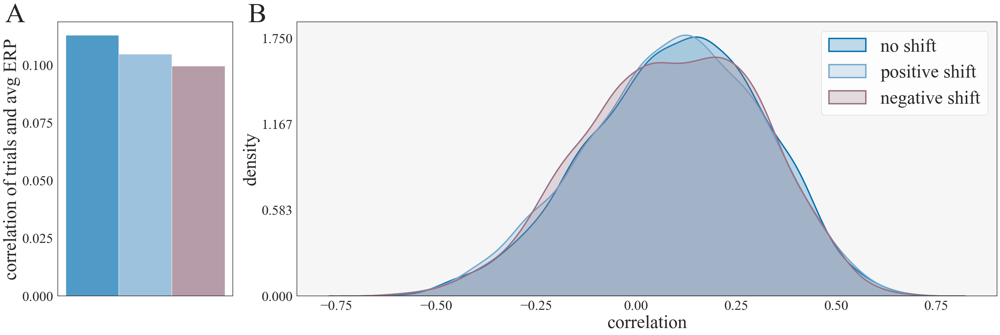

In [74]:
#### Invesitage difference counts vs mean for one subject
labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Times New Roman" # font name


sns.set(rc={"figure.figsize": (30, 10)})
sns.set_style("white")  
fig, (ax1,ax2) = plt.subplots(1,2, gridspec_kw={'width_ratios': [1, 4]}, constrained_layout=True)
plt.rcParams["font.family"] = fname

#pallet = ["#27408B","#4C86A8","#5FAD56",]
pallet = [gaze_color_1,sacc_color_1,colliders_color]

no_shift = []
pos_shift = []
neg_shift = []

i = 0

# load data
cond = "dd"
#load the appropriate file
mat_all = scipy.io.loadmat(f"{PATH_EEG}/correlation_shift_{cond}_{subj_to_inlcude[i]}.mat")

####### Median Correlation #######
plt.subplot(1, 2, 1)
mat = mat_all["corr_coef"]
mat = pd.DataFrame(mat).transpose()
# plot bars
ax = plt.bar(i,mat[mat[0] != 0][0].median(),width = 0.2, color = pallet[0], alpha=0.7, label='no shift')
ax = plt.bar(i+0.2,mat[mat[1] != 0][1].median(),width = 0.2, color = pallet[1], alpha=0.7, label='positive shift')
ax = plt.bar(i+0.4,mat[mat[2] != 0][2].median(),width = 0.2, color = pallet[2], alpha=0.7, label='negative shift')
#plt.xlabel("subjects", fontsize=20)
plt.ylabel("correlation of trials and avg ERP", fontsize=labelsize, fontname=fname)
for label in ax1.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax1.get_yticklabels():
    label.set_fontproperties(fname)
plt.xticks(fontsize=ticksize)
plt.yticks(fontsize=ticksize)
locs, labels = plt.xticks()  # Get the current locations and labels.
plt.xticks(np.arange(0, len(no_shift), step=2))  # Set label locations.
ax1.set_yticks(np.linspace(0.0, 0.1, num=5))
ax1.set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.3, y=1.05, pad=-30, fontname=fname)  


####### Correlation Distribution #2 #######
plt.subplot(1, 2, 2)
corr = mat_all["corr_coef"]
corr = pd.DataFrame(corr).transpose()
corr = corr.rename(columns={0: "no_shift", 1: "pos_shift", 2: "neg_shift"})
corr = corr.round(3)

#ax = sns.kdeplot(corr, color=pallet)
ax = sns.kdeplot(corr["no_shift"], color=pallet[0], fill=True, linewidths=3, label="no shift")
ax = sns.kdeplot(corr["pos_shift"], color=pallet[1], fill=True, linewidths=3, label="positive shift")
ax = sns.kdeplot(corr["neg_shift"], color=pallet[2], fill=True, linewidths=3,label="negative shift")
for label in ax2.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax2.get_yticklabels():
    label.set_fontproperties(fname)
ax.set_xticks(np.linspace(-0.75, 0.75, num=7))
ax.set_yticks(np.linspace(0.0, 1.75, num=4))
ax.set_facecolor(dd_thres_color)
ax.patch.set_alpha(0.05)
plt.xticks(fontsize=ticksize)
plt.yticks(fontsize=ticksize)
ax.legend(loc="upper right", fontsize=legendsize)
ax.set_xlabel("correlation", fontsize=labelsize, fontname=fname)
ax.set_ylabel("density", fontsize=labelsize, fontname=fname)

ax.set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 

plt.show()


## Correlation ERSPs

0.5961015589361757

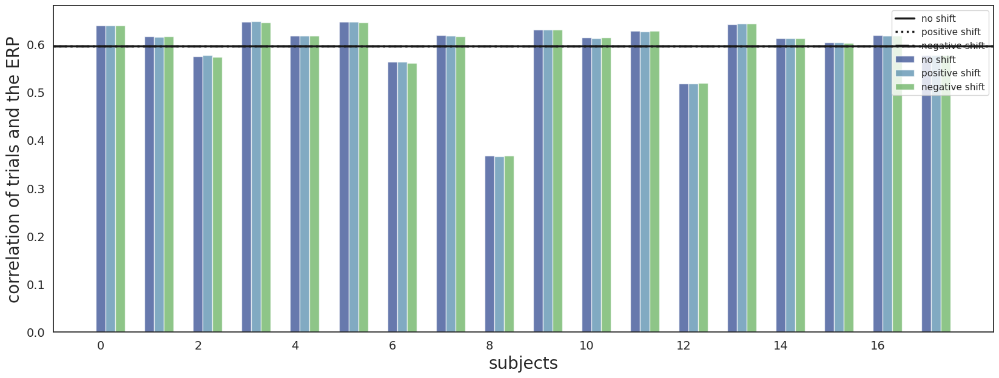

In [6]:
### Finished Version --> use this (20.03.23)
ids = recordings.index.tolist()
idd = ids[:]

#set up figure
sns.set(rc={"figure.figsize": (20, 7)})
sns.set_style("white") 
fig, ax = plt.subplots(1)

pallet = [gaze_color_1,gaze_color_2,colliders_color]

no_shift = []
pos_shift = []
neg_shift = []

for i, uid in enumerate(idd):
    # load data
    #condition = "10 Second Intervals"
    condition = "Data-Driven Intervals"
    cond = "dd"
    #load the appropriate file
    mat = scipy.io.loadmat(f"{PATH_EEG}/correlation_shift_ERSP_{cond}_{subj_to_inlcude[i]}.mat")

    # get the data out if the mat file
    mat = mat["corr_coef"]
    mat = pd.DataFrame(mat).transpose()
    # plot bars
    ax.bar(i,mat[mat[0] != 0][0].median(),width = 0.2, color = "#27408B", alpha=0.7, label='no shift')
    ax.bar(i+0.2,mat[mat[1] != 0][1].median(),width = 0.2, color = "#4C86A8", alpha=0.7, label='positive shift')
    ax.bar(i+0.4,mat[mat[2] != 0][2].median(),width = 0.2, color = "#5FAD56", alpha=0.7, label='negative shift')

    no_shift = no_shift + [np.median(mat[mat[0] != 0][0].tolist())]
    pos_shift = pos_shift + [np.median(mat[mat[1] != 0][1].tolist())]
    neg_shift = neg_shift + [np.median(mat[mat[2] != 0][2].tolist())]

shift_lists= pd.DataFrame(
    {'no_shift': no_shift,
     'pos_shift': pos_shift,
     'neg_shift': neg_shift
    })
shift_lists = pd.DataFrame(shift_lists)

#ax.set_ylim(-0.3, 0.4)
ax.axhline(y = np.mean(no_shift), color = 'k', linewidth=2.5, linestyle = '-', zorder = 10, label='no shift')
ax.axhline(y = np.mean(pos_shift), color = 'k', linewidth=2.5, linestyle = ':', zorder = 10, label='positive shift')
ax.axhline(y = np.mean(neg_shift), color = 'k', linewidth=2.5, linestyle = '-.', zorder = 10, label='negative shift')
display(np.mean(no_shift))

ax.set_xlabel("subjects", fontsize=20)
ax.set_ylabel("correlation of trials and the ERP", fontsize=20)
ax.yaxis.set_tick_params(labelsize=14)  # change tick size
ax.xaxis.set_tick_params(labelsize=14)
locs, labels = plt.xticks()  # Get the current locations and labels.
plt.xticks(np.arange(0, len(no_shift), step=2))  # Set label locations.

# modify the legend handles
handles, labels = ax.get_legend_handles_labels()

ax.legend(handles=handles[:6], labels=labels[:6], loc='upper right')
#plt.tight_layout()
plt.show()


In [25]:
### Statistics if using

ids = recordings.index.tolist()
idd = ids[:]

all_sub = None #df to save all subjects in


no_shift = []
pos_shift = []
neg_shift = []

for i, uid in enumerate(idd):
    # load data
    #condition = "10 Second Intervals"
    condition = "Data-Driven Intervals"
    cond = "dd"
    #load the appropriate file
    mat = scipy.io.loadmat(f"{PATH_EEG}/correlation_shift_ERSP_{cond}_{subj_to_inlcude[i]}.mat")

    # get the data out if the mat file
    mat = mat["corr_coef"]
    mat = pd.DataFrame(mat).transpose()

    no_shift = no_shift + [np.median(mat[mat[0] != 0][0].tolist())]
    pos_shift = pos_shift + [np.median(mat[mat[1] != 0][1].tolist())]
    neg_shift = neg_shift + [np.median(mat[mat[2] != 0][2].tolist())]





corr = {}
corr['no_shift'] = no_shift
corr['pos_shift'] = pos_shift
corr['neg_shift'] = neg_shift
corr = pd.DataFrame(corr)
display(corr)

corr_long = {}
corr_long['subject'] = [int(li) for li in np.linspace(0,17,18)] * 3 # subject nr
corr_long['shift'] = ['no_shift'] * len(no_shift) + ['pos_shift'] * len(pos_shift) + ['neg_shift'] * len(neg_shift)
corr_long['corr_coef'] = no_shift + pos_shift + neg_shift
corr_long = pd.DataFrame(corr_long)
#display(corr_long)


### Repeated measure ANOVA
print("Repeated measure ANOVA")
print(AnovaRM(data=corr_long, depvar='corr_coef',
              subject='subject', within=['shift']).fit())

print()
### Check Assumtions:
# 1. Sphericity using the Mauchly test
mauchly_result = pg.sphericity(corr_long, dv='corr_coef', subject='subject', 
                               within='shift')
print(mauchly_result)
print()


### Compute pairwise comparisons with Fisher's LSD test
stat,p1 = scipy.stats.ttest_rel(no_shift, pos_shift)
stat,p2 = scipy.stats.ttest_rel(no_shift, neg_shift)
stat,p3 = scipy.stats.ttest_rel(pos_shift, neg_shift)

p_values = [p1,p2,p3]

print([round(pv,3) for pv in p_values])
print()
print('corrected p-values')
corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]
print(corrected_p_values)
corrected_p_values = [round(pv, 3) for pv in corrected_p_values]
# Print the corrected p-value4
print(corrected_p_values)


,no_shift,pos_shift,neg_shift
0,0.638914,0.638110,0.638747
1,0.616234,0.614688,0.615505
2,0.574158,0.577091,0.573170
3,0.646580,0.647585,0.645532
4,0.617189,0.617376,0.617376
5,0.646824,0.646677,0.645317
6,0.563055,0.563118,0.560633
7,0.618036,0.617242,0.616547
8,0.367517,0.366390,0.367676
9,0.630385,0.630191,0.629776


Repeated measure ANOVA
               Anova
      F Value Num DF  Den DF Pr > F
-----------------------------------
shift  2.7598 2.0000 34.0000 0.0775


SpherResults(spher=True, W=inf, chi2=-inf, dof=2, pval=1.0)

[0.597, 0.011, 0.179]

corrected p-values
[1.         0.0327357  0.53673208]
[1.0, 0.033, 0.537]


/net/store/nbp/projects/wd_ride_village/venvs/wd_village/lib/python3.10/site-packages/pingouin/distribution.py:1006: RuntimeWarning: divide by zero encountered in scalar divide
  W = np.product(eig) / (eig.sum() / d) ** d


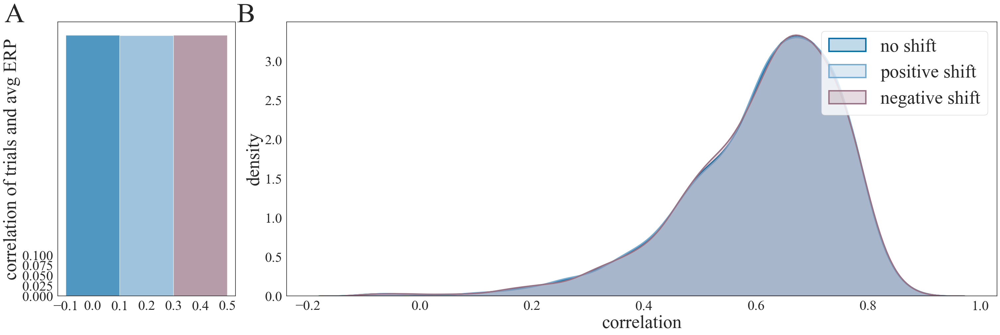

In [7]:
#### Invesitage difference counts vs mean for one subject
labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Times New Roman" # font name


sns.set(rc={"figure.figsize": (30, 10)})
sns.set_style("white")  
fig, (ax1,ax2) = plt.subplots(1,2, gridspec_kw={'width_ratios': [1, 4]}, constrained_layout=True)
plt.rcParams["font.family"] = fname

#pallet = ["#27408B","#4C86A8","#5FAD56",]
pallet = [gaze_color_1,gaze_color_2,colliders_color]

no_shift = []
pos_shift = []
neg_shift = []

i = 0

# load data
cond = "dd"
#load the appropriate file
mat_all = scipy.io.loadmat(f"{PATH_EEG}/correlation_shift_ERSP_{cond}_{subj_to_inlcude[i]}.mat")

####### Median Correlation #######
plt.subplot(1, 2, 1)
mat = mat_all["corr_coef"]
mat = pd.DataFrame(mat).transpose()
# plot bars
ax = plt.bar(i,mat[mat[0] != 0][0].median(),width = 0.2, color = pallet[0], alpha=0.7, label='no shift')
ax = plt.bar(i+0.2,mat[mat[1] != 0][1].median(),width = 0.2, color = pallet[1], alpha=0.7, label='positive shift')
ax = plt.bar(i+0.4,mat[mat[2] != 0][2].median(),width = 0.2, color = pallet[2], alpha=0.7, label='negative shift')
#plt.xlabel("subjects", fontsize=20)
plt.ylabel("correlation of trials and avg ERP", fontsize=labelsize, fontname=fname)
for label in ax1.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax1.get_yticklabels():
    label.set_fontproperties(fname)
plt.xticks(fontsize=ticksize)
plt.yticks(fontsize=ticksize)
locs, labels = plt.xticks()  # Get the current locations and labels.
#plt.xticks(np.arange(0, len(no_shift), step=2))  # Set label locations.
ax1.set_yticks(np.linspace(0.0, 0.1, num=5))
ax1.set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.3, y=1.05, pad=-30, fontname=fname)  


####### Correlation Distribution #2 #######
plt.subplot(1, 2, 2)
corr = mat_all["corr_coef"]
corr = pd.DataFrame(corr).transpose()
corr = corr.rename(columns={0: "no_shift", 1: "pos_shift", 2: "neg_shift"})
corr = corr.round(3)

#ax = sns.kdeplot(corr, color=pallet)
ax = sns.kdeplot(corr["no_shift"], color=pallet[0], fill=True, linewidths=3, label="no shift")
ax = sns.kdeplot(corr["pos_shift"], color=pallet[1], fill=True, linewidths=3, label="positive shift")
ax = sns.kdeplot(corr["neg_shift"], color=pallet[2], fill=True, linewidths=3,label="negative shift")
for label in ax2.get_xticklabels(): # change tick font
    label.set_fontproperties(fname)
for label in ax2.get_yticklabels():
    label.set_fontproperties(fname)
#ax.set_xticks(np.linspace(-0.75, 0.75, num=7))
#ax.set_yticks(np.linspace(0.0, 1.75, num=4))
#ax.set_facecolor(dd_thres_color)
#ax.patch.set_alpha(0.05)
plt.xticks(fontsize=ticksize)
plt.yticks(fontsize=ticksize)

ax.legend(loc="upper right", fontsize=legendsize)
ax.set_xlabel("correlation", fontsize=labelsize, fontname=fname)
ax.set_ylabel("density", fontsize=labelsize, fontname=fname)
ax.set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.07, y=1.05, pad=-30, fontname=fname) 

plt.show()


## Plot for both correlations

0.11295124888420105

0.61623405650947

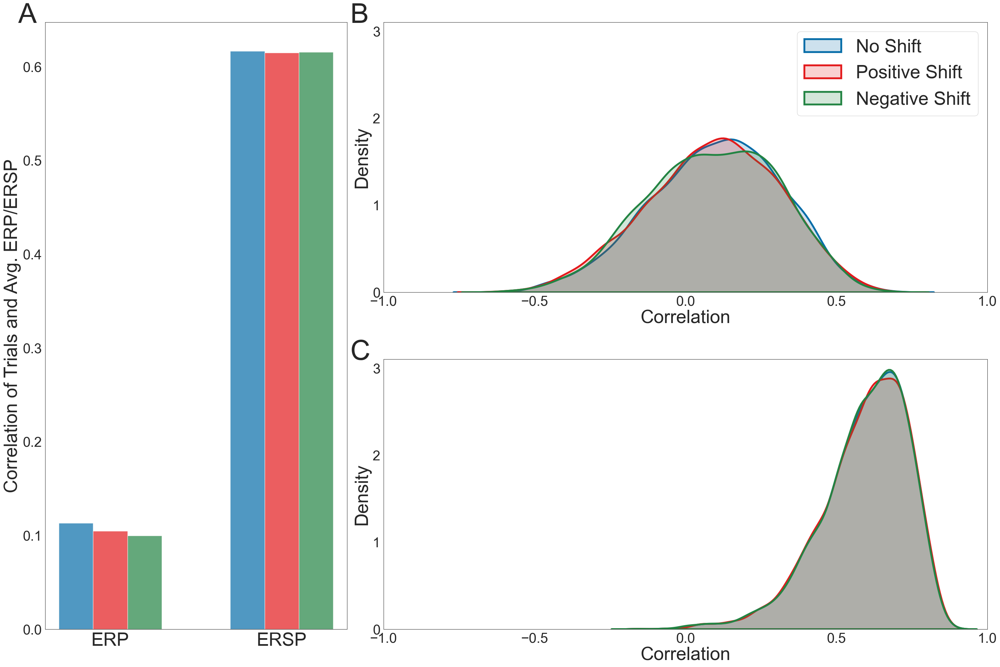

In [5]:
######## APA Style!!! ########

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Arial" # font name
pallet = [gaze_color_1,sacc_color_1,vel_eye_color]

plt.figure(figsize=(30, 20), constrained_layout=True)
sns.set_style("white") 
ax1 = plt.subplot2grid(shape=(2, 3), loc=(0, 0), rowspan=2, colspan=1)
ax2 = plt.subplot2grid(shape=(2, 3), loc=(0, 1), rowspan=1, colspan=2)
ax3 = plt.subplot2grid(shape=(2, 3), loc=(1, 1), rowspan=1, colspan=2)

no_shift = []
pos_shift = []
neg_shift = []

# load data
cond = "dd"

for i in range(2):
    if i == 0:
        mat = scipy.io.loadmat(f"{PATH_EEG}/correlation_shift_{cond}_{subj_to_inlcude[i]}.mat")
    else:
        mat = scipy.io.loadmat(f"{PATH_EEG}/correlation_shift_ERSP_{cond}_{subj_to_inlcude[i]}.mat")

    # get the data out if the mat file
    mat = mat["corr_coef"]
    mat = pd.DataFrame(mat).transpose()
    ax1.bar(i,mat[mat[0] != 0][0].median(),width = 0.2, color = pallet[0], alpha=0.7, label='No Shift')
    ax1.bar(i+0.2,mat[mat[1] != 0][1].median(),width = 0.2, color = pallet[1], alpha=0.7, label='Positive Shift')
    ax1.bar(i+0.4,mat[mat[2] != 0][2].median(),width = 0.2, color = pallet[2], alpha=0.7, label='Negative Shift')
    ax1.set_ylabel("Correlation of Trials and Avg. ERP/ERSP", fontsize=labelsize, fontname=fname)
    for label in ax1.get_xticklabels(): # change tick font
        label.set_fontproperties(fname)
    for label in ax1.get_yticklabels():
        label.set_fontproperties(fname)
    ax1.set_xticks(np.linspace(0.2, 1.2, num=2),['ERP','ERSP'],fontsize=labelsize)
    ax1.set_yticks(np.linspace(0, 0.6, num=7))
    ax1.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
    
    display(mat[mat[0] != 0][0].median())
    
    mat = mat.rename(columns={0: "no_shift", 1: "pos_shift", 2: "neg_shift"})
    #mat = mat.round(3)
    if i == 0: 
        axis = ax2
    else:
        axis = ax3
        
    ax = sns.kdeplot(mat["no_shift"], color=pallet[0], ax = axis, lw=4, fill=True, alpha = 0.2, label="No Shift")
    ax = sns.kdeplot(mat["pos_shift"], color=pallet[1], ax = axis, lw=4, fill=True, alpha = 0.2, label="Positive Shift")
    ax = sns.kdeplot(mat["neg_shift"], color=pallet[2], ax = axis, lw=4, fill=True, alpha = 0.2, label="Negative Shift")
    #ax = sns.kdeplot(mat["no_shift"], color=pallet[0], ax = axis, multiple="stack", alpha = 0.5, label="no shift")
    #ax = sns.kdeplot(mat["pos_shift"], color=pallet[1], ax = axis, multiple="stack", alpha = 0.5, label="positive shift")
    #ax = sns.kdeplot(mat["neg_shift"], color=pallet[2], ax = axis, multiple="stack", alpha = 0.5, label="negative shift")
    for label in axis.get_xticklabels(): # change tick font
        label.set_fontproperties(fname)
    for label in axis.get_yticklabels():
        label.set_fontproperties(fname)
    ax.set_xlim(-1, 1)
    ax.set_ylim(0, 3.1)
    ax.set_xlabel("Correlation", fontsize=labelsize, fontname=fname)
    ax.set_ylabel("Density", fontsize=labelsize, fontname=fname)
    
    ax.set_xticks(np.linspace(-1, 1, num=5))
    ax.set_yticks(np.linspace(0.0, 3, num=4))
    ax.xaxis.set_tick_params(labelsize=ticksize)  # change tick size
    ax.yaxis.set_tick_params(labelsize=ticksize)  # change tick size

    
    
    ax2.legend(loc="upper right", fontsize=legendsize)

    ax1.set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.09, y=1.02199, pad=-30, fontname=fname) 
    ax2.set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.055, y=1.05, pad=-30, fontname=fname) 
    ax3.set_title("C", fontsize=numbersize, fontweight="bold",loc="left", x=-0.055, y=1.05, pad=-30, fontname=fname) 


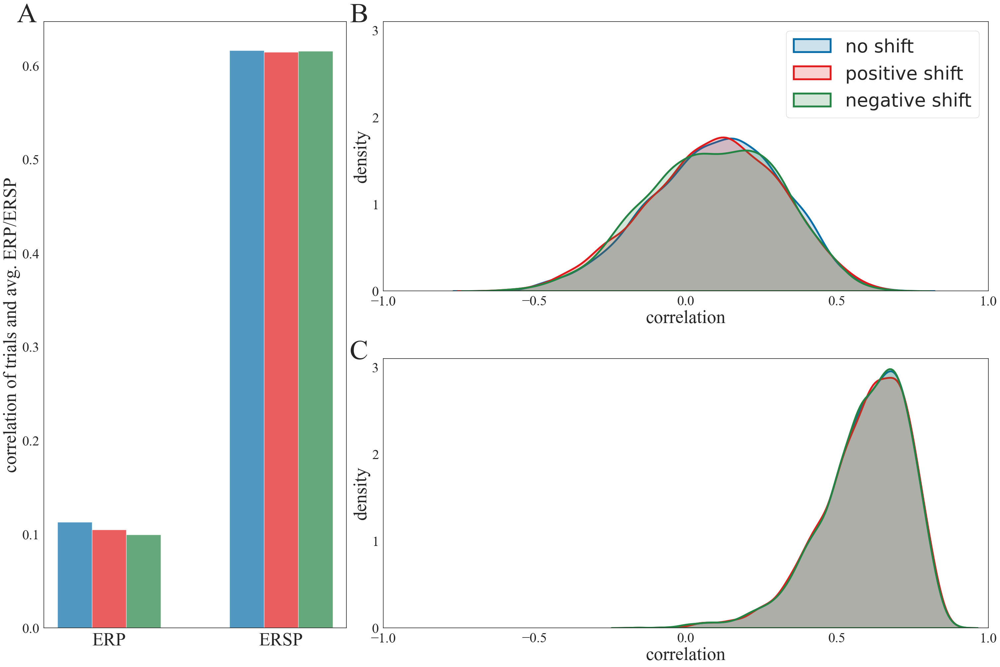

In [21]:

labelsize = 40 #text
legendsize = 40 #ledgend
ticksize = 30 #ticks
numbersize = 60 #A, B etc.
fname = "Times New Roman" # font name
pallet = [gaze_color_1,sacc_color_1,vel_eye_color]

plt.figure(figsize=(30, 20), constrained_layout=True)
sns.set_style("white") 
ax1 = plt.subplot2grid(shape=(2, 3), loc=(0, 0), rowspan=2, colspan=1)
ax2 = plt.subplot2grid(shape=(2, 3), loc=(0, 1), rowspan=1, colspan=2)
ax3 = plt.subplot2grid(shape=(2, 3), loc=(1, 1), rowspan=1, colspan=2)

no_shift = []
pos_shift = []
neg_shift = []

# load data
cond = "dd"

for i in range(2):
    if i == 0:
        mat = scipy.io.loadmat(f"{PATH_EEG}/correlation_shift_{cond}_{subj_to_inlcude[i]}.mat")
    else:
        mat = scipy.io.loadmat(f"{PATH_EEG}/correlation_shift_ERSP_{cond}_{subj_to_inlcude[i]}.mat")

    # get the data out if the mat file
    mat = mat["corr_coef"]
    mat = pd.DataFrame(mat).transpose()
    ax1.bar(i,mat[mat[0] != 0][0].median(),width = 0.2, color = pallet[0], alpha=0.7, label='no shift')
    ax1.bar(i+0.2,mat[mat[1] != 0][1].median(),width = 0.2, color = pallet[1], alpha=0.7, label='positive shift')
    ax1.bar(i+0.4,mat[mat[2] != 0][2].median(),width = 0.2, color = pallet[2], alpha=0.7, label='negative shift')
    ax1.set_ylabel("correlation of trials and avg. ERP/ERSP", fontsize=labelsize, fontname=fname)
    for label in ax1.get_xticklabels(): # change tick font
        label.set_fontproperties(fname)
    for label in ax1.get_yticklabels():
        label.set_fontproperties(fname)
    ax1.set_xticks(np.linspace(0.2, 1.2, num=2),['ERP','ERSP'],fontsize=labelsize)
    ax1.set_yticks(np.linspace(0, 0.6, num=7))
    ax1.yaxis.set_tick_params(labelsize=ticksize)  # change tick size
    
    
    
    mat = mat.rename(columns={0: "no_shift", 1: "pos_shift", 2: "neg_shift"})
    #mat = mat.round(3)
    if i == 0: 
        axis = ax2
    else:
        axis = ax3
        
    ax = sns.kdeplot(mat["no_shift"], color=pallet[0], ax = axis, lw=4, fill=True, alpha = 0.2, label="no shift")
    ax = sns.kdeplot(mat["pos_shift"], color=pallet[1], ax = axis, lw=4, fill=True, alpha = 0.2, label="positive shift")
    ax = sns.kdeplot(mat["neg_shift"], color=pallet[2], ax = axis, lw=4, fill=True, alpha = 0.2, label="negative shift")
    #ax = sns.kdeplot(mat["no_shift"], color=pallet[0], ax = axis, multiple="stack", alpha = 0.5, label="no shift")
    #ax = sns.kdeplot(mat["pos_shift"], color=pallet[1], ax = axis, multiple="stack", alpha = 0.5, label="positive shift")
    #ax = sns.kdeplot(mat["neg_shift"], color=pallet[2], ax = axis, multiple="stack", alpha = 0.5, label="negative shift")
    for label in axis.get_xticklabels(): # change tick font
        label.set_fontproperties(fname)
    for label in axis.get_yticklabels():
        label.set_fontproperties(fname)
    ax.set_xlim(-1, 1)
    ax.set_ylim(0, 3.1)
    ax.set_xlabel("correlation", fontsize=labelsize, fontname=fname)
    ax.set_ylabel("density", fontsize=labelsize, fontname=fname)
    
    ax.set_xticks(np.linspace(-1, 1, num=5))
    ax.set_yticks(np.linspace(0.0, 3, num=4))
    ax.xaxis.set_tick_params(labelsize=ticksize)  # change tick size
    ax.yaxis.set_tick_params(labelsize=ticksize)  # change tick size

    
    
    ax2.legend(loc="upper right", fontsize=legendsize)

    ax1.set_title("A", fontsize=numbersize, fontweight="bold",loc="left", x=-0.09, y=1.02199, pad=-30, fontname=fname) 
    ax2.set_title("B", fontsize=numbersize, fontweight="bold",loc="left", x=-0.055, y=1.05, pad=-30, fontname=fname) 
    ax3.set_title("C", fontsize=numbersize, fontweight="bold",loc="left", x=-0.055, y=1.05, pad=-30, fontname=fname) 


In [ ]:
#### Invesitage difference counts vs mean for one subject



sns.set(rc={"figure.figsize": (30, 10)})
sns.set_style("white")  
fig, (ax1,ax2) = plt.subplots(1,2, gridspec_kw={'width_ratios': [1, 4]}, constrained_layout=True)
plt.rcParams["font.family"] = fname

#pallet = ["#27408B","#4C86A8","#5FAD56",]
pallet = [gaze_color_1,gaze_color_2,colliders_color]

no_shift = []
pos_shift = []
neg_shift = []

# load data
cond = "dd"

for i in range(2):
    if i == 0:
        mat_all = scipy.io.loadmat(f"{PATH_EEG}/correlation_shift_{cond}_{subj_to_inlcude[i]}.mat")

    ax.bar(i,mat[mat[0] != 0][0].median(),width = 0.2, color = "#27408B", alpha=0.7, label='no shift')
    ax.bar(i+0.2,mat[mat[1] != 0][1].median(),width = 0.2, color = "#4C86A8", alpha=0.7, label='positive shift')
    ax.bar(i+0.4,mat[mat[2] != 0][2].median(),width = 0.2, color = "#5FAD56", alpha=0.7, label='negative shift')

